https://tensorboard.dev/experiment/RIaLouXNTGiJHqU6Y29b6Q/

# Introduction

<a id='top'></a>
[to training](#training)  
[to hyperparameter optimization](#hopt) 

## Overview

In this work object detection is performed on an image dataset of various crops and weeds to evaluate if the YOLOv7 architecture is applicable as a foundation for precision agriculture.



**Table of contents**

For a better overview the some contents were omitted

- [Introduction](#Introduction)
- [Aquiring the necessary ressources](#Aquiring-the-necessary-ressources)
  - [Python environment <a id="res:python">](#Python-environment-<a-id="res:python">)
  - [Downloading the dataset](#Downloading-the-dataset)
  - [Download YOLOv7](#Download-YOLOv7)
  - [Environment variables - GPU selection](#Environment-variables---GPU-selection)
  - [Imports A (installed packages)](#Imports-A-(installed-packages))
  - [Define global settings <a id='settings'></a>](#Define-global-settings-<a-id='settings'></a>)
    - [Setup path variables](#Setup-path-variables)
  - [Imports B (local packages)](#Imports-B-(local-packages))
- [Dataset exploration <a id="dataset-exploration"><a/>](#Dataset-exploration-<a-id="dataset-exploration"><a/>)
  - [Dataset cleanup](#Dataset-cleanup)
- [`Dataset` and `DataModule` classes <a id="datamodule">](#Fetching-data-from-the-drive:-`Dataset`-and-`DataModule`-classes-<a-id="datamodule">)
- [Augmentation <a id="augmentation"></a>](#Augmentation-<a-id="augmentation"></a>)
  - [Normalization](#Normalization)
  - [Augmentations](#Augmentations)
- [Model Class<a id='Model Class'></a>](#Model-Class<a-id='Model-Class'></a>)
  - [Model and Training settings<a id='settings'></a>](#Model-and-Training-settings<a-id='settings'></a>)
- [Excursion: YOLO's Single shot detection and evaluation of anchor settings](#Excursion:-YOLO's-Single-shot-detection-and-evaluation-of-anchor-settings)
    - [Best possible recall of anchors](#Best-possible-recall-of-anchors)
  - [Adjust anchors](#Adjust-anchors)
- [Baseline](#Baseline)
- [Training](#Training)
    - [Overfit on batches](#Overfit-on-batches)
    - [Single Training <a id='training'></a>](#Single-Training-<a-id='training'></a>)
    - [Load the Model (Checkpoint)](#Load-the-Model-(Checkpoint))
  - [First Evaluation](#First-Evaluation)
  - [Intermediate results <a id="intermediate-results"></a>](#Intermediate-results-<a-id="intermediate-results"></a>)
- [Hyperparameter Tuning <a id='hopt'></a>](#Hyperparameter-Tuning-<a-id='hopt'></a>)
    - [Hyperparametertuning Evaluation](#Hyperparametertuning-Evaluation)
      - [Options for visualization](#Options-for-visualization)
      - [Visualizations](#Visualizations)
  - [Train the best model - Validation <a id="hopt:validation">](#Train-the-best-model---Validation-<a-id="hopt:validation">)
- [Going Deeper - High resolution, larger architectures](#Going-Deeper---High-resolution,-larger-architectures)
- [Discussion, summary, conclusion <a id="end:discussion"></a>](#Discussion,-summary,-conclusion-<a-id="end:discussion"></a>)

## Motivation

One could consider agriculture as the backbone of every society. Nowadays nearly half of the habitable land is used for agriculture \[[ourworldindata.org, 2019](https://ourworldindata.org/land-use)\].  

<p style="text-align: center;"><img src="./research/Global-land-use-graphic.png" width="540"><br>
<a href="https://ourworldindata.org/uploads/2020/01/Global-land-use-graphic.png">[ourworldindata.org/land-use, 2019]</a></p>


For agriculture to be efficient fertilizers and different kinds of are used. 
While the amount of used pesticides is mostily constant over the past 10 years, it is on its all time high.
Not only do these substances cost money they also have negative impact on the environment.

<p style="text-align: center;"><img src="./research/pesticide-breakdown-by-type.svg" width="540"><br>
<a href="https://ourworldindata.org/pesticides">[ourworldindata.org/pesticides, 2020]</a></p>

Anyone who has seen conventional spraying on pesticides might have notices that these are applied roughly equally to the whole field.
Some pesticides work in direct contact only, hitting the ground or unaffected parts of a plant when using for example insecticides are wasted but still can harm the environment or be intaken by livestock or humans when consumed.

Crops and weeds compete for space and ressources and can account to up to 45% of yield loss [[Korav et al., 2018]](https://www.researchgate.net/publication/343651429_A_study_on_crop_weed_competition_in_field_crops) this can be especially be crucial at early growth stages and with weeds that have a similar or fast growing life cycle.
Optimally we only want to eradicate these weeds and only fertilize the usefull crops.
Problematic is to distinguish between them and most crucial during the early stages.
Conventionally and even with experts at hands this is not feasible.

With the success of deep neuronal networks over the last decade came also great successes in the field of computer vision and image classification, including multi label image classification.
For the usage in precision agriculture not only classification but localization is necessary.
High recall and accuracy could be achieved by R-CNN [[Girshick et al., 2014]](https://arxiv.org/pdf/1311.2524v5.pdf), but with a test time of over 40 seconds per image it is not usable in realtime or large applications like a field with many hectars.
Some of the most notable improvements are Faster R-CNN \[Ren et al, 2015\], Mask R-CNN \[He et al, 2017\] (Object segmentation) and the introduction of YOLO (you only look once) by [Redmon et al. 2016](https://www.cv-foundation.org/openaccess/content_cvpr_2016/papers/Redmon_You_Only_Look_CVPR_2016_paper.pdf).
The main difference between the last two, as it is also a main topic in current research, is the tradeoff between accuracy and speed. Whereas YOLO is a singe shot detector other networks use perform two passes over the input image. 

---

In this work we will use one of the most recent architectures YOLOv7 by [[Wang et al., 2022]](https://arxiv.org/abs/2207.02696) from 2022.

Like other models from the YOLO family it provides different architecture sizes. Whereas the smallest can also be deployed on phones and lower resolutions and might be interesting in regions where expensive equipment is not afordable or limited for example by terrain.
Their performance as well as the usage of bigger architectures will be evaluated on a detailed agricultural dataset.
The goal is to find out if and to which extend it is usable in precision aggriculture to address the forementioned problems of using less pesticides and maybe also fertilizer to improve cost and sustainability in the agricultural sector.

## The Dataset<a id='dataset'></a>

[to dataset exploration](#dataset-exploration)

The used dataset is "The CropAndWeed Dataset" by [[Steininger et al., 2023]](https://openaccess.thecvf.com/content/WACV2023/papers/Steininger_The_CropAndWeed_Dataset_A_Multi-Modal_Learning_Approach_for_Efficient_Crop_WACV_2023_paper.pdf) from the AIT Austrian Institute of Technology.
It can be acquired via GitHub https://github.com/cropandweed/cropandweed-dataset.

This dataset was chosen for several reasons that made it superior to others during the selection phase.
First it is not a small dataset, it contains about 8000 images (1920x1088 pixels) and 111000 annotated instances from 929 different sessions, which relate to different sites or setups at a specific time.
Most crucial it is from real fields and not a laboratory setting, and the pictures are taken in a way that we can expect from a mounted camera.
To increase the instances of underrepresented classes parts of the data are from controlled outdoor environments, the other parts come from several hundred commercially used areas.
Further it contains images without instances which is useful to avoid overfitting and there are some instances of distractors like green cord or a tin can once, but their overall amount is negligible.
Beside the realistic setting of the images, it is also annotated very well.
Along bounding boxes for object detection, it also provides masks for object segmentation, coordinates for stem localization, among others side information about the soil(moisture and texture).
For training purposes the data can be split into many subsets [see table 1](#tab:dataset-subsets), e.g. just plant detection (Coarse1), specific crop sets, crop and weed detection with two classes or differentiated between the individual crop classes and weeds up to a fine grained set with 24 classes for each crop and weed.

But the dataset has some limitations. 
While fitting for our goal, it concentrates on early growth stages for later stages it might be less usable.
The provided data is not given in a format that can be used out of the box for object detection and it lacks some intuitiveness and capabilities how it can be acquired without the large overhead of the segmentation masks and documentation how it can be filtered.
Further as the next image shows it is quite unbalanced.


<p style="text-align: center;">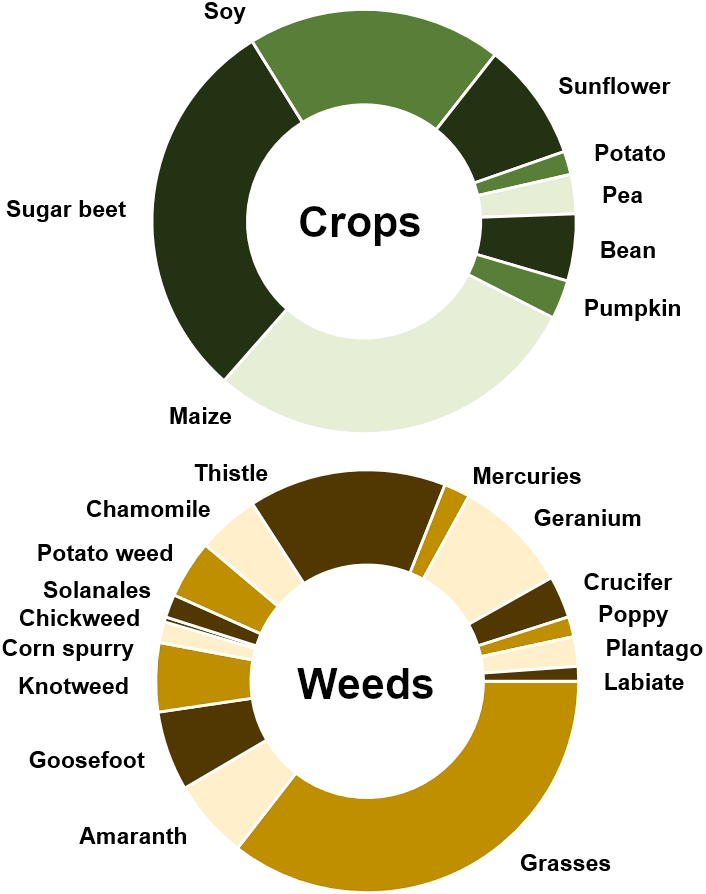<br>
Distribution of crop and weed classes. Image extracted from [Steininger et al., 2023].</p>

<a id="tab:dataset-subsets"></a>
<p style="text-align: center;">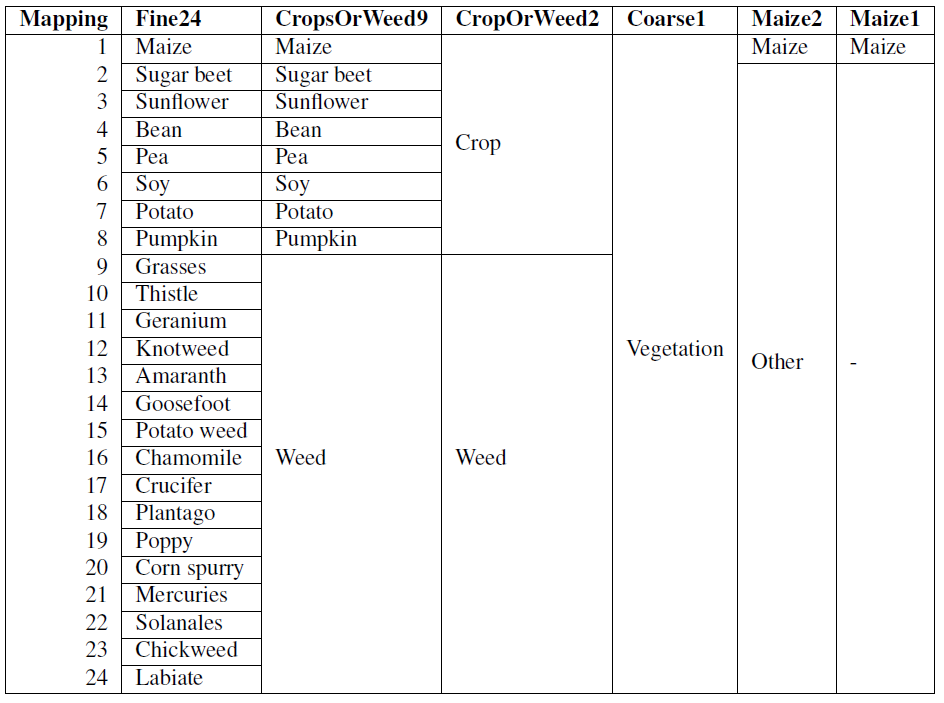<br>
Table 1: Overview of the subsets of the dataset. All crop variants come with two additional subsets with either one-vs-rest or no additonal instances.
    Table extracted from supplementary material <a href="https://openaccess.thecvf.com/content/WACV2023/supplemental/Steininger_The_CropAndWeed_Dataset_WACV_2023_supplemental.pdf">[Steininger et al., 2023b]</a>.</p>


## Training framework

While the architecture and pretrained weights are the same the [original code](https://github.com/WongKinYiu/yolov7) from Wang et al. their framework is not used.
To access the model architecture crucial parts from [Chris Hughes'](https://github.com/Chris-hughes10/Yolov7-training) implementation, which is easier accessable, and incorporated into a PytorchLightning training framework.
This will very likely cost some speed benefits but brings high and mid level customization capabilities during the whole training process and before.

By the standard of PyTorch Lightning the datamodules handle the data aquisition (download and preparation) which is pursued here. 
Nonetheless I will guide through on how to aquire it in a more manual fashion.

# Aquiring the necessary ressources

In the following it will be explained how to acquire the dataset and the yolov7 architectures.

## Python environment <a id="res:python">

Used Python version 3.9.7  
Tested PyTorch versions 2.0.0 and 2.0.1 with CUDA 11.7 and 11.8, as well as the current nightly version  
Early versions of the code also worked with PyTorch < 2.0 
                                                         
Below is a cell that contain the necessary steps to setup up the environment

The following is a more lightweight environment and has cleaner dependencies but it was designed not with the notebook in mind but to be used directly with the command line to use the train_experiments.py file

## Downloading the dataset

### Repository to download the data

The used dataset is ~10GB.
The code from the authors to download the dataset and preparing the segmentation masks is taken from here:

In [1]:
# Remark: this repository cannnot be installed and must be cloned
!git clone https://github.com/cropandweed/cropandweed-dataset.git

fatal: destination path 'cropandweed-dataset' already exists and is not an empty directory.


### Downloading the data

The following line of code downloads the dataset and afterwards creates the segmentation masks for each subdataset.  
**NOTE: This will take quite some time and needs several GB of space. There is no check if the files already exist.** Therefore it is commented out.

Alternatively the `DataModule.prepare_data` method further below will handle this more safe, but actually to be conform to the PyTorch Lightning standard this can also be handled automatically when starting the straining further below.
The only restriction is that the data path does not exist.

In [2]:
# Uncommenting and running this cell will download the files and overwrites/recreate aready existing ones
#%run "./cropandweed-dataset/cnw/setup.py --data_root './cropandweed-dataset/data'" 

---

## Download YOLOv7

While this was implicitly given from the python environment section above but a few more points shall be pointed out here.

To have more control and to better understand how the YOLO models work we will not use the standard CLI or trainers provides by the [YOLOv7](https://github.com/WongKinYiu/yolov7) authors.
While they have a high level of optimization they lack options for customization and are more difficult to understand.

Chris Hughes provided a port of the official YOLOv7 models which is more accessible and easier to understand; see below. 
While he also provides a training framework we will not make use of it but only use the model architecture, the access to pretrained weights, the loss function and some simple utility functions for example to filter out uncertain predictions from this package.

NOTE: The installation of this package under WINDOWS can be difficult, `pycocotools` and `scikit-image` as dependencies installations might fail.
Installing these beforehand worked out but was very troublesome.

The recommendation is to just clone the repository and install [pytorch-accelerated](https://pypi.org/project/pytorch-accelerated/) manually for the necessary parts to be usable, this was taken care of in the [environment setup](#res:python)
While this creates some overhead in modules that are not used it is the easiest way.

In [3]:
# Note uncommenting and executing this cell likely leads to PROBLEMS ON WINDOWS

# NOTE: pycocotools might need to be installed manually beforehand if this raises an error during installation
# likewise scikit-image <0.19

#!pip install git+https://github.com/Chris-hughes10/Yolov7-training.git

In [4]:
# Recommended under windows
!git clone https://github.com/Chris-hughes10/Yolov7-training.git
#!pip install pytorch-accelerated  

fatal: destination path 'Yolov7-training' already exists and is not an empty directory.


### Test the installation

In [5]:
import os
import sys
sys.path.append(os.path.join(os.getcwd(), "Yolov7-training"))

In [6]:
# Test the installation
from yolov7 import create_yolov7_model, create_yolov7_loss
from yolov7.trainer import filter_eval_predictions
from yolov7.models.yolo import Yolov7Model

---
# --- Start of Main code and global setup --- <a id="import"></a>

---

The code above needs to run once only. Below is the code that can be reused for different experiments.

## Environment variables - GPU selection

This limits us to one GPU

In [7]:
import os

# Set environmental variables for example which GPUs to be used

#os.environ['USE_CPU'] = "1"             
os.environ["CUDA_VISIBLE_DEVICES"] = "0" 
#os.environ["CUDA_LAUNCH_BLOCKING"] ="1" # enable for debugging

In [8]:
!nvidia-smi

Mon Apr 17 16:32:57 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  On   | 00000000:3A:00.0 Off |                    0 |
| N/A   34C    P0    39W / 300W |      9MiB / 32768MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Imports A (installed packages)

In [9]:
import os
import sys
import time
import multiprocessing
import glob


import numpy as np
import pandas as pd

# Documentation
from typing import List, Dict, Union, Tuple
from functools import wraps
import warnings

from tqdm import tqdm

# Pytorch
import torch
from torch.utils.data import DataLoader, Dataset, random_split
import torchvision
from torchvision.datasets import VisionDataset, ImageFolder
from torchvision import transforms

# Evaluation
import torchmetrics

# Training Framework
import pytorch_lightning as pl
from pytorch_lightning import Trainer
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

# Note: Deepspeed does not work in interactive python (Jupyter notebooks)
# https://pytorch-lightning.readthedocs.io/en/stable/advanced/model_parallel.html#deepspeed-zero-stage-1
#from pytorch_lightning.strategies import DeepSpeedStrategy
#from deepspeed.ops.adam import DeepSpeedCPUAdam

# Image augmentation
import albumentations as A

from albumentations.pytorch import ToTensorV2
try:
    from albumentations.core import bbox_utils as bu # new versions
except ImportError:
    from albumentations import bbox_utils as bu 

# Image libraries
#from PIL import Image # lightning relies on PIL, but cv2 aligns better with albumentations
import cv2 
import matplotlib.pyplot as plt   
import seaborn
    
# Developement / Debugging
from importlib import reload # For reloading during developement

# Hyperparameter tuning
import optuna

In [10]:
# I realised this is ambigious is some notebook setups
try:
    display(torch.__version__, pl.__version__, A.__version__, torchmetrics.__version__) # different juypter setups import this or not
except Exception as e:
    display.display(torch.__version__, pl.__version__, A.__version__, torchmetrics.__version__)
# This should clarify it
from IPython import display as Idisplay
from IPython.display import display

'2.0.0+cu117'

'2.0.1.post0'

'1.3.0'

'0.11.4'

In [11]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

## Define global settings <a id='settings'></a>
[to the top](#top)  
[to training](#training)  
[to hyperparameter optimization](#hopt) 

Here global settings are defined that are to constant throughout the code or a full experiment.
Along others is defined here everything that is related to the dataset that affects the loading of the samples.
For example which dataset to choose, the image and batch sizes.

Additionally some special and more or less time consuming tasks like possible bounding box evaluation can be enabled here.

In [12]:
SEED = 4222
pl.seed_everything(SEED)

BATCH_SIZE = 48
NUM_WORKERS = 10

ACCUMULATE_BATCH_SIZE = BATCH_SIZE # accumulate gradients if batch size is lower than this

# Image Size is (height, width) in relation to OpenCV
IMAGE_SIZE = (640, 640)
# Theoretically yolo can support other shapes that are divisible by 8 but especially built for these.
assert IMAGE_SIZE in [(640, 640), (1280, 1280)]


#-----
# Augmentation settings

# Because the original size of 1088x1980 leaves a lot of blank space
# if image is squared by padding
# And to prevent that bounding boxes might be often in the center
# Two images will be stacked 2176x1980
# Downscaled to X x IMAGE_SIZE and croped to IMAGE_SIZE x IMAGE_SIZE
STACK_2IMAGES = True

# Normalize images
NORMALIZE_IMAGES = False
# Whether to normalize to ImageNet parameters or extracted from this dataset.
IMAGENET_NORMALIZATION = True

# Extract mean and std from the current training dataset 
# if false and normalization without imagenet is used then
# precalculated mean and variance is used
# for performance reasons it is recommended to use the precalculated
CALCULATE_NORM_FROM_DATASET = False

# NOTE: a few more comments about this are in the augmentations section
# min_area and min_visibility define when a bounding box gets
# dropped if it is too small after transformation
BBOX_PARAMS = A.BboxParams(format='pascal_voc',  # Left, Top, Right, Bottom
                            #format="yolo",
                           label_fields=["class_labels"],
                           min_area=30,          # Min amount of pixels
                           min_visibility=0.2)   # area ratio from after to the before

#--------
# Dataset
# Which (sub)Dataset to choose
DATASET = 'CropOrWeed2' 

# Valid entries are
# 'Fine24', 'CropsOrWeed9', 
# 'Maize2', 'Maize1', 'SugarBeet2', 'SugarBeet1', 'Soy2', 'Soy1', 
# 'Sunflower2', 'Sunflower1', 'Potato2', 'Potato1', 'Pea2', 'Pea1', 
# 'Bean2', 'Bean1', 'Pumpkin2', 'Pumpkin1', 'CropOrWeed2', 'Coarse1'
# Not open for choice is 'CropAndWeed'

# The dataset annotations provide additional information about the 
# setting and difficulty of the task in the range of {0...2}
# NOTE: Filtering is currently not implemented.
FILTERS = {
    "Moisture" : (0, 1, 2),      # dry to wet
    "Soil"     : (0, 1, 2),      # fine to coarse
    "Lightning": (0, 1),         # sunny to diffuse. Note: This is binary
    "Seperability": (0, 1, 2)    # easy to hard
}
FILTERS = NotImplemented


#-----
# Special Tasks

# evaluates the preset prediction anchors of the model
EVALUATE_ANCHORS = True  

# Finds preset bounding boxes that better fit the dataset
CALCULATE_NEW_ANCHORS = False

# Calculates the baseline prediction
CALCULATE_BASELINE = False #<--- Should be set to True, but deactivate for performance reasons

[rank: 0] Global seed set to 4222
[rank: 0] Global seed set to 4222


### Setup path variables

In [13]:
import os
os.getcwd()

'/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection'

In [14]:
# Choose path where the github repository will be cloned to an the cnw folder will be
CNW_PATH = "./cropandweed-dataset/"
OPTUNA_DB_PATH = "./OptunaTrials/trials.db"
MODEL_PATH = "./models"

if os.getcwd().startswith("/pfs"):                     # bwUniCluster
    # This will copy the data to a closeby SSD drive
    ssd_path = os.environ["TMP"]
    work_path = !ws_find industry
    work_path = work_path[0]
    DATA_PATH = os.path.join(ssd_path, "data")
    MODEL_PATH = os.path.join(work_path, "models")
    #Init SSD and copy files
    if not os.path.exists(os.path.join(ssd_path, "data")):    
        os.mkdir(DATA_PATH)
        print("Copying data to SSD...")
        from shutil import copyfile
        import subprocess
        
        # Copy images and bboxes from the 3 main subsets used here
        copyfile(os.path.join(CNW_PATH, "data", "data.tar"), os.path.join(DATA_PATH, "data.tar"))
        subprocess.call(["tar", '-xf', os.path.join(DATA_PATH, "data.tar"), "-C", DATA_PATH])
        #print("Data copied")

elif os.getcwd().startswith("/ceph"):                  #dws server
    DATA_PATH = os.path.join(CNW_PATH, "data")
else:
    DATA_PATH =r'./cropandweed-dataset/data'                               # for example local TODO adjust

IMAGES_PATH = os.path.join(DATA_PATH, "images")
BBOX_PATH = os.path.join(DATA_PATH, "bboxes")

assert os.path.exists(BBOX_PATH)
assert os.path.exists(IMAGES_PATH)
assert os.path.exists(CNW_PATH)
# Not  ssert

display(CNW_PATH, DATA_PATH, IMAGES_PATH, OPTUNA_DB_PATH, MODEL_PATH)

'./cropandweed-dataset/'

'/scratch/slurm_tmpdir/job_22032970/data'

'/scratch/slurm_tmpdir/job_22032970/data/images'

'./OptunaTrials/trials.db'

'/pfs/work7/workspace/scratch/ma_dsperber-industry/models'

## Imports B (local packages)

[to the top](#top)  
[to training](#training)  
[to hyperparameter optimization](#hopt) 

This includes the one for the dataset cloned from github and private modules. For the first one we first need to set up the path variables.

In [15]:
if CNW_PATH not in sys.path:
    sys.path.append(CNW_PATH) # folder contains hypen so using this workaround
    sys.path.append(CNW_PATH+"/cnw")

import cnw
from cnw.utilities.datasets import DATASETS
from cnw.visualize_annotations import visualize_annotations

# This prints the avaliable sub datasets
print(DATASETS.keys())

import utils
reload(utils) # fore developement
from utils import visualize_bbox

dict_keys(['CropAndWeed', 'Fine24', 'CropsOrWeed9', 'Maize2', 'Maize1', 'SugarBeet2', 'SugarBeet1', 'Soy2', 'Soy1', 'Sunflower2', 'Sunflower1', 'Potato2', 'Potato1', 'Pea2', 'Pea1', 'Bean2', 'Bean1', 'Pumpkin2', 'Pumpkin1', 'CropOrWeed2', 'Coarse1'])


In [16]:
# Assure valid DATASET is choosen
assert DATASET in DATASETS, f"Global variable DATASET '{DATASET}' is not in predefined DATASETS: " + str(DATASETS.keys()) 

The `DATASET` dict provides information about the segmentation color.
All are provided in `DATASETS['CropAndWeed']`.
Finer, coarser and specialized datasets with their own colors exist as well.

Below is a little cheat sheet that might help to understand the `DATASETS` objects more

In [22]:
#DATASETS['Fine24'] = Dataset({
#    0: ('Maize', (255, 0, 0), [1, 2, 3, 4, 5, 6]),  # (Name, Segmentation color, sample_ids)
#    1: ('Sugar beet', (255, 85, 0), [7, 8, 9, 10, 11, 12])
#    ...

# Line of Finde24 vwg-0852-0009.csv
# Left, Top, Right, Bottom, Label ID, Stem X, Stem Y
# 0,    1070,   25,  1088 ,       22,     24,   1084

print(DATASETS['Fine24'].get_mapped_id(12),    # sample_id -> key, for example 1...6 -> 0 -> Maize
DATASETS['Fine24'].get_label_name(1),    # key -> name
DATASETS['Fine24'].get_label_color(1))   # key -> color 

1 Sugar beet (255, 85, 0)


# Dataset exploration <a id="dataset-exploration"><a/>

[to the top](#top)  
[to dataset description](#dataset)

Now that everything is setup we can load the first images from the dataset.

As one can now verify the images are taken from a realistic setting.
This includes not only that they are from a real field but also they are taken from a larger distance which creates rather small sizes of the instances.
Some are hard to spot, do you see there is one at (1500, 200).
Like already noted these two aspects make this dataset different from various others.
There is a bias towards the center though, but not always. This will be addressed later during augmentations.

In [109]:
# Lets fetch all files once and check if they do match
ALL_IMAGES = sorted(glob.glob(os.path.join(IMAGES_PATH, "*.jpg")))
ALL_BBOXES = sorted(glob.glob(os.path.join(BBOX_PATH, "CropAndWeed", "*.csv")))
print(len(ALL_IMAGES), len(ALL_BBOXES))

8034 8034


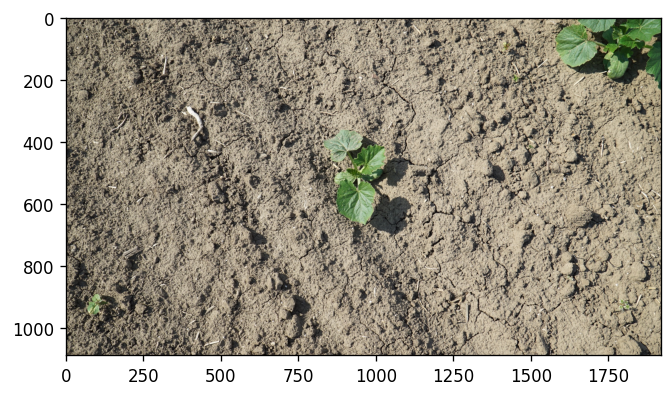

In [106]:
# Using cv2 here as a reminder that is uses BGR instead of RGB, therefore the [2,1,0] channel shuffle
plt.figure(dpi=120)
plt.imshow(cv2.imread(os.path.join(DATA_PATH, r"images/ave-0554-0040.jpg"))[:,:,[2,1,0]])
plt.show()

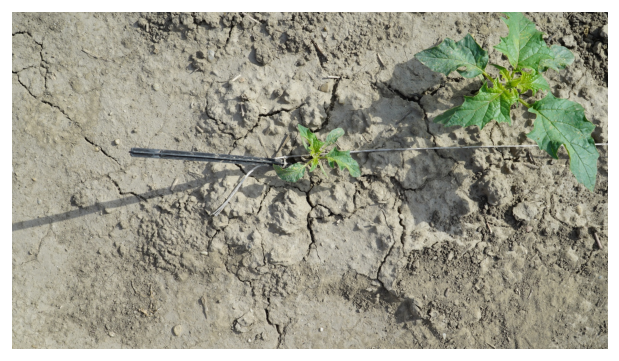

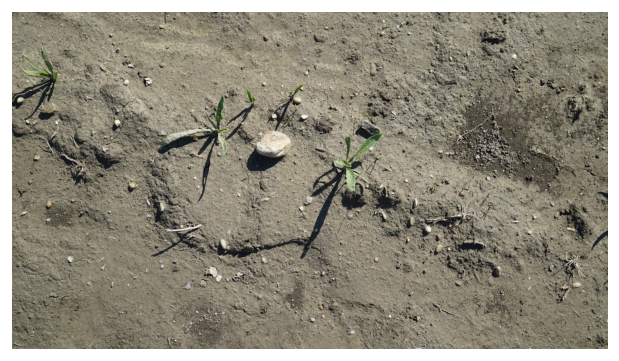

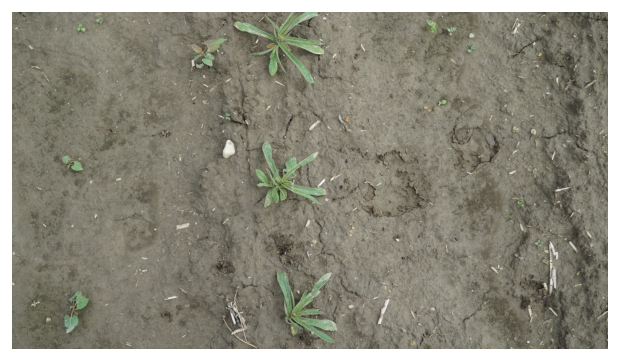

In [79]:
# And plot some random examples
for i in range(3):
    plt.figure(dpi=120)
    plt.imshow(plt.imread(np.random.choice(ALL_IMAGES)))
    plt.axis(False)
    plt.show()

---
Now we are adding the bounding boxes. The small black boxes are plant instances which are not classified.
These are either classes that were not specifically added to the dataset or instances below 16² pixels.

At the bottom of an image is displayed to total amount of instances in the image.

Many instances are quite small and optimally the model can extract the necessary features from just a few hundred pixels but that is something we need to verify.



100%|██████████| 8034/8034 [00:03<00:00, 2650.62it/s]


32


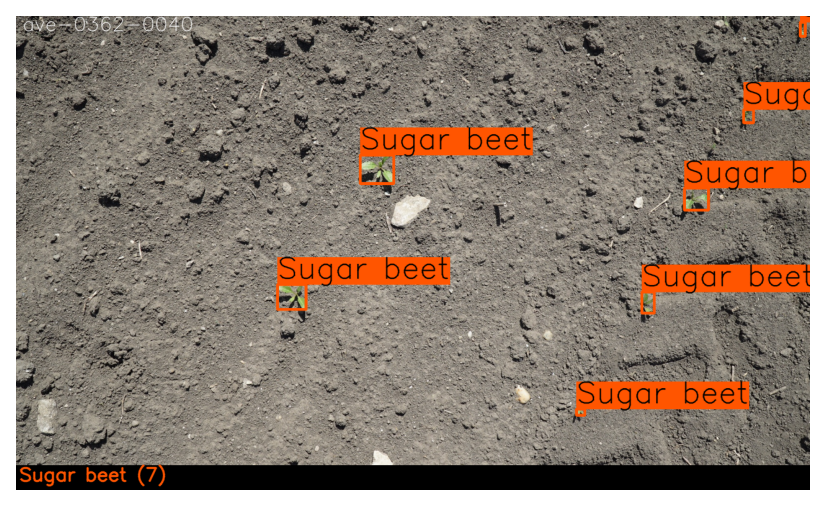

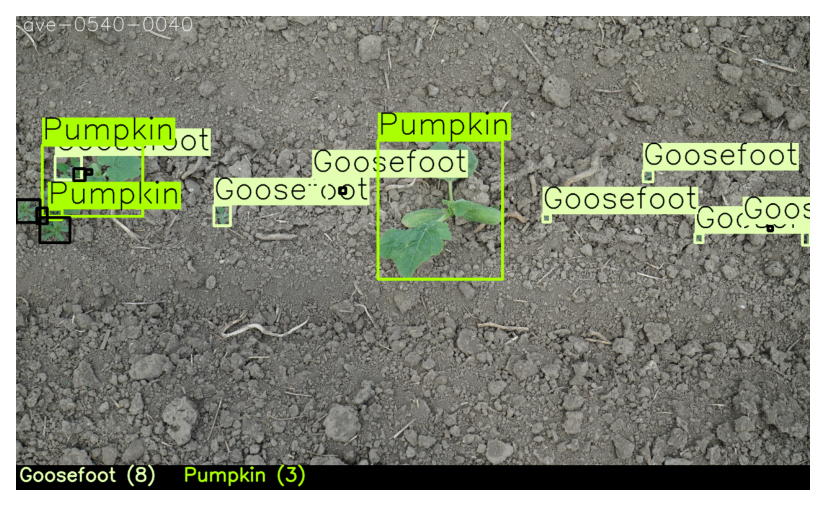

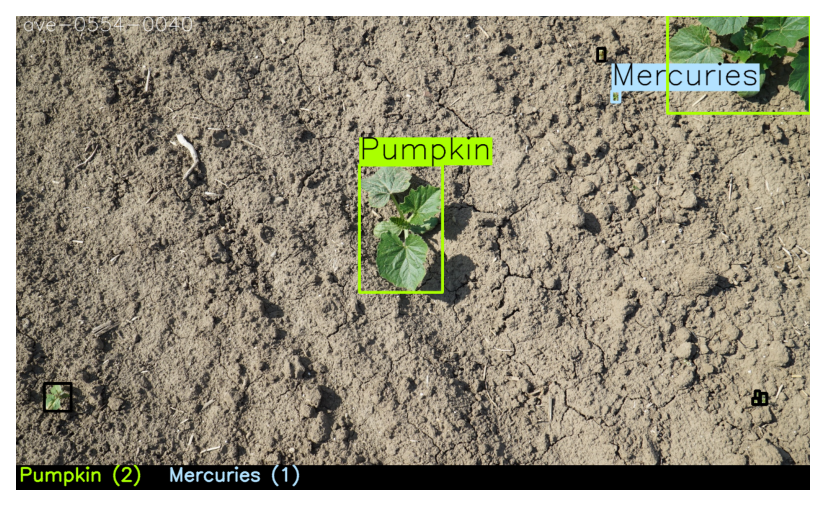

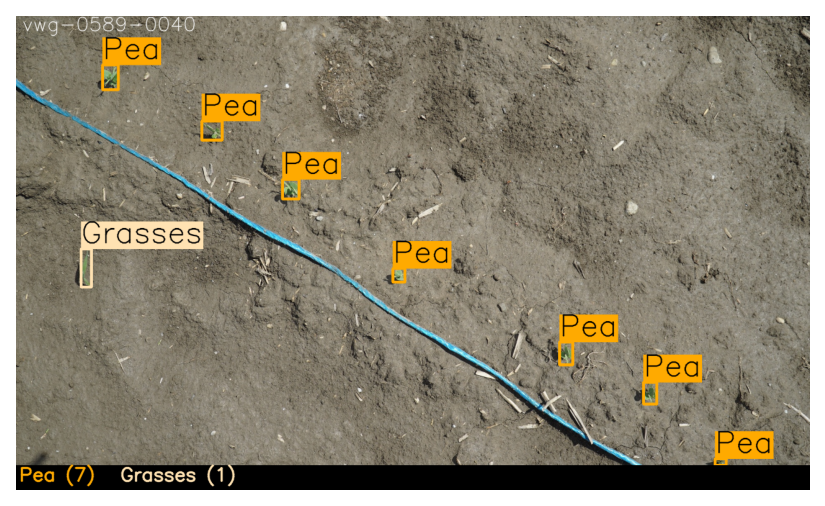

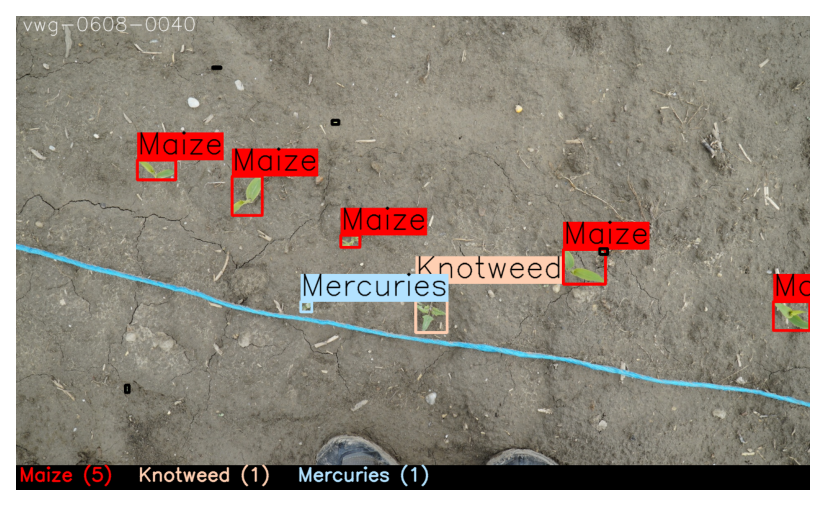

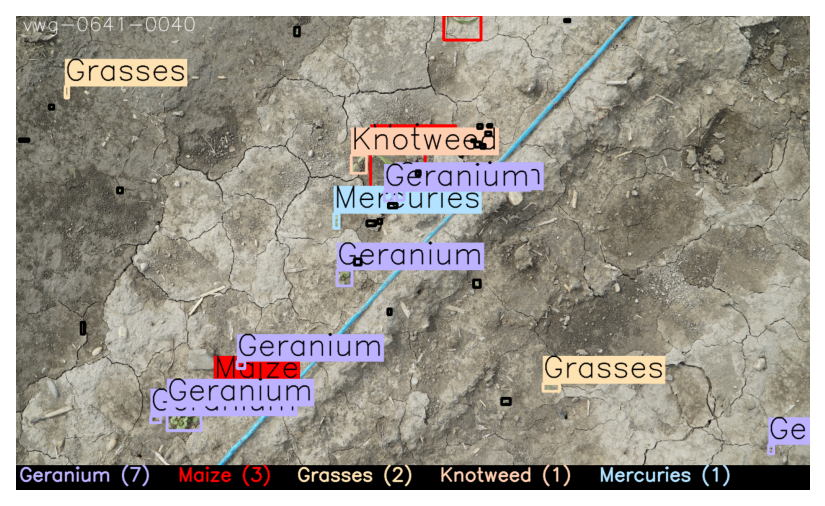

In [13]:
reload(utils)
os.makedirs(os.path.join(DATA_PATH, "visualizations"), exist_ok=True)
images = utils.visualize_original_bboxes(DATASETS['Fine24'], # this contains all the color and name mapping but not the dataset name
                                         dataset="Fine24",   # need do pass it seperately for the paths
                                         data_path=DATA_PATH, 
                                         save_to_disk=True,
                                         output_dir=os.path.join(DATA_PATH, "visualizations"),
                                         image_filter="0040" # part of the filename -> 32 images total         
                                         )

print(len(images))

for img in images[20::2]:  
    plt.figure(dpi=160)
    plt.imshow(img)
    plt.axis(False)
    plt.show()

del img
del images

In [26]:
# For the interested
?utils.visualize_original_bboxes

Signature:
utils.visualize_original_bboxes(
    cnw_dataset,
    dataset: str,
    data_path: Union[str, os.PathLike] = './data',
    *,
    bbox_files: List[str] = None,
    save_to_disk: bool = True,
    output_dir: Union[str, os.PathLike] = './data/visualization',
    image_filter: str = None,
    **kwargs,
) -> list
Docstring:
Annotes the original images with the true bounding boxes.


Parameters
----------
cnw_dataset : cnw.datasets.dataset
    A cnw.datasets.dataset instance that hold information about names and 
    color mappings.
dataset : str
    Name of the dataset, must be the same as for the cnw_dataset but this
    does not have that information.
data_path : Union[str, os.PathLike], optional
    Root folder which holds the images and bounding boxes.
    The default is "./data".

---
Keyword only arguments:
    
bbox_files : List[str], optional
    A list of file names for which the bounding bloxes are to be plotted. 
    The default is None.
save_to_disk : bool, optional


## Bounding box counts

For object detection it is important to also have negative samples, images without bboxes.
Here it is checked if such samples are present and in which quantity. 

In [212]:
len(DATASETS["Fine24"].labels)

24

In [228]:
def count_bboxes(file):
    with warnings.catch_warnings():
        warnings.simplefilter("ignore") # for empty files
        return len(np.loadtxt(file, delimiter=",", dtype=int))

def count_all_bboxes():
    pool = multiprocessing.Pool(utils.check_worker_count(9))
    return pool.map(count_bboxes, glob.glob(os.path.join(BBOX_PATH, "CropAndWeed", "*.csv")))

bbox_counts = np.zeros(len(ALL_BBOXES), dtype=int)
class_counts = np.zeros(len(DATASETS["Fine24"].labels), dtype=int)
bbox_areas = [[] for _ in range(len(DATASETS["Fine24"].labels))]

with warnings.catch_warnings():
    warnings.simplefilter("ignore") # for empty files
    for i, file in enumerate(glob.glob(os.path.join(BBOX_PATH, "Fine24", "*.csv"))):
        data = np.loadtxt(file, delimiter=",", dtype=int) # lets do this for 24 classes
        bbox_counts[i] = len(data)
        if len(data) == 0:
            continue
        if len(data.shape) == 1:
            data = data[None, :]
            #labels = DATASETS["Fine24"].get_mapped_id(labels)

        labels, counts = np.unique(data[:,4], return_counts=True)
        #labels[labels==255] = len(class_counts) -1 # vegetation class that is mapped to 255
        #labels = list(map(DATASETS["Fine24"].get_mapped_id, labels))
        class_counts[labels] += counts
        bbox_widths = data[:, 2] - data[:, 0]
        bbox_heights = data[:, 3] - data[:, 1]
        areas = bbox_widths * bbox_heights
        for idx, area in zip(labels, areas):
            bbox_areas[idx].append(area)

# No need to multiprocess this here 
#start = time.perf_counter()
#bbox_counts = count_all_bboxes()
#print(time.perf_counter() - start)
#bbox_counts = np.array(bbox_counts)

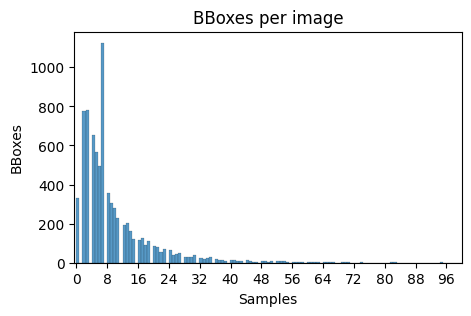

In [229]:
plt.subplots(figsize=(5,3))
seaborn.histplot(bbox_counts)  # as we have 255 features we can abuse this plot type
plt.xticks(range(0,255,8))
plt.xlabel("Samples")
plt.ylabel("BBoxes")
plt.title("BBoxes per image")
plt.xlim(-0.5, 100)
plt.show()

In [195]:
# lets look at some count information
display(bbox_counts.max(), bbox_counts.mean(), bbox_counts.std())
print((bbox_counts == 0).sum(), "/", len(bbox_counts))

206

10.289768483943242

12.344231936706992

329 / 8034


There are 329 negative samples, so roughly 4%.

Further we see there are even 206 instances in one image.


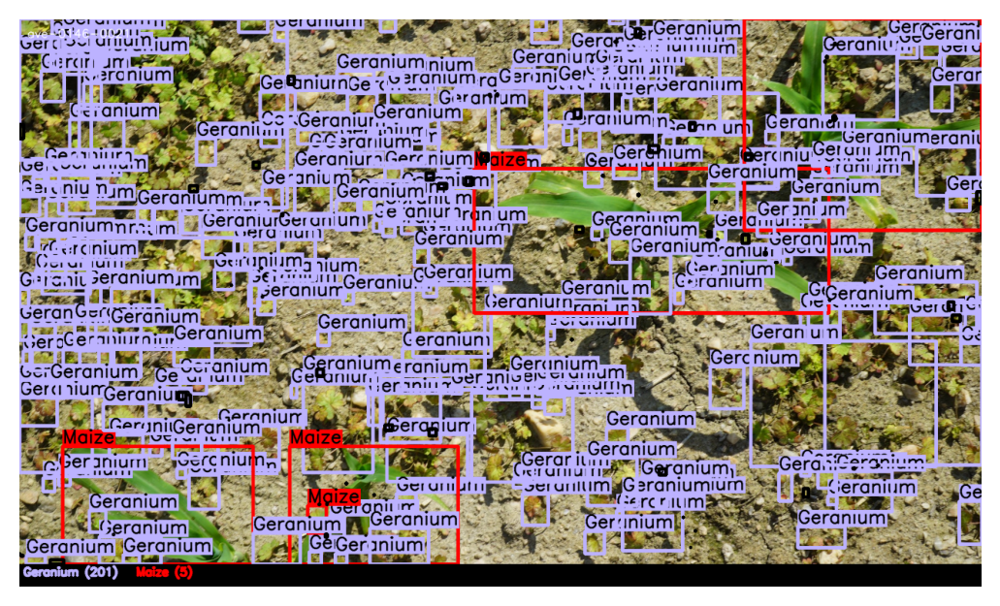

In [198]:
reload(utils)
images = utils.visualize_original_bboxes(DATASETS['Fine24'],
                                         dataset="Fine24",   
                                         data_path=DATA_PATH, 
                                         save_to_disk=False,
                                         bbox_files=None,
                                         output_dir=os.path.join(DATA_PATH, "visualizations"), 
                                         pbar=False,
                                         image_filter=os.path.split(glob.glob(os.path.join(BBOX_PATH, "Fine24", "*.csv"))[np.argmax(bbox_counts)])[1][:-4],
                                         font_scale=0.4,
                                         )

for img in images:  
    plt.figure(dpi=200)
    plt.imshow(img)
    plt.axis(False)
    plt.show()

## Key Distributions

### Species

As it was already shown in the [dataset section](#dataset). There is a huge imbalance in the classes.

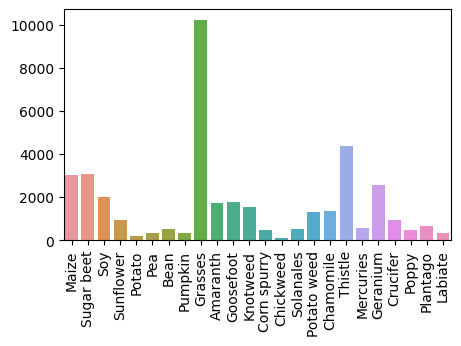

In [203]:
plt.subplots(figsize=(5,3))
seaborn.barplot(np.vstack([range(len(class_counts)), class_counts]), errorbar=None)  # as we have 255 features we can abuse this plot type
plt.xticks(range(len(DATASETS["Fine24"].labels)), list(map(lambda v: v[0], DATASETS["Fine24"].labels.values())), rotation=90)

plt.show()   

### Bounding boxes

There are quite a few outliers with big bounding boxes while the lowest possible bound is given with 16² by design.

Overall there is a wide range of possible sizes for all classes but most are in areas where networks should be able to achieve.
Problematic is only that this is the original image size.

It shall be noted while we have the least amount of samples for potatoes their instance sizes are relatively large.
Also we can see that the median size for the crops is mostly larger than for the weeds, with expectation of the sugar beet and soy.

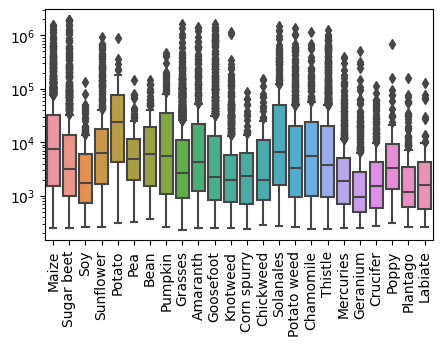

In [226]:
plt.subplots(figsize=(5,3))
seaborn.boxplot(bbox_areas)
plt.xticks(range(len(DATASETS["Fine24"].labels)), list(map(lambda v: v[0], DATASETS["Fine24"].labels.values())), rotation=90)
plt.yscale("log")
plt.show()

Just as an idea to maybe weight the amount of instances with the mean area, which would give the amount of pixels in the dataset that belong to these instances.
It would be interesting to see if there is a correlation between the end result and this or any of the other statistics.

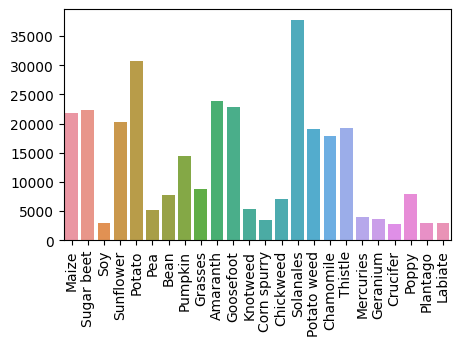

In [243]:
plt.subplots(figsize=(5,3))
seaborn.barplot(np.vstack([range(len(class_counts)), [np.mean(a) for a in bbox_areas]]), errorbar=None)
plt.xticks(range(len(DATASETS["Fine24"].labels)), list(map(lambda v: v[0], DATASETS["Fine24"].labels.values())), rotation=90)
plt.show()

## Dataset cleanup

Beside the first visual exploration we do a quick sanity check to detect if we can detect obvious outliers.
For that we look at the brightness histograms of the images to see if there are special deviations.

Note that depending on the compute capabilities this can take several minutes, even with the used multiprocessing - even on a server cluster or maybe because of such a cluster.
Using the dataloaders below is more efficient for this task, but conceptional introducing them before this point does not seem sensible in the overall perspective.

405.04332814505324


  0%|          | 0/3 [1:50:42<?, ?it/s]


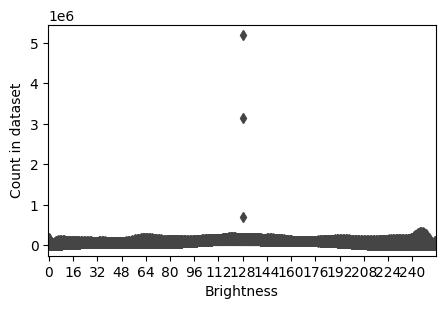

In [140]:
def count_pixels(file):
    img = cv2.imread(file)
    values, counts = np.unique(img, return_counts=True)
    standard_counts = np.zeros(256, dtype=int) # assure that every 0-255 value exists and mapped correctly
    standard_counts[values] = counts
    return standard_counts

def count_all():
    pool = multiprocessing.Pool(utils.check_worker_count(9))
    return pool.map(count_pixels, glob.glob(os.path.join(IMAGES_PATH, "*.jpg")))

start = time.perf_counter()
all_counts2 =count_all()
print(time.perf_counter() - start)

all_counts = np.array(all_counts)
plt.subplots(figsize=(5,3))
seaborn.boxplot(all_counts)  # as we have 255 features we can abuse this plot type
plt.xticks(range(0,255,16))
plt.xlabel("Brightness")
plt.ylabel("Count in dataset")
plt.show()

We can clearly see that there are 3 outliers with a large amount of pixels valued 128.
With the following lines we can find these files and check them out manually.

In [142]:
corrupted_images = [ALL_IMAGES[i] for i in np.where(all_counts[:,128] > 0.5e6)[0]]
display(corrupted_images)

['/scratch/slurm_tmpdir/job_22020237/data/images/ave-0506-0007.jpg',
 '/scratch/slurm_tmpdir/job_22020237/data/images/ave-0357-0008.jpg',
 '/scratch/slurm_tmpdir/job_22020237/data/images/ave-0527-0009.jpg']

In [85]:
# As backup if too timeconsuming
corrupted_images = list(map(lambda f: os.path.join(IMAGES_PATH, f), ['ave-0506-0007.jpg',
 'ave-0357-0008.jpg',
 'ave-0527-0009.jpg']))
corrupted_images

['/scratch/slurm_tmpdir/job_22032970/data/images/ave-0506-0007.jpg',
 '/scratch/slurm_tmpdir/job_22032970/data/images/ave-0357-0008.jpg',
 '/scratch/slurm_tmpdir/job_22032970/data/images/ave-0527-0009.jpg']

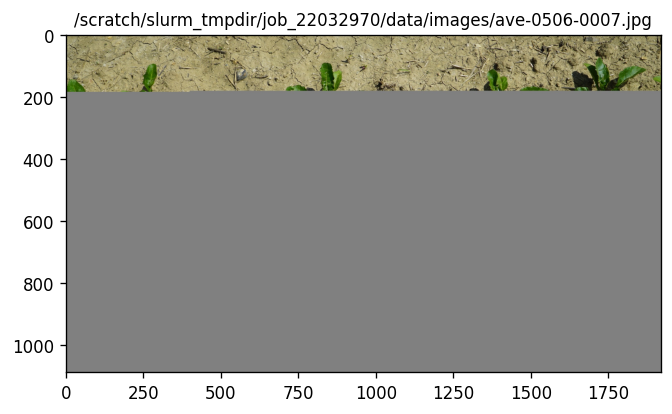

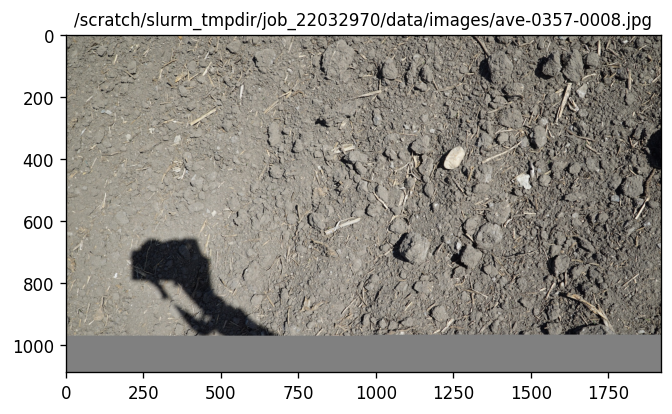

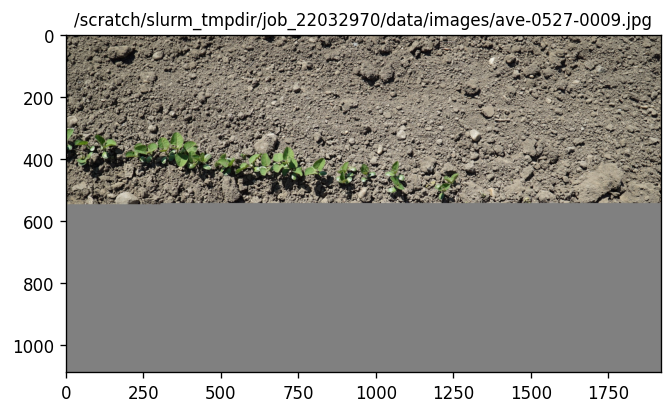

In [72]:
for file in corrupted_images:
    plt.figure(dpi=120)
    plt.imshow(plt.imread(file))
    plt.title(file, fontsize=10)
    plt.show()

---

Additionally lets look at the bounding boxes:

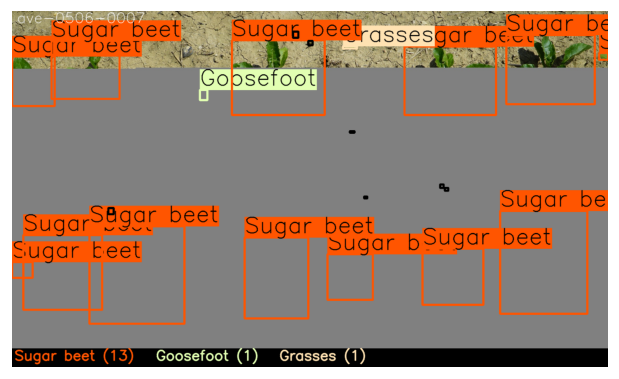

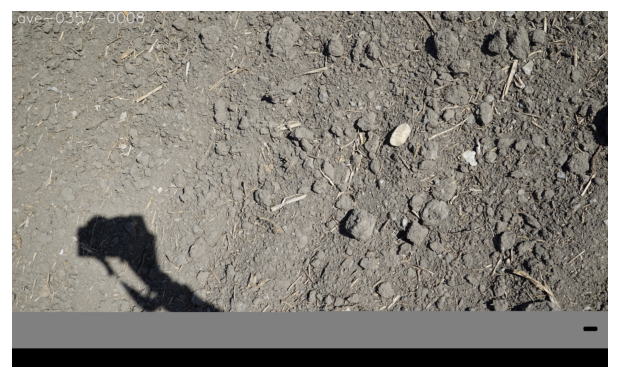

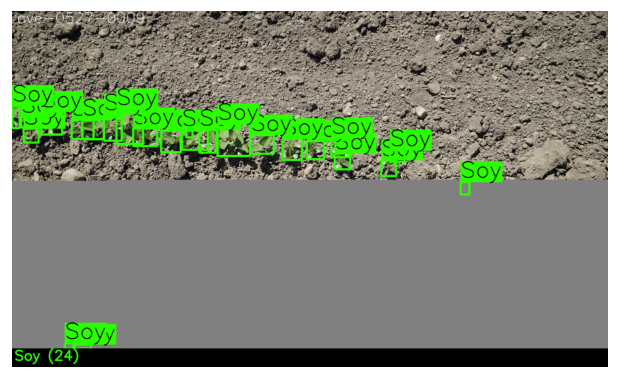

In [84]:
reload(utils)
images = utils.visualize_original_bboxes(DATASETS['Fine24'],
                                         dataset="Fine24",   
                                         bbox_files=list(map(lambda f : utils.image_to_bbox_file(f, BBOX_PATH), corrupted_images)),
                                         data_path=DATA_PATH, 
                                         save_to_disk=False,
                                         output_dir=os.path.join(DATA_PATH, "visualizations"), 
                                         pbar=False,
                                         )

for img in images:  
    plt.figure(dpi=120)
    plt.imshow(img)
    plt.axis(False)
    plt.show()


From the bounding boxes we can deduct that especially image `ave-0506-0007.jpg` is problematic.
And we will delete that image.  
`ave-0357-0008.jpg` has no instances and is mostly intact it will be left untouched.  
`ave-0527-0009.jpg` is half intact and only misses three bounding boxes, for simplicity this could be ignored or these three the bounding boxes removed.  

It can also be argued to add some noise to the labels that this might also be beneficial to avoid overfitting, which would be a reason to keep them in.
Likely as only one in over 8000 images is severely corrupted we might not see an effect in the outcome.

The removal / adjustment could be done like in the following ways.
But to keep the original integrity of the data and the notebook intact this step shall be omitted only for this purpose.
As there are multiple subdatasets one has to keep in mind to remove/adjust the bounding box files from all these, as well as the segmentation maps and annotations.

In [132]:
# Remove ave-0506-0007.jpg

if False: # <-- remove for real case
    os.remove(os.path.join(IMAGES_PATH, "ave-0506-0007.jpg"))
    # Remove all bounding box infos
    for dataset in DATASETS.keys():
        path = os.path.join(BBOX_PATH, dataset, "ave-0506-0007.csv")
        if os.path.exists(path):
            os.remove(path)
    # Note: same has to be done for masks and annotations

In [204]:
# Adjust ave-0527-0009.csv

for dataset in DATASETS.keys():
    bboxes = np.loadtxt(os.path.join(BBOX_PATH, DATASET, "ave-0527-0009.csv"), dtype=int, delimiter=",")
    bboxes=bboxes[np.argsort(bboxes[:,3])] # sort by bottom border
    print(bboxes, "<-- The bottom 3 (4th column), below <=591 pixels, are the ones that we want to remove")
    path = os.path.join(BBOX_PATH, dataset, "ave-0527-0009.csv")
    break # <-- remove for real case
    if os.path.exists(path):
        np.savetxt(path, bboxes[:-3], delimiter=",")

[[  29  341   93  375    0   61  358]
 [   0  305   24  377    0   12  341]
 [  94  324  161  398    0  128  361]
 [ 561  385  581  407    0  571  396]
 [ 192  351  262  412    0  227  382]
 [ 226  350  295  413    0  260  382]
 [ 296  333  353  418    0  324  376]
 [  37  379   85  424    0   61  401]
 [ 336  316  422  428    0  379  372]
 [ 390  378  467  435    0  428  407]
 [ 547  384  630  447    0  589  416]
 [ 480  386  543  455    0  512  420]
 [ 603  383  659  456    0  631  419]
 [ 769  400  843  460    0  806  430]
 [ 662  364  766  467    0  714  415]
 [1028  409 1090  471    0 1059  440]
 [ 950  419 1004  477    0  977  448]
 [ 871  412  933  480    0  902  445]
 [1217  449 1264  486    0 1241  468]
 [1039  459 1089  510    0 1064  485]
 [1189  481 1237  532    0 1213  506]
 [1445  551 1473  591    0 1459  571]
 [ 170 1071  197 1088    0  184 1079]
 [ 201 1075  254 1088    0  228 1082]] <-- The bottom 3 (4th column), below <=591 pixels, are the ones that we want to remove


# Fetching data from the drive: `Dataset` and `DataModule` classes <a id="datamodule">
    
[to the top](#top)  

This section sets up the necessary classes for to load the data, split it into train, test and validation sets.
This is the full pipeline from loading the images from the disk, applying augmentation and finally preparing a batch for it be sent to the GPU and processed by the model.

### Dataset class

The dataset classes handle loading single images from the disk and applying augmentation.

The most interesting point here is the augmentations which will be used to stack two images together.
This is one hand to counter a potential bias towards the center of an image where bounding boxes lay more often,
on the other hand as the YOLO model needs square inputs and the models have a ratio of about 16 : 11, if we just pad the image nearly half of the space is blank.
With this we can double the amount of input per sample.

While it is used by the `DataLoader`s a nice to know is the `collate_fn` function that prepares the actual batch, but as they might be more specific to the `Dataset` class, which loads and prepares the data it is implemented here.

In [252]:
class CropDataset(torchvision.datasets.VisionDataset):
    """
    Dataset Interface to load images and apply augmentations.
    Allows to use albumination transformations in parallel for mask and images
    """
    #target_transform : A.Compose
    #transforms : torchvision.transforms.Compose
    
    # If we stack two images we downscale and crop them to the correct width.
    
    downscale_transform = A.Compose([A.SmallestMaxSize(max(IMAGE_SIZE)),
                                     A.RandomSizedCrop(min_max_height=(max(IMAGE_SIZE), max(IMAGE_SIZE)),
                                                       w2h_ratio=1.0, height=max(IMAGE_SIZE), width=max(IMAGE_SIZE))], 
                                    bbox_params=BBOX_PARAMS)
    
    def __init__(self, root=DATA_PATH, *, dataset, 
                 stage : Union["test", "valiation", "train"],
                 stack2_images,
                 train_val_test_indices : Dict[str, List[int]] = None, # manually choose which indices to use; 
                 train_val_test_ratio=(0.7, 0.15, 0.15),
                 transforms=None, 
                 transform =None,
                 target_transform=None,
                 normalize_images=False,
                 _init_files=True,     # Set files by dataloader globally, for less overhead.
                 seed=None):           # will be used for the train_val_test_splot
        """
        From official documentation:
        transforms (callable, optional) – A function/transforms that takes in an image 
            and a label and returns the transformed versions of both.

        transform (callable, optional) – A function/transform that takes in an PIL image 
            and returns a transformed version. E.g, transforms.RandomCrop

        # We will only use this one
        target_transform (callable, optional) – A function/transform that takes in 
            the target and transforms it.
        """            
        super().__init__(root, transforms, transform, target_transform)
        self.dataset = dataset
        self.stage = stage
        self.normalize_images = normalize_images
        self.data_dir = root
        self.stack2_images = stack2_images
        self.root = root
        
        """
        # Manually adjust the settings from outside
        # this is more performant if multiple dataloads are loaded and not everyone of them
        # has to perform the splitting of the data and can share the same memory for all_bboxes and all_images (just text strings)
        """
        if _init_files:
            image_dir = os.path.join(root, 'images')
            # If stage val, train load eval boxes
            if stage == "train":
                bbox_dir  = os.path.join(root, 'bboxes', dataset)
            else:
                bbox_dir  = os.path.join(root, 'bboxes', dataset+"Eval") # has more small unclassified bboxes -> more lenient evaluation

            # TODO: need to change validation vegetation label id?
            bbox_dir  = os.path.join(root, 'bboxes', dataset)
            # Extra data sadly unused
            #self.annotation_dir = os.path.join(root, 'Annotations')

            # Some overhead storage. Can be removed later
            # This could be a view!
            #self.all_masks = self.get_files() # masks are filtered for the subsets
            self.all_bboxes = self.get_files() # masks are filtered for the subsets
            # Filter images based on stage TODO ??
            self.all_images = np.asarray([os.path.join(image_dir, os.path.basename(file)[:-4]+".jpg") for file in self.all_bboxes],
                                          dtype=str)
            # verify that to each mask an image exist
            #for i in self.all_images:
            #    if not os.path.exists(i):
            #        raise FileNotFoundError(i)

            # Perform train_val_test split and get indices
            if train_val_test_indices is None:
                self.indices = utils.train_val_test_split(self.all_images, seed or SEED, train_val_test_ratio) 
                self.images = self.all_images[self.indices[self.stage]]
                #self.masks = self.all_masks[self.indices[self.stage]]
            else:
                self.indices = train_val_test_indices
                self.images = self.all_images[self.indices[self.stage]] # This should/could be a view
                #self.masks = self.all_masks[self.indices[self.stage]]

            #self.bboxes =  [os.path.join(bbox_dir, os.path.basename(file)[:-4]+".csv") for file in self.masks ]
            self.bboxes = self.all_bboxes[self.indices[self.stage]]
        return
        # Load BBoxes into Memory
        # Load 
        # While this creates a stronger overhead now makes the loading of the bboxes faster later(?)
        self.bboxes = self.get_all_bboxes()
      
    def get_all_bboxes(self) -> np.ndarray:
        """Load all bbox files as an numpy array"""
        # This should be quite fast but sometimes it seams to stuck at certain files.
        with warnings.catch_warnings():
            warnings.filterwarnings("ignore", category=UserWarning) # supresses warnings of empty files
            #.csv is pascal voc format
            bboxes=[]
            for file in tqdm(self.bboxes):
                bboxes.append(np.loadtxt(file, delimiter=",", dtype=int))
        return np.array(bboxes, dtype=object)
          
    def get_files(self) -> List[str]:
        """Find images belonging to the chosen dataset via the bbox.csv files."""
        files = np.array(glob.glob(os.path.join(self.data_dir, "bboxes", self.dataset, "*.csv")))
        if len(files) == 0:
            raise ValueError("No files found in", os.path.join(self.data_dir, "bboxes", self.dataset))
        return files
    
    @staticmethod
    def get_class_label(label_id) -> str:
        return DATASETS['CropAndWeed'].get_label_name(label_id)
        
    @staticmethod
    def get_bbox_color(bbox):
        label_id = bbox[4]
        return DATASETS[DATASET].get_label_color(label_id)
        mapped_id=DATASETS[DATASET].get_mapped_id(label_id)
        return DATASETS[DATASET].get_label_color(mapped_id)
    
    def __len__(self):
        return len(self.indices[self.stage])
    
    # Evaluate during compilation
    if BBOX_PARAMS.format == "pascal_voc":
        @staticmethod
        def load_bbox(path):
            bbox = np.loadtxt(path, delimiter=",", dtype=np.int32).reshape(-1, 7)
            return bbox[:,4], bbox[:,:4] # label, bbox
    else:
        @staticmethod
        def load_bbox(path):
            bbox = np.loadtxt(path, delimiter=" ", dtype=np.float32).reshape(-1, 5) # yolo format, assure not (5,) shaped
            return bbox[:, 0], bbox[:, 1:]
    
    
    def __getitem__(self, index):
        return self._getitem_stacked(index) if self.stack2_images else self._getitem_normal(index)
    
    def _getitem_stacked(self, index):
        """
        Stack two images vertically together by chosing a second one randomly.
        Advantage no blank color padding needed, more variation and more bounding boxes per image.
        """
        image = cv2.imread(self.images[index])
        bboxf  = self.bboxes[index] # No disc read
        labels, bbox = self.load_bbox(bboxf)
        if self.stage != "train":
            # Return without stacking two images, transform should be resizing&ToTensor
            transformed = self.target_transform(image=np.asarray(image, np.float32) / 255, # bring into 0...1 range
                                                                     #mask=mask, 
                                                                     bboxes=bbox,
                                                                     class_labels=labels,)
            return self._format_transformed(transformed, index)

        # Load 2nd image to patch together
        index2 = np.random.choice(len(self.images))
        image2 = cv2.imread(self.images[index2])
        bbox2f = self.bboxes[index2]
        labels2, bbox2 = self.load_bbox(bbox2f)

        if BBOX_PARAMS.format == "pascal_voc":
            bbox2[:, [1,3]] += image.shape[0] # Adjust Y values of 1st image
        else:
            raise NotImplementedError("Non pascal_voc format")

        full_img = np.vstack((image, image2)).astype(np.float32) / 255 #NOTE: numpy 1.24 allows dtype for vstack
        del image, image2
        bboxes = np.vstack([bbox, bbox2])
        #Downscale
        down_transforms = self.downscale_transform(image=full_img, 
                                                   bboxes=np.vstack([bbox, bbox2]), 
                                                   class_labels=np.hstack([labels, labels2]))
        del full_img
        # TODO join transforms else overhead in bbox format conversions
        transformed = self.target_transform(**down_transforms)
        return self._format_transformed(transformed, index)

    def _getitem_normal(self, index):
        """
        Bounding box logic: Left, Top, Right, Bottom, Label ID, Stem X, Stem Y
        """
        image = cv2.imread(self.images[index])
        #image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # Theoretically RGB not necessary, some overhead
        #SEGMENTATION:
        #mask  = cv2.imread(self.masks[index], cv2.IMREAD_UNCHANGED)
        bboxf  = self.bboxes[index] # No disc read
        labels, bbox = self.load_bbox(bboxf)

        if self.target_transform is not None:
            try:
                transformed = self.target_transform(image=np.asarray(image, np.float32) / 255, # bring into 0...1 range
                                                                     #mask=mask, 
                                                                     bboxes=bbox,
                                                                     class_labels=labels,) 
            except:
                print(bboxf, bbox)
                raise
            image = transformed["image"][2,1,0] # now in tensor format CxHxW, swap to RGB
            #mask  = transformed["mask"]
            bbox = transformed["bboxes"]
            labels = transformed["class_labels"]
            #if mask.dtype != torch.int64:
            #    mask = mask.to(torch.int64)
            return self._format_transformed(transformed, index)
        return self._format_transformed({'image' : image, 'bboxes' : bboxes, 'class_labels': labels}, index)
        
    @staticmethod
    def _format_transformed(transformed, index):
        # This will bring the transformed images and bboxes into the form that we will later use.
        image = transformed["image"][[2,1,0]] # Swap channel order cv2.COLOR_BGR2RGB, should not be necessary actually but so we train with the RGB standard
        #mask  = transformed["mask"]
        bbox = transformed["bboxes"]
        labels = transformed["class_labels"]

        if len(bbox) > 0:
            # bboxes to yolo format
            if BBOX_PARAMS.format == "pascal_voc":
                boxes = torchvision.ops.box_convert(
                    torch.as_tensor(bbox, dtype=torch.float32), "xyxy", "cxcywh"
                )
                boxes[:, [1, 3]] /= IMAGE_SIZE[0]  # normalized height 0-1
                boxes[:, [0, 2]] /= IMAGE_SIZE[1]  # normalized width 0-1
            else:
                boxes = bbox
            classes = np.expand_dims(labels, 1)
            labels_out = torch.hstack(
                (torch.zeros((len(boxes), 1)),
                 torch.as_tensor(classes, dtype=torch.float32),
                 boxes)
            )
        else:
            labels_out = torch.zeros((0, 6))

        return (image, 
                labels_out,
                torch.as_tensor(index),
                torch.as_tensor(IMAGE_SIZE)) # height x width (array format), usefull for uneven datasets

    @staticmethod
    def bbox_collate(batch):
        # torch expects that the contents of the batch have the same length
        # this behaviour is overwritten here.
        # As there can be multiple bounding boxes, this has to be handled here
        # additionally each bounding box (in labels) will get an image_id assigned
        # todo: add (or reason why not to add them, parallelization issues?) indices instead
        images, labels, indices, image_sizes = zip(*batch)
        for i, l in enumerate(labels):
            l[:, 0] = i  # add target image index for build_targets() in loss fn
        return (
            torch.stack(images, 0),
            torch.cat(labels, 0),
            torch.stack(indices, 0),
            torch.stack(image_sizes, 0),
        )
    

### DataModule <a id='DataModule'></a>

[to the top](#top)

The datamodule follows the [PytorchLightning](https://lightning.ai/docs/pytorch/stable/data/datamodule.html) principles.
It can acquire the data, prepare it via `Datasets` and deliver them as `DataLoader`s for the different training stages.
Further it makes sure that the train, validation and tests splits are done correctly.

Note, the code has some commented out parts that can be useful when one want to swap/extend to image segmentation.

In [253]:
class CropAndWeedDataModule(pl.LightningDataModule):
    """
    From original documentation: 
    "A DataModule standardizes the training, val, test splits, data preparation and transforms. 
    The main advantage is consistent data splits, data preparation and transforms across models."
    """
    
    def __init__(self, dataset, data_dir, *, 
                 batch_size,
                 num_workers, 
                 train_transform, # augmentations
                 test_transform,  # augmentations or at least transform to tensor
                 stack2_images,
                 train_val_test_ratio=[0.7, 0.15, 0.15],  # split ratio of the dataset
                 collate_fn=CropDataset.bbox_collate,
                 seed=SEED,
                ):
        super().__init__()
        self.dataset = dataset
        self.indices = None
        self.train_transform = train_transform
        self.test_transform  = test_transform
        self.stack2_images = stack2_images
        
        self.batch_size  = batch_size
        self.num_workers = num_workers
        self.data_dir    = data_dir
        self.train_val_test_ratio=train_val_test_ratio
        self.seed=seed 
        self.collate_fn = collate_fn

    def prepare_data(self, repository_path=CNW_PATH, dataset=DATASET, *, with_mapping=True, check_exists=True):
        """
        NOTE: Dowloads ~10GB and mapping annotations will also take a while.
        
        Set with_mapping=True creates segmentation masks and bounding box files, else only the images.
        Set check_exists=False will redone and overwrite the existing files.
        
        TODOs: 
        check only for mappings of chosen dataset
        map only current dataset
        bounding boxes seperate from segmentation mapping (original code must be changed)
        """
        # Todo currently no customization.
        if check_exists and os.path.exists(self.data_dir):
            print("Data path already exists. Skipping download and mask generation. No integrity check was performed.")
            return
        print("Cloning github repository for data aquisition")
        # todo use subprocess
        os.system(" ".join(["git clone", "https://github.com/cropandweed/cropandweed-dataset.git", repository_path]))
        print("Downloading data. This can take a while.")
        from cnw import setup
        setup.setup(self.data_dir, with_mapping)
     
    #@wraps(pl.core.hooks.DataHooks.setup)
    def setup(self, stage : str="fit", sanity_check=False):
        """
        Creates Dataset objects for the current task.
        sanity_check will check if everything is setup correctly but creates overhead.
        """
        # Gather files and do train test split
        if self.indices is None:
            image_dir = os.path.join(self.data_dir, 'images')
            self.all_bboxes = CropDataset.get_files(self) # masks are filtered for the subsets
            # Filter images based on stage TODO ??
            self.all_images = np.asarray([os.path.join(image_dir, os.path.basename(file)[:-4]+".jpg") for file in self.all_bboxes],
                                          dtype=str)
            
            # uncommented for performance
            #verify that to each mask an image exist
            if sanity_check:
                for i in self.all_images:
                    if not os.path.exists(i):
                        raise FileNotFoundError(i)

            # Perform train_val_test split and get indices
            self.indices = utils.train_val_test_split(self.all_images, self.seed or SEED, self.train_val_test_ratio) 

        bbox_dir = os.path.join(self.data_dir, 'bboxes', self.dataset)
        bbox_dir_eval = os.path.join(self.data_dir, 'bboxes', self.dataset+"Eval")
            
        if stage == "fit" or stage is None:
            self.data_train = CropDataset(self.data_dir, dataset=self.dataset, stage="train",
                                          stack2_images = self.stack2_images,
                                          train_val_test_ratio=self.train_val_test_ratio, seed=self.seed,
                                          target_transform=self.train_transform, 
                                          _init_files=False if not sanity_check else True)
            
            # Assure that below methods produce the same results
            # For assertion set _init_files=True
            if sanity_check:
                assert (self.data_train.images == self.all_images[self.indices['train']]).all()
                assert (self.data_train.masks  == self.all_masks[self.indices['train']]).all()
                assert self.data_train.bboxes ==  [os.path.join(bbox_dir, os.path.basename(file)[:-4]+".csv") for file in self.data_train.masks ]
                assert False, "all good"
            
            self.data_train.images = self.all_images[self.indices['train']]
            # Setup for doing segmentation
            #self.data_train.masks = self.all_masks[self.indices['train']] 
            #self.data_train.bboxes =  [os.path.join(bbox_dir, os.path.basename(file)[:-4]+".csv") for file in self.data_train.masks ]
            self.data_train.bboxes = self.all_bboxes[self.indices['train']]
            self.data_train.indices = self.indices
            
        # No augmentation here
        if stage == "fit" or stage == "validate" or stage is None:
            self.data_val = CropDataset(self.data_dir, dataset=self.dataset, stage="val",
                                        stack2_images=False,
                                         train_val_test_ratio=self.train_val_test_ratio, seed=self.seed,
                                         target_transform=self.test_transform,
                                         _init_files=False if not sanity_check else True)
            
            # For assertion set _init_files=True
            if sanity_check:
                assert self.data_val.images == self.all_images[self.indices['val']]
                assert self.data_val.masks  == self.all_masks[self.indices['val']]
                assert self.data_val.bboxes ==  [os.path.join(bbox_dir, os.path.basename(file)[:-4]+".csv") for file in self.data_val.masks ]
            
            self.data_val.images = self.all_images[self.indices['val']]
            #self.data_val.masks = self.all_masks[self.indices['val']]
            #self.data_val.bboxes =  [os.path.join(bbox_dir, os.path.basename(file)[:-4]+".csv") for file in self.data_val.masks ]
            self.data_val.bboxes = self.all_bboxes[self.indices['val']]
            self.data_val.indices = self.indices
            
        elif stage== "test":
            self.data_test = CropDataset(self.data_dir, dataset=self.dataset, stage="test",
                                         stack2_images=False,
                                          train_val_test_ratio=self.train_val_test_ratio, seed=self.seed,
                                          target_transform=self.test_transform,
                                         _init_files=False if not sanity_check else True)
            
            # For assertion set _init_files=True
            if sanity_check:
                assert self.data_test.images == self.all_images[self.indices['test']]
                assert self.data_test.masks  == self.all_masks[self.indices['test']]
                assert self.data_test.bboxes ==  [os.path.join(bbox_dir, os.path.basename(file)[:-4]+".csv") for file in self.data_test.masks ]
                      
            self.data_test.images = self.all_images[self.indices['test']]
            #self.data_test.masks = self.all_masks[self.indices['test']]
            #self.data_test.bboxes =  [os.path.join(bbox_dir, os.path.basename(file)[:-4]+".csv") for file in self.data_test.masks ]
            self.data_test.bboxes = self.all_bboxes[self.indices['test']]
            self.data_test.indices = self.indices
            
        elif stage == "predict":
            raise NotImplementedError("Setting stage to predict.")
        else:
            raise ValueError(f"Invalid stage '{stage}'", )
    
    # Below functions create the data loader objects
    
    #@wraps(pl.core.hooks.DataHooks.train_dataloader)
    def train_dataloader(self):
        return DataLoader(self.data_train, 
                          batch_size=self.batch_size, 
                          num_workers=self.num_workers,
                          pin_memory=True,
                          collate_fn=self.collate_fn,
                          shuffle=True)
    
    #@wraps(pl.core.hooks.DataHooks.val_dataloader)
    def val_dataloader(self):
        return DataLoader(self.data_val, 
                          batch_size=self.batch_size * 3, # As there is no backward pass, we can use more batches here.
                          num_workers=self.num_workers,
                          pin_memory=True,
                          collate_fn=self.collate_fn,
                          shuffle=False)

    #@wraps(pl.core.hooks.DataHooks.test_dataloader)
    def test_dataloader(self):
        return DataLoader(self.data_test, 
                          batch_size=self.batch_size * 3, 
                          num_workers=self.num_workers,
                          collate_fn=self.collate_fn,
                          shuffle=False)
    
    def check_dataloaders(self):
        # Setup the variables
        if not hasattr(self, "data_train") or self.data_train is None:
            self.setup()
        if not hasattr(self, "data_test") or self.data_test is None:
            self.setup("test")
        try:
            # Hack: change variables only for testing
            real_batchsize = self.batch_size
            real_numworkers = self.num_workers
            self.num_workers = 0
            self.batch_size = 5
            return self.train_dataloader(), self.val_dataloader(), self.test_dataloader()
        finally:
            # reset variables
            self.batch_size = real_batchsize
            self.num_workers = real_numworkers
    
    #def predict_dataloader(self): # This will raise an error from super
    #    raise NotImplementedError("predict_dataloader")

### Manual data acquisition via `DataModule`

If not the command lines on top were used the dataset can now be downloaded like this.
The module is not supposed to be set up without augmentations, but doing it here to focus downloading the data.

In [254]:
data_module = CropAndWeedDataModule(DATASET, data_dir=DATA_PATH, batch_size=BATCH_SIZE, num_workers=NUM_WORKERS, 
                                    stack2_images=False,
                                   train_transform=None, 
                                   test_transform=None)
# This is actually called internally but here for demonstration / manual use.
data_module.prepare_data(repository_path=CNW_PATH, check_exists=True) # Set to False to download images and create mappings
del data_module

Data path already exists. Skipping download and mask generation. No integrity check was performed.


# Augmentation <a id="augmentation"></a>
    
[to the top](#top)  

A particularly important aspect in training vision models to improve the results of (downstream) tasks is the usage of augmentations.
In short augmentation adds more variance to the training data by enriching it with additionally generated data.
Especially if there is less training data available, augmentation is a key factor to still allow a model to be generalizable.


---

First we define a key augmentation that transforms input images into the correct square size, either 640x640 or 1280x1280.
From this we build a very short pipeline called `no_transform` that does not apply further modifications beside turning a (height, width, channels) image to a (channels, height, width) tensor.

In [259]:
# just Turn into tensors
# Using tensor conversion as a transformation
TRANSFORM_RESIZE = [A.LongestMaxSize(max(IMAGE_SIZE)),
                    A.PadIfNeeded(
                        IMAGE_SIZE[0], # height
                        IMAGE_SIZE[1], # width
                        border_mode=0,         # here we could mirror -> bad for bounding boxes, not cloned
                        value=(114/255, 114/255, 114/255), # color gray, alternative data mean
                    ),]

no_transform = A.Compose([*TRANSFORM_RESIZE, ToTensorV2()], bbox_params=BBOX_PARAMS)


## Normalization

As normalization will be at the end of the augmentation pipeline it is introduced here.

It is not uncommon to normalize images, some transfer learning tasks also require it.
Similar to batch normalization it can kickstart a better convergence and allows for different datasets to be applicable to the same pretrained model as their input distributions and thereby layer outputs differ less to normalized inputs.

There are two possible options here:
1. Use the common statistic from the ImageNet data
2. As there are many plants and mainly soil background we can expect that the statistics will differ from ImageNet. Alternatively the mean and variances of each color channel can be extracted from the training dataset.





### Calculate Mean and Standard Deviation of the dataset


In [260]:

if CALCULATE_NORM_FROM_DATASET:
    """Calculate statistics from training dataset"""
    data_train_raw = CropDataset(DATA_PATH, dataset=DATASET, stage="train", 
                                 target_transform=A.Compose([ToTensorV2()], bbox_params=BBOX_PARAMS),
                                 stack2_images=False) # Could use the whole dataset too.
    plt.imshow(data_train_raw[0][0].permute(1,2,0))
    plt.show()
    dataset = DataLoader(data_train_raw , batch_size=128, num_workers=0, collate_fn=CropDataset.bbox_collate)
    # Calculate 
    data_means, data_std = utils.extract_statistics(dataset)
    print("mean=", data_means, "std=", data_std)
    # [0.5030, 0.4881, 0.4286]) tensor([0.1899, 0.1851, 0.1753]

    # create transformation for normalization to be used from now onwards
    transform_normalizer = A.Normalize(data_means, data_std, max_pixel_value=None)
    basic_transform = A.Compose([transform_normalizer, ToTensorV2()], bbox_params=BBOX_PARAMS)
    del dataset
    del data_train_raw

### Choosing pretrained parameters

As the calculation of the mean and std needs one full iteration over the dataset.
As we can expect that it will not vary much under different configurations we can also use pretrained parameters.

From experiments they vary not more than ± 0.01 from the ones here that were calculated at the beginning of these experiments.

In [261]:
if not CALCULATE_NORM_FROM_DATASET:
    """Use pretrained statistics"""
    # Use pretrained ones:

    # As this dataset differs greatly from image net, and we expect less variation
    # introducing our own normalizer seams fitting
    transform_normalizer = A.Normalize(mean=(0.5042, 0.4896, 0.4290), std=(0.1883, 0.1835, 0.1739), max_pixel_value=5)
    basic_transform = A.Compose([transform_normalizer, ToTensorV2()], bbox_params=BBOX_PARAMS)
    print("using pretrained")
    data_means = [0.5030, 0.4881, 0.4286]

# The standard one based on image net, which might work better on pretrained models
if IMAGENET_NORMALIZATION:
    transform_normalizer = A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), max_pixel_value=5)



using pretrained


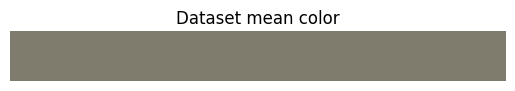

In [164]:
plt.imshow(np.reshape(data_means, ((1,1,3))), aspect=0.1)
plt.title("Dataset mean color")
plt.axis(False)
plt.show()

## Augmentation Settings



### Bounding Box parameters

These were defined above in the global [settings](#settings). One reason because it matched into global setup, secondly, as their definition is used the `CropDataset` class.

When applying augmentation with bounding boxes, it can happen that the bounding boxes get cut or become too small and are then not usable anymore.
Beside defining which bounding box format we use; we also define a `before : after` ratio and a minimum amount of pixels.
One should consider here that if the instance becomes too small too much information is lost and it might not affect the training positively.
On the other hand, ignoring small instances gives less training examples and turns them into background.
As here many small instances do exist the minimum is set quite to 30 pixels.
The idea behind this setting is that we would still like to detect small plants, first as we have many small instances second as especially the weeds are also small to tiny.
For the downstream task of precision spraying as likely in application the resolution will be higher, we can zoom in try a second shot in analyzing this instance.
But for that the model needs to be able to detect these small instances and not label them as background.

---

Sidenote: A helpful tutorial for the implementation of the bounding box augmentations and how the principles work is on [Albumentions.ai](https://albumentations.ai/docs/getting_started/bounding_boxes_augmentation/).



### Image Transformations

There are various augmentations to choose from, feel free to explore.

In [32]:
Idisplay.IFrame(
    src="https://demo.albumentations.ai",
    width = "100%",
    height="600px")

### Augmentation pipeline

Quite common are rotations but it was decided not to use them for two reasons.
In classical object detection there is often a top and bottom.
Here we have a top-down view, a rotation will not yield unnatural looking instances that vary strongly from their natural appearance.
Secondly with rotation we can lose bounding boxes and thereby positive instances, which is one main argument against it.
But the main reason were weak computational capabilities at the beginning, while of course the costs are not high for rotation the cost to benefit ratio felt the lowest. As then later good results were achieved without it, it was not reintroduced.

The only exception are 90° rotations that were used together with flipping which can create multiple variants for one image.
Further variation is done by cropping the image but in a way that keeps all bounding boxes.
There are quite a few negative examples in the dataset without any bounding boxes and as many as possible shall be kept, therefore.

Grayscale is used to prevent the model from learning to easily that green -> plant and focuses more on secondary feature extraction.
The same argument for color jitter, a stronger jitter from about 0.1 was used but produces worse results, likewise did image inversion.
Slightly increasing it showed neither benefit nor drawbacks.
The parameters for the colorjitter are taken from the [official implementation](https://github.com/WongKinYiu/yolov7/blob/711a16ba576319930ec59488c604f61afd532d5a/data/hyp.scratch.custom.yaml) and were probably carefully chosen.



In [262]:
augmentation_pipeline = A.Compose([
    # Make size compatible with YOLO network
    # if STACK_2IMAGES is set this is ignored as images have correct size already from data loader
    *([A.LongestMaxSize(max(IMAGE_SIZE)),
      A.PadIfNeeded(IMAGE_SIZE[0], # height
                  IMAGE_SIZE[1], # width
                  border_mode=0,         # here we could mirror -> but bounding boxes are not clones
                    
                   value=data_means, # using mean of dataset ~roughly grey
                    )
      ] if not STACK_2IMAGES else ()),
    # Transforms without increasing hardness of the task
    A.RandomRotate90(),
    A.Flip(p=0.5),
    # Color augmentations
    # grayscale or color
    # Recommended Jitter Augmentation parameters taken from:
    # https://github.com/WongKinYiu/yolov7/blob/711a16ba576319930ec59488c604f61afd532d5a/data/hyp.scratch.custom.yaml
    A.OneOf([A.ToGray(p=2), 
             A.Sequential([A.ColorJitter(p=1.0, 
                             brightness=(0.6, 1.4), 
                             contrast=(0.8, 1.2), 
                             saturation=(0.7, 1.3), 
                             hue=(-0.015, 0.015)), 
                           #A.InvertImg(p=0.2)
                          ], 
                          p=8
               )],
            p=0.75
    ),
    
    # Cropping 
    # As this zooms in on the picture this might make training easier
    # therefore keeping probability low
    # on the other hand aspect ratio gets a bit worse,
    A.RandomSizedBBoxSafeCrop(*IMAGE_SIZE, p=0.15),
    # Distortion
    *((transform_normalizer,) if NORMALIZE_IMAGES else ()),
    # To Tensort
    ToTensorV2()
], bbox_params=BBOX_PARAMS)

### Test augmentations and data loader

In [263]:
data_train, data_val, data_test = CropAndWeedDataModule(DATASET, DATA_PATH, train_transform=augmentation_pipeline, test_transform=no_transform, batch_size=5, num_workers=0, stack2_images=STACK_2IMAGES).check_dataloaders()

In [264]:
# train dataset without shuffeling
dataset_dev = CropDataset(DATA_PATH, dataset=DATASET, stage="train", target_transform=no_transform, 
                          stack2_images=True)
data_dev = DataLoader(dataset_dev, batch_size=3, num_workers=0, collate_fn=CropDataset.bbox_collate, shuffle=False) # small dataloader for experiments

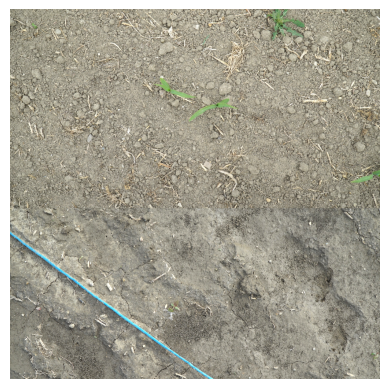

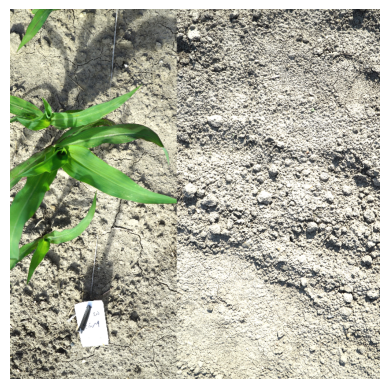

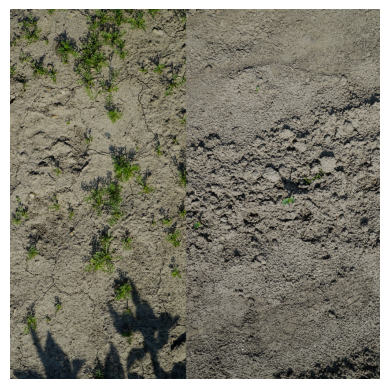

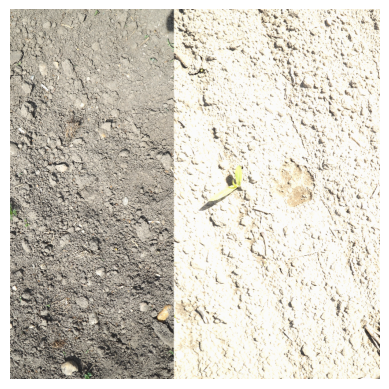

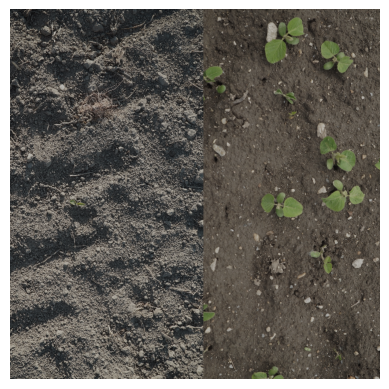

In [276]:
%matplotlib inline
def plot_some_images(): # a function is used to keep the globals clear and the memory free
    images, labels, image_id, image_size = next(iter(data_train))
    #print(image_id)
    images2, labels2, image_id2, image_size2 = next(iter(data_val))
    reload(utils)

    bboxes  = labels[:, 2:]
    bboxes2 = labels2[:, 2:]
    for IDX in range(min(len(images), 5)):
        if NORMALIZE_IMAGES:
            # This will need some manual tweaks to still see an image
            from matplotlib.colors import Normalize
            image = images[IDX]
            normer = Normalize(images[IDX].min(), images[IDX].max())
            image = normer(images[IDX].permute(2,1,0))
            plt.imshow(image)
            del image
        else:
            plt.imshow(images[IDX].permute(2,1,0))
        plt.axis(False)
        plt.show()
        #utils.plot_masked_image(images[1], None, bboxes[labels[:,0]==1], 
        #                        bbox_colors=[(0,0,0)] *sum(labels[:,0]==1), 
        #                        bbox_format="yolo")
        #plt.show()
        #utils.plot_masked_image(images2[1], None, bboxes2[labels2[:,0]==1], 
        #                        bbox_colors=[(0,0,0)] *sum(labels2[:,0]==1), 
        #                        bbox_format="yolo")
        #plt.show()
        #del image
        
plot_some_images()

In [268]:
# Use case for the image_id
data_train.dataset.images[image_id]

array(['/scratch/slurm_tmpdir/job_22032970/data/images/ave-0189-0008.jpg',
       '/scratch/slurm_tmpdir/job_22032970/data/images/vwg-1254-0013.jpg',
       '/scratch/slurm_tmpdir/job_22032970/data/images/vwg-1229-0003.jpg',
       '/scratch/slurm_tmpdir/job_22032970/data/images/ave-0083-0009.jpg',
       '/scratch/slurm_tmpdir/job_22032970/data/images/ave-0228-0009.jpg'],
      dtype='<U64')

# Model Class<a id='Model Class'></a>
[to the top](#top)

Here we build the model class as a [PyTorch Lightning module](https://pytorch-lightning.readthedocs.io/en/latest/common/lightning_module.html).
We declare what has to happen during training for the backpropagation to work, while not handling it explicitly, and log important results during all phases.

## Using YOLOv7





In [172]:
#from ultralytics.yolo.utils.loss import BboxLoss
from yolov7 import create_yolov7_model, create_yolov7_loss
from yolov7.trainer import filter_eval_predictions
from yolov7.models.yolo import Yolov7Model

from torch.optim.lr_scheduler import CosineAnnealingLR, MultiStepLR, ChainedScheduler, ReduceLROnPlateau, SequentialLR, OneCycleLR

from torchmetrics.detection.mean_ap import MeanAveragePrecision

class YOLO_PL(pl.LightningModule):
    
    #criterion = DetectionTrainer.criterion
    #postprocess = Yolov7Model.postprocessing
    
    def __init__(self, settings):
        super().__init__()
        # v8
        #self.yolo_model = YOLO(yolo_model, task="detect")
        #self.yolo_model.overrides = {} # default
        #self.yolo_model([*np.zeros((2, 1088, 1920))]) # init some stuff
        #self.model = self.yolo_model.model
        assert 0 <= settings["dataset"]["use_extra_class"] <= 1, "No or only one extra class can be used."
        assert settings["dataset"]["image_size"][0] == settings["dataset"]["image_size"][1], "Image size must be a square."
        
        self.settings=settings
        self.example_input_array = torch.FloatTensor((np.zeros((1, 3, *IMAGE_SIZE))))
        
        try:
            self.model = create_yolov7_model(settings["model"]["name"], 
                                             num_classes=( len( DATASETS[settings["dataset"]["name"]].get_label_ids() ) 
                                                          + settings["dataset"]["use_extra_class"]), 
                                             pretrained=settings["model"]["pretrained"])
        except AttributeError:
            self.model = create_yolov7_model(settings["model"]["name"], 
                                             num_classes=( len( DATASETS[settings["dataset"]["name"]].get_label_ids() ) 
                                                          + settings["dataset"]["use_extra_class"]), 
                                             pretrained=settings["model"]["pretrained"])
        
        self.loss_func = create_yolov7_loss(self.model, 
                                            image_size=max(IMAGE_SIZE),
                                            **self.settings["loss"])
        size = max(settings["dataset"]["image_size"])
        self.image_size=(size, size)
        # Maybe adjust this because predifined turns into xyxy
        self.mAP = MeanAveragePrecision(box_format="cxcywh", iou_type="bbox", class_metrics=False,
                                       iou_thresholds=[settings["mAP"]["iou_threshold"]],
                                       rec_thresholds=settings["mAP"].get("rec_thresholds",None))  # Single IoU threshold)
        self.test_mAP = MeanAveragePrecision(box_format="cxcywh", 
                                             iou_type="bbox", 
                                             class_metrics=True)
        

        self.save_hyperparameters()
        
    def forward(self, x):
        return self.model(x)
    
    def on_fit_start(self):
        self.loss_func.to(self.device)
        print("Fitting", self.settings["model"]["name"], "on", self.settings["dataset"]["name"], settings["dataset"]["image_size"])
    
    def on_eval_start(self):
        self.loss_func.to(self.device)
    
    def on_train_epoch_start(self):
        self.loss_func.train()
        
    def on_validation_epoch_start(self):
        self.loss_func.eval()
        
    def training_step(self, batch, _):
        images, labels, image_id, image_size = batch
        preds = self.model(images)
        loss, _ = self.loss_func(
            fpn_heads_outputs=preds, targets=labels, images=images
        )
        self.log("train_loss", loss, prog_bar=True, batch_size=images.shape[0])
        return loss
    
        
    def update_map(self, labels, preds, map):
        filtered_preds : list = self.model.postprocess(preds, 
                                        conf_thres=self.settings["mAP"]["min_confidence"],  # TODO conf thresholds should be same?
                                        max_detections= self.settings["mAP"]["max_detections"],
                                        multiple_labels_per_box=False)
        
        target_lists = [{"boxes"  : labels[(idx := labels[:,0]==i), 2:],
                         "labels" : labels[idx, 1]} for i in range(len(filtered_preds))]
        pred_lists = [None] * len(filtered_preds)
        for i, pred in enumerate(filtered_preds): # len of batch_size
            pred = pred[pred[:, 4] > self.settings["mAP"]["nms_threshold"]].detach()
        
            nms_idx = torchvision.ops.batched_nms(
                boxes =pred[:, :4],
                scores=pred[:, 4],
                idxs  =pred[:, 5],
                iou_threshold=self.settings["mAP"]["iou_threshold"]#self.settings["mAP"]["iou_threshold"],
            )
            nms_preds = pred[nms_idx]
            boxes = torchvision.ops.box_convert(
                nms_preds[:, :4], "xyxy", "cxcywh" # ughhh, is transformed in preprocess, maybe convert these others
            )
            boxes[:, [1, 3]] /= IMAGE_SIZE[0]  # normalized height 0-1
            boxes[:, [0, 2]] /= IMAGE_SIZE[1]  # normalized width 0-1
            pred_lists[i]={"boxes"  : boxes,
                          "scores" : nms_preds[:, 4],
                          "labels" : nms_preds[:, 5]}
            #pred_list=[{"boxes"  : boxes,
            #  "scores" : nms_preds[:, 4],
            #  "labels" : nms_preds[:, 5]}]
            #map.update(pred_list, target_lists[i:i+1])
        map.update(pred_lists, target_lists) # do not use forward else will compute & return

    # Has the form    
    """
    {'map': tensor(0.6000),
     'map_50': tensor(1.),
     'map_75': tensor(1.),
     'map_large': tensor(0.6000),
     'map_medium': tensor(-1.),
     'map_per_class': tensor(-1.),
     'map_small': tensor(-1.),
     'mar_1': tensor(0.6000),
     'mar_10': tensor(0.6000),
     'mar_100': tensor(0.6000),
     'mar_100_per_class': tensor(-1.),
     'mar_large': tensor(0.6000),
     'mar_medium': tensor(-1.),
     'mar_small': tensor(-1.)}
    """
    
    def validation_step(self, batch, batch_idx):
        images, labels, image_id, image_size = batch
        preds = self.model(images)
        loss, _ = self.loss_func(
            fpn_heads_outputs=preds, targets=labels, images=images
        ) 
        self.log("val_loss", loss, prog_bar=True, batch_size=len(images))
    
        if False and batch_idx == 0:
            # plot 10 bounding boxes with highest confidence
            # TODO. improve by making grid of 4 images
            figures = []
            IDX=1
            pred = self.model.postprocess(preds, conf_thres=0.00, 
                                                      max_detections=10, 
                                                      multiple_labels_per_box=False)[IDX].cpu() 
            
            # get the 10 bounding boxes with highest confidence
            bboxes =pred[:, :4]
            scores=pred[:, 4]
            idxs  =pred[:, 5]
            # annotate with label and confidence
            img = np.ascontiguousarray(images[IDX].permute(1,2,0).cpu())
            for bbox, score, id in zip(bboxes, scores, idxs):
                img = visualize_bbox(img, bbox, f"{id.item()} : {score.item():.4%}", (255,0,0), bbox_format="pascal_voc")
            
            #print(img.shape, img.dtype, bbox)
            img = cv2.resize(img, (256,256))
            img *= 255
            self.logger.experiment.add_image('val_bboxes', img.astype(np.uint8), self.current_epoch, 
                                            dataformats='HWC')
        self.update_map(labels, preds, self.mAP)
        return loss
    
    def test_step(self, batch, batch_idx):
        images, labels, image_id, image_size = batch
        preds = self.model(images)
        loss, _ = self.loss_func(
            fpn_heads_outputs=preds, targets=labels, images=images
        ) 
        self.log("test_loss", loss, prog_bar=True, batch_size=len(images))
        self.update_map(labels, preds, self.test_mAP)
    
    # See: https://torchmetrics.readthedocs.io/en/latest/pages/lightning.html
    def on_validation_epoch_end(self):
        #print("computing map-val", self.current_epoch)
        results = self.mAP.compute()
        self.mAP.reset()
        #print("logging-val")
        self.log("hp_metric", results["map"])
        self.log("map", results.pop("map"), prog_bar=True)
        self.log_dict(results)
    
    def on_test_epoch_end(self):
        results = self.test_mAP.compute()
        map_per_class = results.pop('map_per_class')
        mar_per_class = results.pop('mar_100_per_class')
        if self.test_mAP.class_metrics:
            # Not one element tensors
            names = list(map(DATASETS[DATASET].get_label_name, self.test_mAP._get_classes()))
            for i, name in enumerate(names):
                self.log(f"test_map_{name}", map_per_class[i])
                self.log(f"test_mar100_{name}", mar_per_class[i])
                print(f"test_map_{name}", map_per_class[i], f"\ntest_mar100_{name}", mar_per_class[i])
        else:
            print("not logging class metrics")
        self.log_dict({"test_"+key:val for key,val in results.items()})
        self.test_mAP.reset()

    def configure_optimizers(self):
        # Here the opimizers are set up, currently some more options for other optimizers should be build into.
        if self.settings["optimizer"]["weight_decay"] == "auto":
            # setup for the automatic calculation taken from
            # https://github.com/Chris-hughes10/Yolov7-training/blob/51336ebdc8c7ecc1e9c3d79832623d969605ba98/examples/train_cars.py
            self.settings["dataset"]["accumulate_batch_size"]
            num_accumulate_steps = max(round(self.settings["dataset"]["accumulate_batch_size"] 
                                             / self.settings["dataset"]["batch_size"])
                                       , 1)
            base_weight_decay = 0.0005
            weight_decay = (
                base_weight_decay 
                * self.settings["dataset"]["batch_size"] 
                * num_accumulate_steps 
                / self.settings["dataset"]["accumulate_batch_size"] 
            )
            self.settings["optimizer"]["weight_decay"] = weight_decay
            print("Auto: weight decay set to", weight_decay)
        
        param_groups=self.model.get_parameter_groups()
        optimizer = torch.optim.SGD(
           param_groups["other_params"], 
            lr=self.settings["optimizer"]["learning_rate"], 
            momentum=0.937, nesterov=True,
        )
        optimizer.add_param_group(
            {"params": param_groups["conv_weights"], 
             "weight_decay": self.settings["optimizer"]["weight_decay"]}
        )
        
        #"""
        #optimizer = torch.optim.RAdam(self.parameters(),
        #                              lr=(self.settings["optimizer"]["learning_rate"]
        #                                  * ((1/self.settings["lr_scheduler"]["warmup_multiplier"]
        #                                      )** self.settings["lr_scheduler"]["warmup_epochs"])), # scale down for warmup
        #                              eps=1e-08, 
        #                              betas= (0.937, 0.999),
        #                              weight_decay=self.settings["optimizer"]["weight_decay"])
        #"""
        
        #lr_scheduler = CosineLrScheduler(optimizer,
        #    total_num_epochs=trainer.max_epochs,
        #    num_update_steps_per_epoch = num_batches,
        #    num_warmup_epochs=3,
        #    num_cooldown_epochs=3,
        #    k_decay=2,
        #)


        if self.settings["optimizer"].get("lr_scheduler", "").lower() == "onecyclelr":
            print("Using OneCycleLR scheduler")
            lr_scheduler = OneCycleLR(optimizer, 
                                      max_lr=self.settings["optimizer"]["learning_rate"],
                                      total_steps=self.trainer.estimated_stepping_batches,
                                      base_momentum = self.settings["lr_onecycle"]["base_momentum"],
                                      max_momentum = self.settings["lr_onecycle"]["max_momentum"],
                                      pct_start= self.settings["lr_onecycle"]["pct_start"],
                                      div_factor=self.settings["lr_onecycle"]["div_factor"], 
                                      final_div_factor=self.settings["lr_onecycle"]["final_div_factor"],
                                     )
            return [optimizer], [{"scheduler": lr_scheduler, "interval": "step"}]

        print("Using Multistep+CosineAnnealingLR scheduler")
        # A more handcraftes learning rate regime, while it yieled good results it was more difficult
        # to finetune and to port to other model sizes.
        scheduler1 = MultiStepLR(optimizer, 
                             milestones=list(range(1, self.settings["lr_scheduler"]["warmup_epochs"]+1)), 
                             gamma=self.settings["lr_scheduler"]["warmup_multiplier"]) # warmup
        scheduler2 = MultiStepLR(optimizer,
                                 milestones=self.settings["lr_scheduler"]["milestones"], 
                                 gamma=self.settings["lr_scheduler"]["milestone_multiplier"]) # warmup
        scheduler3 = CosineAnnealingLR(optimizer, 
                                       self.trainer.max_epochs, 
                                       eta_min=0, 
                                       last_epoch=-1)
        lr_scheduler = ChainedScheduler([scheduler1, scheduler2, scheduler3])
        return [optimizer], [lr_scheduler]
    

    

## Model and Training settings<a id='settings'></a>
[to the top](#top)  
[to training](#training)  
[to hyperparameter optimization](#hopt)  

Here the whole training setup, beside the dataset, is defined. Tuning the loss should be done carefully.

These settings are additionally defined here as these can be adjusted to start a new experiment right away with the same data setup.


In [173]:
MAX_EPOCHS = 20
OVERFIT_BATCHES = 0

model_params = {"name" : "yolov7-tiny",
                "pretrained" : True,
                "freeze" : False}

# keys are epochs before unfreeze will happen
# values the the N last layers to unfreeze
# NOTE: This depends on the choosen model structure
# NOTE2: (For Yolov5) there is an experiment:
# https://github.com/ultralytics/yolov5/issues/1314
if model_params["name"] == "yolov7":
    transfer_strategy = {0 : 0}


if model_params["name"] == "yolov7-tiny" and model_params["pretrained"]:
    print("yolov7-tiny cannot be pretrained. Setting pretrained=False")
    model_params["pretrained"] = False

# different architectures have slightly different recommended settings
# see https://github.com/WongKinYiu/yolov7/blob/711a16ba576319930ec59488c604f61afd532d5a/data/hyp.scratch.tiny.
# tuning the loss can help to improve the results
loss_params = {  "box_loss_weight" : 0.05,# default: 0.05 # increase if bounding boxes are bad
                 "cls_loss_weight" : 0.5, # default: 0.3  
                 "obj_loss_weight" : 1.0, # default: 0.7  # increase if too many empty boxes are predicted
                 "ota_loss"        : True}# True


optimizer_params = {
    "name" : "SGD",
    "learning_rate" : 0.02,  # Recommended: # initial learning rate (SGD=1E-2, Adam=1E-3)
    "weight_decay" : 5e-4,   # Recommended 5e-4: for accumulating batches "auto" be used
    "lr_scheduler" : "OneCycleLR",
}


# scales down learning_rate by mult**epochs
#  use < 1 to scale it up and increase the initial learning rate
lr_scheduler_params = { "warmup_epochs"      : 1,      
                        "warmup_multiplier"  : 0.2,     
                        "milestones"      : [40, 50],
                        "milestone_multiplier" : 0.1}

lr_onecycle_params = {'max_lr' : optimizer_params["learning_rate"],
                      'pct_start'     : 0.20,
                      'base_momentum' : 0.80, # recommended 0.80, default 0.85
                      'max_momentum'  : 0.937,  # recommended 0.937, default 0.95
                      'div_factor'    : 15.0,   # recommended 25 
                      'final_div_factor' : 6500.0}

dataset_params = {"name" : DATASET,
                  "batch_size" : BATCH_SIZE,
                  "accumulate_batch_size" : 1, #ACCUMULATE_BATCH_SIZE,
                   "use_extra_class": 0,     # Use vegetation for Eval BUGGED
                   "image_size" : IMAGE_SIZE, # After rescaling, cropping
                   'stack2_images' : STACK_2IMAGES,
                   'seed' : SEED,
                   #"transformation" :
                  }

# This does not influence performance but which boxes
# are filtered and passed to the mAP calculation
# NOTE: With heigher weight decay the confidence increases but not their actual correctness!
# NOTE2: These values are used during mAP validation phase, optimized to be fast, 
#        bad settings + many (bad) predictions can hold up the validation for a very very long time.
#        For testing the standardised settings are used currently.
mean_avg_precision_settings = {"min_confidence" : 0.02, # filters out bounding boxes with less confidence
                               "nms_threshold"  : 0.02,  # kind of the same just in a later stage
                               # This is used for nms and filtering will also be the for mAP calculation in validation
                               # https://torchmetrics.readthedocs.io/en/stable/detection/mean_average_precision.html
                               "iou_threshold"  : 0.7,
                               # Performance will be bad if there are many detections per image combined with many thresholds
                               "max_detections" : 150, # after min_confidence, keep those with highest confidence
                               # Recall thresholds for Validation
                               #"rec_thresholds" : np.arange(0.5, 1.0, 0.1).tolist()
                              }


# https://pytorch-lightning.readthedocs.io/en/stable/advanced/model_parallel.html#deepspeed-zero-stage-1
trainer_settings = {"max_epochs" : MAX_EPOCHS,
                    "strategy"   : "auto" #DeepSpeedStrategy(offload_optimizer=True, allgather_bucket_size=5e8, reduce_bucket_size=5e8) \
                                     if torch.cuda.is_available() else "auto"
                    }


settings = {"model" : model_params,
            "optimizer" : optimizer_params,
            "lr_scheduler" : lr_scheduler_params,
            "lr_onecycle"  : lr_onecycle_params,
            "loss" : loss_params,
            "dataset" : dataset_params,
            "mAP" : mean_avg_precision_settings,
            "trainer" : trainer_settings}



yolov7-tiny cannot be pretrained. Setting pretrained=False


# Excursion: YOLO's Single shot detection and evaluation of anchor settings

<p style="text-align: center;">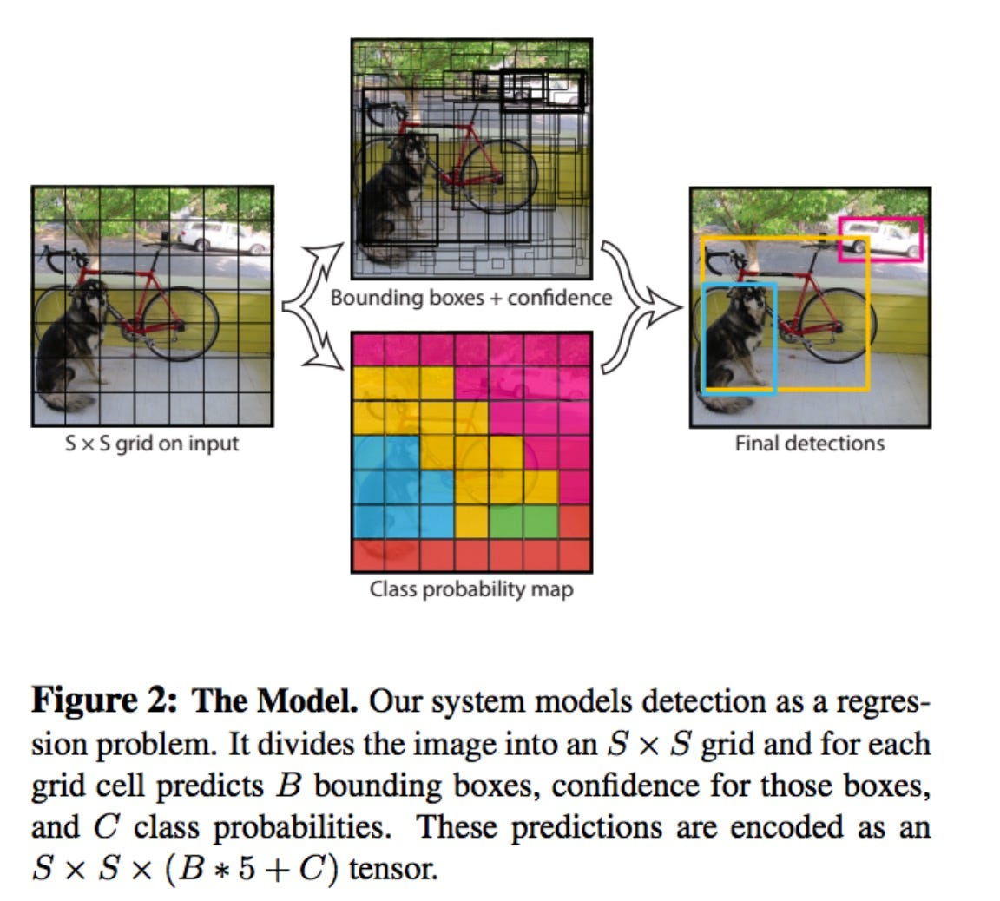<br>
Image extracted from 
<a href="">[Redmon et al. 2016]</a>.

As a short explanation about the anchor idea behind the YOLO models and how the predictions work.

Multi shot object detection networks can rely often on region proposals.
First a region is suggested where an object could be.
Then it is checked what object class is contained in that region or if it is actually background with higher confidence, as a high recall is important for the first step.  
YOLO as single shot detection network does not use region proposals in that sense, it uses a predefined set of possible regions.
For that the image is partitioned into a grid of many small boxes (not the bounding boxes). 
The anchor bounding boxes are a small preset of possible bounding boxes.
Each grid cell is associated with anchor bounding boxes and associated with a class probability (see extracted Figure 2 above.)
The resulting bounding box predictions are deferments from the anchor bounding boxes and associated with an objectness score, the confidence that they contain an object.
During training a fitness score of the anchor bounding boxes with the true bounding boxes is calculated which are a part of the backpropagation [[Olga Chernytska, 2022]](https://towardsdatascience.com/training-yolo-select-anchor-boxes-like-this-3226cb8d7f0b).
    
---
  
A nice and short guide taken as additional reference here by [Olga Chernytska (2022)](https://towardsdatascience.com/training-yolo-select-anchor-boxes-like-this-3226cb8d7f0b)    
    
The inspiration and used helper libraries come from [Chris Hughes (2022)](https://towardsdatascience.com/yolov7-a-deep-dive-into-the-current-state-of-the-art-for-object-detection-ce3ffedeeaeb#5f58), likewise his implementation to evolve the anchors.
    
The original implementation for YOLOv5 can be found on [Github](https://github.com/ultralytics/yolov5/blob/master/utils/autoanchor.py).

---

In [174]:
#EVALUATE_ANCHORS=True 

In [153]:
# This cell produces no Output
if EVALUATE_ANCHORS or CALCULATE_BASELINE:
    """
    Some pretasks necessary for the evaluations
    This calculated the sizes of the bounding boxes in relation the image size.
    """
    from yolov7.anchors import calculate_resized_gt_wh
    
    train_bboxes = dataset_dev.get_all_bboxes() # get all boxes as a list #<-- these are the training data
    train_bboxes = np.vstack(train_bboxes)
    
    # Get widths and heights of the bounding boxes
    widths = (train_bboxes[:,2] - train_bboxes[:,0]).reshape((-1, 1))
    heights = (train_bboxes[:,3] - train_bboxes[:,1]).reshape((-1, 1))
    true_bounding_boxes = np.hstack((widths, heights))
    
    # Turn from absolute sizes to relative of image size
    # removes very small bounding boxes when sclaing down from original 1980x1088 to IMAGE_SIZE
    resized_wh = calculate_resized_gt_wh(np.hstack((widths, heights)), 
                                         np.array((1980, 1088)).reshape((1,2)),  # original image size #NOTE: HARDCODED
                                         target_image_size=IMAGE_SIZE[0]) 
    # Class counts
    all_labels = train_bboxes[:,4]
    label_counts = np.unique(all_labels, return_counts=True)
    majority_label = label_counts[0][np.argmax(label_counts[1])]
   

### Best possible recall of anchors

Now we evaluate if the current anchor boxes of a model can capture the ground truth bounding boxes of the training dataset.
We will just use the preset function which calculates us the recall as the mean of boolean values which indicate if a sample can be matched or not.
See the above references for more in depth details.

In [155]:
if EVALUATE_ANCHORS:
    from yolov7.anchors import calculate_best_possible_recall
    evals = {}
    for modelname in ["yolov7-tiny", "yolov7", "yolov7x", "yolov7-w6", "yolov7-d6", "yolov7-e6", "yolov7-e6e"]:
        for i in range(2):
            try:
                pre_model = create_yolov7_model(modelname, 
                                                 num_classes=( len( DATASETS[settings["dataset"]["name"]].get_label_ids() ) 
                                                              + settings["dataset"]["use_extra_class"]), 
                                                 pretrained=False)
            except AttributeError:
                if i == 1:
                    raise
        current_anchors = pre_model.detection_head.anchor_grid.clone().view(-1, 2)
        if modelname in ("yolov7-tiny", "yolov7-w6"): # border from small to high
            resized_wh = calculate_resized_gt_wh(true_bounding_boxes, 
                                         np.array((1980, 1088)).reshape((1,2)),  # original image size #NOTE: HARDCODED
                                         target_image_size=640 if modelname in ("yolov7-tiny", "yolov7", "yolov7x") else 1280) 
        print(recall := calculate_best_possible_recall(current_anchors, resized_wh))
        evals[modelname] = recall.item()

    print("Best possible recall of the architectures")
    display(evals)

## Adjust anchors

The anchors can be adjusted to better fit the training set at hand. Again for more details I refer to the references stated above.
But as quick explanation a genetic algorithm will evolve the anchor bounding boxes with the goal the maximize the fitness score, which also maximized the recall.

This step is currently skipped as the recall is already quite high.
For further information see the [discussion section](#future:anchor-adjustment).

In [178]:
if CALCULATE_NEW_ANCHORS:
    # Define function to keep the global variables clear
    def calculate_new_anchors(overwrite_existing_ones=False):
        from yolov7.anchors import calculate_anchors, anchor_fitness
        anchor_updates = {}
        for modelname in ["yolov7-tiny", "yolov7", "yolov7x", "yolov7-w6", "yolov7-d6", "yolov7-e6", "yolov7-e6e"]:
            print(modelname)
            pre_model = create_yolov7_model(modelname, 
                                             num_classes=( len( DATASETS[settings["dataset"]["name"]].get_label_ids() ) 
                                                          + settings["dataset"]["use_extra_class"]), 
                                             pretrained=False)
            current_anchors = pre_model.detection_head.anchor_grid.clone().view(-1, 2)
            if modelname in ("yolov7-tiny", "yolov7-w6"):
                resized_wh = calculate_resized_gt_wh(true_bounding_boxes, 
                                             np.array((1980, 1088)).reshape((1,2)),  # original image size #NOTE: HARDCODED
                                             target_image_size=640 if modelname in ("yolov7-tiny", "yolov7", "yolov7x") else 1280) 

            new_anchors = calculate_anchors(current_anchors.clone(), np.array((1980, 1088)).reshape((1,2)), 
                                            true_bounding_boxes, 
                                            target_image_size=640 if modelname in ("yolov7-tiny", "yolov7", "yolov7x") else 1280 ,
                                            best_possible_recall_threshold=0.999)
            print()
            print("recall: ", calculate_best_possible_recall(current_anchors, resized_wh),
                  "->", calculate_best_possible_recall(new_anchors, resized_wh))
            print("fitness:",  anchor_fitness(current_anchors, resized_wh), "->", anchor_fitness(new_anchors, resized_wh))
            anchor_updates[modelname] = new_anchors
            if overwrite_existing_ones:
                torch.save(new_anchors, f"new_anchors_{modelname}.pt")

    calculate_new_anchors()

# Baseline

A straightforward but relative high baseline idea for the mean average precision (mAP) is to predict the majority class with a `confidence of count(majority_class) / count(bounding_boxes)` or alternatively with 100% confidence and a perfect prediction of the true bounding boxes.
As it is very likely that during evaluation more bounding boxes with looser areas will be predicted this is a very high baseline.

In [179]:
if EVALUATE_ANCHORS:
    def create_baseline():
        map_baseline = MeanAveragePrecision(box_format="cxcywh", iou_type="bbox", class_metrics=False,
                                               iou_thresholds=[settings["mAP"]["iou_threshold"]],
                                               rec_thresholds=settings["mAP"].get("rec_thresholds",None))
        # Note this can be speed up by using a dataloader with a higher batch size
        for batch in tqdm(data_val):
            images, labels, _, _ = batch
            true_labels = labels[:,1]
            bboxes = labels[:,2:]
            pred_lists=[{"boxes"  : (imboxes := bboxes[labels[:,0] == i]),  # ground truth bounding boxes
                       "scores" : torch.full((len(imboxes),), max(label_counts[1]) / len(all_labels)),     # confidence scores
                       "labels" : torch.full((len(imboxes),), majority_label)} for i in range(len(images)) # majority class
                       ]
            target_lists = [{"boxes"  : labels[ (idx := labels[:,0] == i) , 2:],
                             "labels" : labels[idx, 1]} for i in range(len(images))]
            map_baseline.update(pred_lists, target_lists) # do not use forward else will compute & return
        print("Baseline", map_baseline.compute())
        
    create_baseline()

In [ ]:
print("Baseline", """{'map': tensor(0.3653),
 'map_50': tensor(-1),
 'map_75': tensor(-1),
 'map_small': tensor(0.3653),
 'map_medium': tensor(-1.),
 'map_large': tensor(-1.),
 'mar_1': tensor(0.0424),
 'mar_10': tensor(0.2822),
 'mar_100': tensor(0.4928),
 'mar_small': tensor(0.4928),
 'mar_medium': tensor(-1.),
 'mar_large': tensor(-1.),
 'map_per_class': tensor(-1.),
 'mar_100_per_class': tensor(-1.)}""")

# Training

### Overfit on batches

Sanity check if model has the potential to learn with the current settings.
Yet this does not seem to work for the YOLO model at hand here at least not with augmentation enabled, while the loss decreases the mean average precision does not increase in a reasonable way that would indicate that the training does indeed work - even if it does work under normal settings.


In [ ]:
#pl_model = YOLO_PL.load_from_checkpoint(r"./models/dev_map_epoch=7_lr=0-Copy1.0015_batch=8_val_loss=1.005_map=0.112.ckpt", settings=settings)
if OVERFIT_BATCHES:
    def overfit_batch():
        data = CropAndWeedDataModule(DATASET, DATA_PATH, batch_size=64, 
                                              num_workers=2, 
                                              train_transform=no_transform, #augmentation_pipeline, # try with and without
                                              test_transform=no_transform,
                                              stack2_images=True) # try with and without.

        data_eval = CropAndWeedDataModule(DATASET, DATA_PATH, batch_size=64, 
                                          num_workers=1, 
                                          train_transform=no_transform, # <-- no augmentations
                                          test_transform=no_transform,
                                          stack2_images=False)

        tensor_logger  = pl.loggers.TensorBoardLogger("./lightning_logs", 
                                                      name="overfit_batch",
                                                      default_hp_metric=False) # cant get this to work

        trainer = Trainer(  
            max_steps=200,
            accelerator="auto",
            devices=1 if torch.cuda.is_available() else None,  # limiting got iPython runs
            overfit_batches=1,  # <-----
            num_sanity_val_steps=0,
            check_val_every_n_epoch=5,
            log_every_n_steps=5,
            logger=[tensor_logger],
            callbacks=[pl.callbacks.LearningRateMonitor(logging_interval='step')],
            #precision=16,
            #track_grad_norm=2,
            accumulate_grad_batches=1, #settings["dataset"]["accumulate_batch_size"],
            strategy=trainer_settings["strategy"],
        )

        test_model = YOLO_PL(settings)
        test_model.to(device)

        data.setup()
        data_eval.setup()
        trainer.fit(test_model, data.train_dataloader(), data_eval.train_dataloader())
        del data_eval
        
    overfit_batch()

In [180]:
# try to clean memory
try:
    del test_model
except:
    pass
    
import gc
gc.collect()
torch.cuda.empty_cache()

Now the trainingof the model and the given settings is performed.
Here is like a breakpoint for the code, running all cells above create the necessary classes and keep the memory consumption as low as possible.
For example when performing hyperparameter optimization it is recommended to skip this next section which creates a persistend model.
But if needed a global model or a dataloader can be loaded here.

### Single Training <a id='training'></a>
[to the top](#top)  
[to the settings](#settings)  
[to hyperparameter optimization](#hopt)  

with the above choosen settings

In [181]:
data = CropAndWeedDataModule(DATASET, DATA_PATH, batch_size=BATCH_SIZE, 
                                      num_workers=NUM_WORKERS, 
                                      stack2_images=True,
                                      train_transform=augmentation_pipeline,
                                      test_transform=no_transform)

### Load the Model (Checkpoint)

Loads the model or loads the weights from a stored checkpoint.

This try...except setup while looking strange it catches a one time error in the yolov7 submodule when it was cloned instead of installed which is the simpler method to get it to run with Windows.

In [182]:
# AttributeError: 'NoneType' object has no attribute 'backend'
#CKPT = r'D:\\OneDrive - Universität Mannheim\\Lectures\\AI in Industry\\Assignments\\1 CropAndWeed detection\\models\\dev_CropsOrWeed9_yolov7-tiny_epoch=0_lr=_batch=8_val_loss=1.285_map=0.042.ckpt'
#CKPT = "workspace/models/CropOrWeed2_640px_yolov7-tiny_epoch=49_lr=_batch=25_val_loss=2.587_map=0.591.ckpt"
CKPT = None
if not CKPT:
    pl_model = YOLO_PL(settings)
else:
    try:
        pl_model = YOLO_PL.load_from_checkpoint(CKPT, settings)
    except FileNotFoundError as e:
         print(e, "\nWARNING: No checkpoint loaded, training from scratch")
         pl_model = YOLO_PL(settings)
    else:
        print("Checkpoint\n", CKPT, "loaded")


In [183]:
try:
    from torchinfo import summary
    print(summary(pl_model.model.model))
except Exception as e:
    print(e)

No module named 'torchinfo'


In [184]:
# Option for a more detailed filename
#filename = settings["dataset"]["name"]+"_"+str(IMAGE_SIZE[0])+"px_"+model_params["name"]+"_{epoch}_lr="\
#                    "_batch="+str(BATCH_SIZE)+"_{val_loss:.3f}_{map:.3f}"

checkpoint_callback = pl.callbacks.ModelCheckpoint(
    #=1,
    dirpath="./models",
    filename="Example" + settings["dataset"]["name"]+"_"+str(IMAGE_SIZE[0])+"px_"+model_params["name"],
    monitor="map",
    mode="max",
    verbose=1,
    save_last=False
)
checkpoint_callback.CHECKPOINT_NAME_LAST = model_params["name"]+"{epoch}-last"

#--------
# Early stopping
# will be used in combination of min_epochs 5 to have a warmup
# but then detect stagnation, from experience this settles between epoch 20-40
# or very early for abd models
early_stop_callback = EarlyStopping(monitor="map", 
                                    min_delta=0.01, 
                                    patience=3, 
                                    verbose=True, 
                                    mode="max")

lr_monitor = pl.callbacks.LearningRateMonitor(logging_interval='epoch')

tensor_logger  = pl.loggers.TensorBoardLogger("./lightning_logs", 
                                              name="Example" + settings["dataset"]["name"]+"_"+str(IMAGE_SIZE[0])+"px_"+model_params["name"],
                                              #["dataset"]["name"]+"_"+str(IMAGE_SIZE[0])+"px_"+model_params["name"]+f"max_epochs={MAX_EPOCHS}",
                                              default_hp_metric=True,
                                              log_graph=False) 

#fit_csv_logger = pl.loggers.CSVLogger("./lightning_logs", name='dev_fit', version=None, prefix='')

trainer = Trainer(  
    max_epochs=MAX_EPOCHS,
    min_epochs=5,  # as the first 4 epochs can be quite slow, prevent early stopping from kicking in
    #max_steps=7000,
    accelerator="auto",
    devices=1 if torch.cuda.is_available() else None,  # limiting got iPython runs
    callbacks=[checkpoint_callback, 
               lr_monitor,
               early_stop_callback
    ],
    logger=[tensor_logger], # add fit_logger
    fast_dev_run=False,
    precision=32,
    #track_grad_norm=2,
    #accumulate_grad_batches=max(1, 32//BATCH_SIZE),
    #strategy=trainer_settings["strategy"],
    #num_sanity_val_steps=0,
    #val_check_interval=0,
)



/pfs/data5/home/ma/ma_ma/ma_dsperber/torchenv/lib64/python3.9/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /opt/bwhpc/common/jupyter/tensorflow/2023-03-24/lib/ ...
  rank_zero_warn(
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


#### Train the  model

In [62]:
#trainer.fit(pl_model, data, , ckpt_path=CKPT # Resume from a checkpoint

trainer.fit(pl_model, data)

/pfs/data5/home/ma/ma_ma/ma_dsperber/torchenv/lib64/python3.9/site-packages/lightning_fabric/plugins/environments/slurm.py:165: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /opt/bwhpc/common/jupyter/tensorflow/2023-03-24/lib/ ...
  rank_zero_warn(
Missing logger folder: ./lightning_logs/ExampleCropOrWeed2_640px_yolov7-tiny
/pfs/data5/home/ma/ma_ma/ma_dsperber/torchenv/lib64/python3.9/site-packages/pytorch_lightning/callbacks/model_checkpoint.py:612: UserWarning: Checkpoint directory /pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models exists and is not empty.
  rank_zero_warn(f"Checkpoint directory {dirpath} exists and is not empty.")


Data path already exists. Skipping download and mask generation. No integrity check was performed.


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
Loading `train_dataloader` to estimate number of stepping batches.


Using OneCycleLR scheduler



  | Name     | Type                 | Params | In sizes         | Out sizes                                                
---------------------------------------------------------------------------------------------------------------------------------
0 | model    | Yolov7Model          | 6.0 M  | [1, 3, 640, 640] | [[1, 3, 80, 80, 7], [1, 3, 40, 40, 7], [1, 3, 20, 20, 7]]
1 | mAP      | MeanAveragePrecision | 0      | ?                | ?                                                        
2 | test_mAP | MeanAveragePrecision | 0      | ?                | ?                                                        
---------------------------------------------------------------------------------------------------------------------------------
6.0 M     Trainable params
0         Non-trainable params
6.0 M     Total params
24.071    Total estimated model params size (MB)


Fitting yolov7-tiny on CropOrWeed2 (640, 640)


Sanity Checking: 0it [00:00, ?it/s]

/pfs/data5/home/ma/ma_ma/ma_dsperber/torchenv/lib64/python3.9/site-packages/pytorch_lightning/trainer/connectors/logger_connector/result.py:212: UserWarning: You called `self.log('map_50', ...)` in your `on_validation_epoch_end` but the value needs to be floating point. Converting it to torch.float32.
  warning_cache.warn(
/pfs/data5/home/ma/ma_ma/ma_dsperber/torchenv/lib64/python3.9/site-packages/pytorch_lightning/trainer/connectors/logger_connector/result.py:212: UserWarning: You called `self.log('map_75', ...)` in your `on_validation_epoch_end` but the value needs to be floating point. Converting it to torch.float32.
  warning_cache.warn(


Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Metric map improved. New best score: 0.003
Epoch 0, global step 113: 'map' reached 0.00347 (best 0.00347), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Metric map improved by 0.032 >= min_delta = 0.01. New best score: 0.035
Epoch 1, global step 226: 'map' reached 0.03516 (best 0.03516), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Metric map improved by 0.017 >= min_delta = 0.01. New best score: 0.053
Epoch 2, global step 339: 'map' reached 0.05252 (best 0.05252), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Epoch 3, global step 452: 'map' was not in top 1


Validation: 0it [00:00, ?it/s]

Metric map improved by 0.054 >= min_delta = 0.01. New best score: 0.106
Epoch 4, global step 565: 'map' reached 0.10617 (best 0.10617), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Epoch 5, global step 678: 'map' reached 0.10629 (best 0.10629), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Epoch 6, global step 791: 'map' reached 0.10896 (best 0.10896), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Metric map improved by 0.110 >= min_delta = 0.01. New best score: 0.217
Epoch 7, global step 904: 'map' reached 0.21667 (best 0.21667), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1
Epoch 11, global step 1356: 'map' was not in top 1


Validation: 0it [00:00, ?it/s]

Metric map improved by 0.060 >= min_delta = 0.01. New best score: 0.406
Epoch 12, global step 1469: 'map' reached 0.40614 (best 0.40614), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Epoch 13, global step 1582: 'map' was not in top 1


Validation: 0it [00:00, ?it/s]

Metric map improved by 0.027 >= min_delta = 0.01. New best score: 0.433
Epoch 14, global step 1695: 'map' reached 0.43342 (best 0.43342), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Epoch 15, global step 1808: 'map' was not in top 1


Validation: 0it [00:00, ?it/s]

Epoch 16, global step 1921: 'map' reached 0.43798 (best 0.43798), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Metric map improved by 0.023 >= min_delta = 0.01. New best score: 0.457
Epoch 17, global step 2034: 'map' reached 0.45665 (best 0.45665), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Metric map improved by 0.012 >= min_delta = 0.01. New best score: 0.469
Epoch 18, global step 2147: 'map' reached 0.46898 (best 0.46898), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1


Validation: 0it [00:00, ?it/s]

Epoch 19, global step 2260: 'map' reached 0.47655 (best 0.47655), saving model to '/pfs/data5/home/ma/ma_ma/ma_dsperber/CropAndWeedDetection/models/ExampleCropOrWeed2_640px_yolov7-tiny.ckpt' as top 1
`Trainer.fit` stopped: `max_epochs=20` reached.


## First Evaluation

[to training](#training)

Now that the training has finished we can evalute the results.

#### Test the model

In [63]:
# Test a checkpoint file
#trainer.test(pl_model.to(device), data, ckpt_path=CKPT)

# Load weights
pl_model = YOLO_PL.load_from_checkpoint(os.path.join(MODEL_PATH, "ExampleCropOrWeed2_640px_yolov7-tiny.ckpt", settings)

# Test
trainer.test(pl_model, data)

torch.cuda.empty_cache()

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Data path already exists. Skipping download and mask generation. No integrity check was performed.


Testing: 0it [00:00, ?it/s]

test_map_Crop tensor(0.5489) 
test_mar100_Crop tensor(0.6196)
test_map_Weed tensor(0.2774) 
test_mar100_Weed tensor(0.3914)


┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    17.083227157592773     │
│         test_map          │    0.41315245628356934    │
│        test_map_50        │    0.6468879580497742     │
│        test_map_75        │    0.44399699568748474    │
│       test_map_Crop       │    0.5488867163658142     │
│       test_map_Weed       │    0.27741801738739014    │
│      test_map_large       │           -1.0            │
│      test_map_medium      │           -1.0            │
│      test_map_small       │    0.41315245628356934    │
│     test_mar100_Crop      │    0.6195913553237915     │
│     test_mar100_Weed      │    0.39140212535858154    │
│        test_mar_1         │    0.12253172695636749    │
│        test_mar_10        │     0.429344117641449     │
│       test_mar_100        │    0.5054967999458313     │
│      test_mar_large       │           -1.0            │
│      test_mar_medium      │           -1.0            │
│      test_mar_small       │    0.5054967999458313     │
└───────────────────────────┴───────────────────────────┘

This should produce this output:
<pre>test_map_Crop tensor(0.5489) 
test_mar100_Crop tensor(0.6196)
test_map_Weed tensor(0.2774) 
test_mar100_Weed tensor(0.3914)
</pre></div><div class="lm-Widget p-Widget jp-RenderedHTMLCommon jp-RenderedHTML jp-mod-trusted jp-OutputArea-output" data-mime-type="text/html"><pre style="white-space:pre;overflow-x:auto;line-height:normal;font-family:Menlo,'DejaVu Sans Mono',consolas,'Courier New',monospace">
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃<span style="font-weight: bold">        Test metric        </span>┃<span style="font-weight: bold">       DataLoader 0        </span>┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│<span style="color: #008080; text-decoration-color: #008080">         test_loss         </span>│<span style="color: #800080; text-decoration-color: #800080">    17.083227157592773     </span>│
│<span style="color: #008080; text-decoration-color: #008080">         test_map          </span>│<span style="color: #800080; text-decoration-color: #800080">    0.41315245628356934    </span>│
│<span style="color: #008080; text-decoration-color: #008080">        test_map_50        </span>│<span style="color: #800080; text-decoration-color: #800080">    0.6468879580497742     </span>│
│<span style="color: #008080; text-decoration-color: #008080">        test_map_75        </span>│<span style="color: #800080; text-decoration-color: #800080">    0.44399699568748474    </span>│
│<span style="color: #008080; text-decoration-color: #008080">       test_map_Crop       </span>│<span style="color: #800080; text-decoration-color: #800080">    0.5488867163658142     </span>│
│<span style="color: #008080; text-decoration-color: #008080">       test_map_Weed       </span>│<span style="color: #800080; text-decoration-color: #800080">    0.27741801738739014    </span>│
│<span style="color: #008080; text-decoration-color: #008080">      test_map_large       </span>│<span style="color: #800080; text-decoration-color: #800080">           -1.0            </span>│
│<span style="color: #008080; text-decoration-color: #008080">      test_map_medium      </span>│<span style="color: #800080; text-decoration-color: #800080">           -1.0            </span>│
│<span style="color: #008080; text-decoration-color: #008080">      test_map_small       </span>│<span style="color: #800080; text-decoration-color: #800080">    0.41315245628356934    </span>│
│<span style="color: #008080; text-decoration-color: #008080">     test_mar100_Crop      </span>│<span style="color: #800080; text-decoration-color: #800080">    0.6195913553237915     </span>│
│<span style="color: #008080; text-decoration-color: #008080">     test_mar100_Weed      </span>│<span style="color: #800080; text-decoration-color: #800080">    0.39140212535858154    </span>│
│<span style="color: #008080; text-decoration-color: #008080">        test_mar_1         </span>│<span style="color: #800080; text-decoration-color: #800080">    0.12253172695636749    </span>│
│<span style="color: #008080; text-decoration-color: #008080">        test_mar_10        </span>│<span style="color: #800080; text-decoration-color: #800080">     0.429344117641449     </span>│
│<span style="color: #008080; text-decoration-color: #008080">       test_mar_100        </span>│<span style="color: #800080; text-decoration-color: #800080">    0.5054967999458313     </span>│
│<span style="color: #008080; text-decoration-color: #008080">      test_mar_large       </span>│<span style="color: #800080; text-decoration-color: #800080">           -1.0            </span>│
│<span style="color: #008080; text-decoration-color: #008080">      test_mar_medium      </span>│<span style="color: #800080; text-decoration-color: #800080">           -1.0            </span>│
│<span style="color: #008080; text-decoration-color: #008080">      test_mar_small       </span>│<span style="color: #800080; text-decoration-color: #800080">    0.5054967999458313     </span>│
└───────────────────────────┴───────────────────────────┘
</pre>
</div></div>

Now how can we interpret these numbers and what do they actually mean. Was the training successfull and are the results good?



### Visualization <a id="visualization"></a>

In [11]:
!yes | tensorboard dev upload --logdir lightning_logs/ExampleCropOrWeed2_640px_yolov7-tiny --one_shot --name "First Training results" --description "Interesting fields to look at are the hp_metric which is basically the mAP

2023-04-12 23:00:23.716742: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-04-12 23:00:23.887315: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-12 23:00:25.070718: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
yes: standard output: Broken pipe


In [18]:
cat example_upload.log


New experiment created. View your TensorBoard at: https://tensorboard.dev/experiment/DWxY2I6pQ8WDXEaLwOiRAg/

[2023-04-12T23:00:29] Started scanning logdir.
[2023-04-12T23:00:30] Total uploaded: 490 scalars, 6 tensors (36 B), 0 binary objects
[2023-04-12T23:00:30] Done scanning logdir.


Done. View your TensorBoard at https://tensorboard.dev/experiment/DWxY2I6pQ8WDXEaLwOiRAg/


For accesibility results were stored online on tensorboard.dev

In [19]:
Idisplay.IFrame(
    src="https://tensorboard.dev/experiment/DWxY2I6pQ8WDXEaLwOiRAg/",
    width = "100%",
    height="600px")

In [101]:
reload(utils)
def save_predictions(model,
                     dataloader, 
                     DATASET, 
                     max_detections=10000,
                     min_confidence=0.3,
                     overlap_threshold=0.7,
                     multiple_labels_per_box=False,
                     save_to_file=False,
                    ):
    """
    Plots the predicted bounding boxes of the model.
    
    Filtering pipeline:
    min_confidence : first filters out bounding boxes below that confidence
    max_detections : maximum number of bounding boxes per image
                     As many correct bounding boxes can overlapp it is recommended to set a high value here.
    overlap_threshold : filters out overlapping bounding boxes with IoU > iou_threshold
    """
    # Load a batch
    images, labels, image_id, image_size = next(iter(dataloader))

    with torch.no_grad():
        preds : list = model(images)
    preds = model.model.postprocess(preds, 
                                    conf_thres=min_confidence,    
                                    max_detections=max_detections,
                                    multiple_labels_per_box=multiple_labels_per_box)
    for i, pred in enumerate(preds): # len of batch_size        
            nms_idx = torchvision.ops.batched_nms(
                boxes =pred[:, :4],
               scores=pred[:, 4],
                idxs  =pred[:, 5],
                iou_threshold=overlap_threshold
            )
            preds[i] = pred[nms_idx]

    cnw_dataset = DATASETS[DATASET]
    path1 = os.path.join(DATA_PATH, "visualization")
    path2 = os.path.join(path1, DATASET)
    path3 = os.path.join(path2, model.settings["model"]["name"])
    for path in [path1, path2, path3]:
        os.makedirs(path, exist_ok=True)
    bbox_files = dataloader.dataset.bboxes[image_id] # filenames to to true bounding boxes
    written_images = utils.visualize_bboxes(cnw_dataset, 
                          images=images, 
                          bbox_files=bbox_files, 
                          predictions=preds, 
                          plot_true_bboxes=True,
                          data_path=DATA_PATH,
                          dataset=DATASET,
                          output_dir=path3,
                          font_scale=0.5,
                          save_to_disk=save_to_file,
                          crop_borders=240, # certically to read original format
                          target_width=1280)
    return written_images
    


## Intermediate results <a id="intermediate-results"></a>

Remerk: As part of the original version and also results were left, some results are just reported

**Pretrained vs. from scratch**

For the tiny version ~~currently~~ no pretrained weights ~~are~~ were availiable.
There is a [pull request](https://github.com/Chris-hughes10/Yolov7-training/pull/14/commits) comming up that should add them.

So this test was performed with the larger versions and the pretrained models could converge much sooner (~3-6 epochs).
While the models were pretrained on a variability of classes and here we need a fine grained difference between different plants, we still can benefit from the pretrained feature extractors that do come handy here.

**Effect of Augmentation**

Some frameworks like [SimCLR](https://arxiv.org/abs/2002.05709) rely on strong augmentations, especially a strong color distortion.
SimCLR is a self-supervised training framework and thereby quite different from YOLO's end-to-end implementation.

TODO: maybe move upwards to augmentation

Adding blur had a negative impact, as well as increasing the color jitter by a greater amount.
Increasing the color jitter slightly might could have had some slightly better results but as other parameters were tuned in parallel this can not be said with certainty.
Inversion did have a negative impact, while it seems to be a good idea for plants not to be always green for the model not to rely to much on on the idea green indicates plant and for the model to learn the leave structures, this seems to have brought too much confusion to the model.
The test was only performed with the tiny version, maybe the bigger versions do better with it.
Likely for the same reasons but on a milder scale grayscaling the image has a positive effect.

**Padded vs. Stacked Images**

Stacking of two images improved the convergence significantly.
In some cases the model did not even converge without it and the mAP stayed at 0% for the padded variant.

**Low versus high Resolution**

Binary classification (CropOrWeed2)
After 23 epochs the tiny version with 640px as input reached 50% mAP, also the tiny version with 1280px needed 14 epochs but on a relative time because the training was significantly slower no performance was gained.
At the end of the training of 30 epochs, the one with 1280 reached 60% mAP which was 3% higher than the other one.

Multiclass (CropsOrWeed9)

Here the high resolution versions were much better in comparision the 640px could not deliver good results.
We can interpret this as that the multiclass classification needs more information to distinguish the crops from another.
On the lower resolution finer structures are less visible and cannot be extracted.



In [131]:
reload(utils)
image_files = save_predictions(pl_model, data_val, DATASET, save_to_file=True)

100%|██████████| 15/15 [00:01<00:00, 11.39it/s]


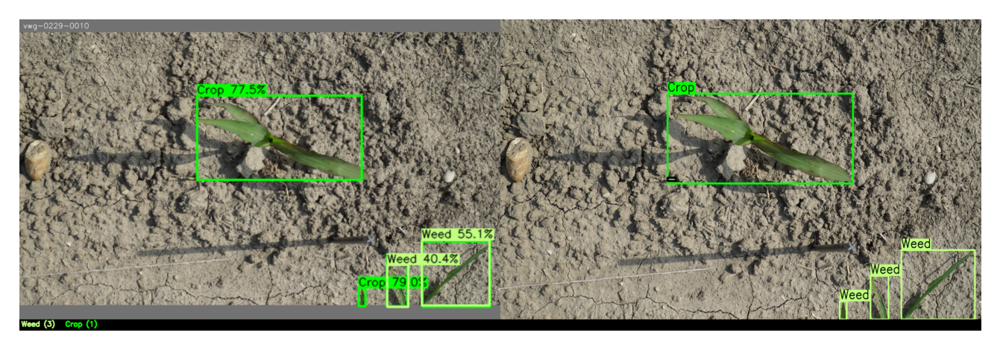

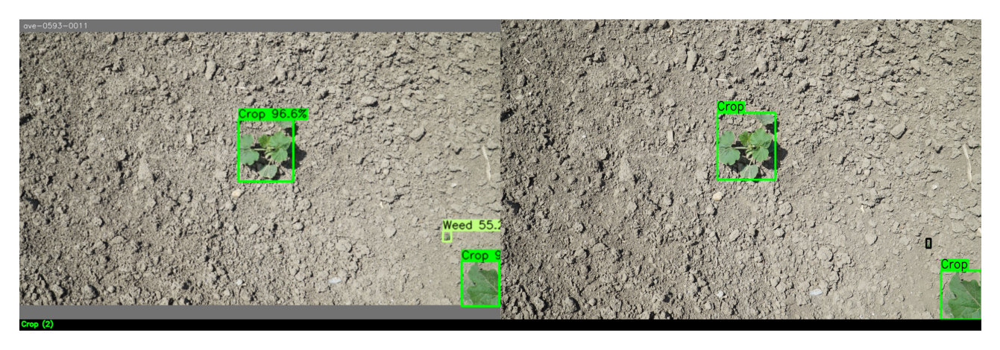

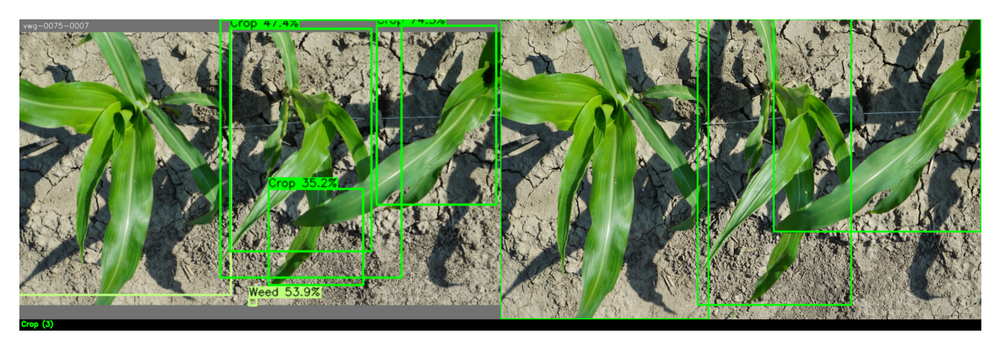

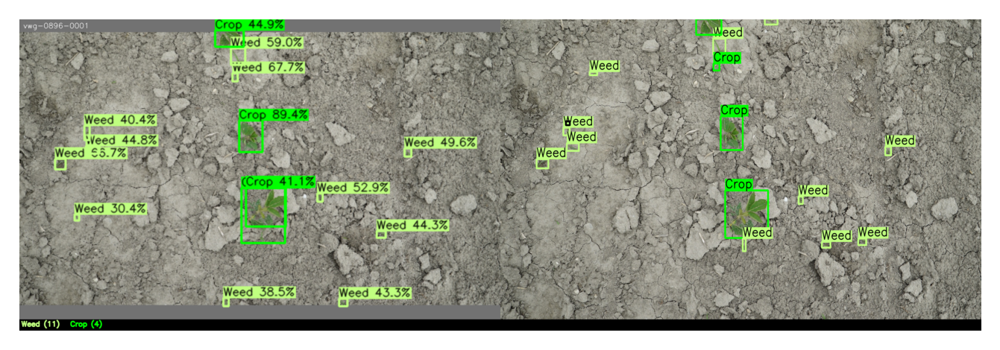

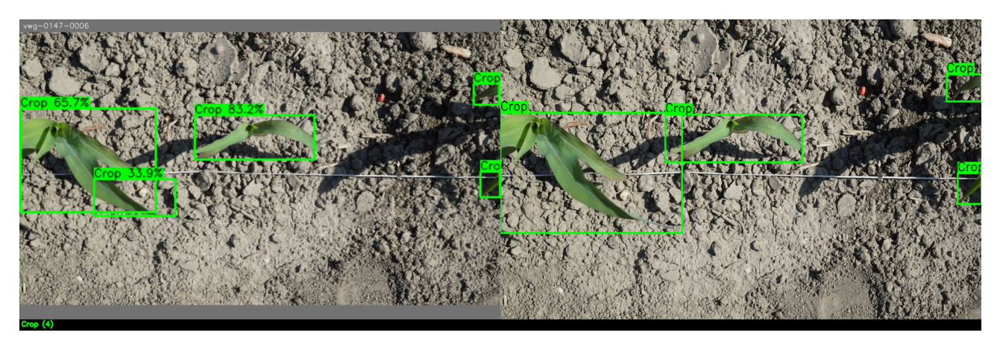

In [132]:
for img in image_files[::3]:
    plt.figure(dpi=260) # height might be limited by notebook width
    plt.imshow(img)
    plt.axis(False)
    plt.show()

pl_model.to("cpu")
torch.cuda.empty_cache()

# Hyperparameter Tuning <a id='hopt'></a>
[to the top](#top)  
[to the settings](#settings)  
[to training](#training) 

[trial settings](#hopt_settings)  
[run the optimization](#run_hopt)  



### Hyperparameter fixed presets

The constant parameters like dataset, image size will be copied from the general [settings](#settings)  above.
Only exception is max epoch that is set below.

In [358]:
# Copy Settings from above:
from copy import deepcopy
if model_params["name"] == "yolov7-tiny" and model_params["pretrained"]:
    print("yolov7-tiny cannot be pretrained. Setting pretrained=False")
    model_params["pretrained"] = False


study_settings = {
    "model" : model_params,
    "optimizer" : optimizer_params,
    "lr_scheduler" : lr_scheduler_params,
    'lr_onecycle'  : lr_onecycle_params,
    "loss" : loss_params,
    "dataset" : dataset_params,
    "mAP" : mean_avg_precision_settings, # unchanged use global ones
    "trainer" : None # This one will be adjusted below
}
study_settings = deepcopy(study_settings) # better overview this way


fixed_params = {
    "batch_size" : BATCH_SIZE,
    "base_momentum" : lr_onecycle_params["base_momentum"],
    "max_momentum"  : lr_onecycle_params["max_momentum"],
}

### Define hyperparameter space

Here the distributions from which the parameters are samples can be choosen in the dict `HS_SPACE`.

As this in this section the variables influencing the trials are set, the trials epochs are also defined here.

In [359]:
from collections import namedtuple

HParamInt   = namedtuple("HParamInt", "name, low, high, log, step", defaults={"log":False, 'step': 1}.values())
HParamFloat = namedtuple("HParamFloat", "name, low, high, log, step", defaults={"log":False, 'step': None}.values())


HP_SPACE = {#"learning_rate" : (1e-4, 5e-2),
            #"warmup_epochs" : (0, 2),
            #"warmup_multiplier" : [0.15, 5],
            # OneCycleLr parameters
            # see: https://pytorch.org/docs/stable/generated/torch.optim.lr_scheduler.OneCycleLR.html
            'learning_rate' : HParamFloat('learning_rate', 7.5e-3, 2e-1, log=True),
            'pct_start'     : HParamFloat('pct_start', 0.1, 0.5, step=0.01),       # length of warmup interval in terms of total steps
            'div_factor'    : HParamInt('div_factor', 10, 100, step=5),   # scaline 
            'final_div_factor' : HParamInt('final_div_factor', 100, 100_000, log=True)
             #'base_momentum' : HParamFloat(0.75, 0.85),
           }

def suggest_hparam(trial, param : Union[HParamInt, HParamFloat]):
    """Automatic wrapper to suggest Int or float parameters"""
    if isinstance(param, HParamInt):
        return trial.suggest_int(param.name, low=param.low, high=param.high, step=param.step, log=param.log)
    elif isinstance(param, HParamFloat):
        return trial.suggest_float(param.name, low=param.low, high=param.high, step=param.step, log=param.log)
    raise ValueError("Not an Int or Float parameter")

### Create edge cases for hyperparameters to assure good ones are inside

As it could be possible that the best parameters are not in the specified ranges but outside,
edgcase trials can be perfomed which will be defined here.
As they are likely bad they will be sheduled later so they are affected from pruning.
Some cases, concerning very low learning rates, are ommited because they will converge too slowly.

This section is split into two parts, first for a custom setup learning rate scheduler and secondly for the OneCycleLr scheduler.

In [360]:
if study_settings['optimizer']['lr_scheduler'].lower() != "onecyclelr":
    
    default_parameters =  None

    # see: https://github.com/WongKinYiu/yolov7/tree/711a16ba576319930ec59488c604f61afd532d5a/data
    recommended_parameters =  [
        # from hyperparameter tuning
    ]
    
    edgecase_trials = [
        # Min LR                                          # weak result
        #{"learning_rate" : HP_SPACE["learning_rate"][0],
        # "warmup_epochs" : 0,
        # "warmup_multiplier" : 1},
        # Max LR                                          # rather weak result
        {"learning_rate" : HP_SPACE["learning_rate"][1],
         "warmup_epochs" : 0,
         "warmup_multiplier" : 1},
        # Min LR + Low warmup -> even lower LR            # Stagnated
        {"learning_rate" : HP_SPACE["learning_rate"][0],
         "warmup_epochs" : 2,
         "warmup_multiplier" : HP_SPACE["warmup_multiplier"][1]},
        # Max LR + High warmup  -> even higher LR         # Explodes
        {"learning_rate" : HP_SPACE["learning_rate"][1],
         "warmup_epochs" : 2,
         "warmup_multiplier" : HP_SPACE["warmup_multiplier"][0]},
        # Max LR + High warmup  -> even higher LR         # Explodes
        {"learning_rate" : HP_SPACE["learning_rate"][1],
         "warmup_epochs" : 1,
         "warmup_multiplier" : HP_SPACE["warmup_multiplier"][0]},
        # Max LR + Low warmup 
        {"learning_rate" : HP_SPACE["learning_rate"][1],
         "warmup_epochs" : 2,
         "warmup_multiplier" : HP_SPACE["warmup_multiplier"][1]},
        # Min LR + High warmup
        {"learning_rate" : HP_SPACE["learning_rate"][0],
         "warmup_epochs" : 2,
         "warmup_multiplier" : HP_SPACE["warmup_multiplier"][0]},
        # Max LR + Low warmup 
        {"learning_rate" : HP_SPACE["learning_rate"][1],
         "warmup_epochs" : 1,
         "warmup_multiplier" : HP_SPACE["warmup_multiplier"][1]},
        # Min LR + High warmup
        {"learning_rate" : HP_SPACE["learning_rate"][0],
         "warmup_epochs" : 1,
         "warmup_multiplier" : HP_SPACE["warmup_multiplier"][0]},
    ]

In [361]:
if study_settings['optimizer']['lr_scheduler'].lower() == "onecyclelr":

    default_parameters : dict =  {
         'learning_rate' : 1e-2,
         'div_factor' : 25.,
         'final_div_factor' : 10_000.,
         'pct_start'  : 0.3,         # 3 epochs but on 50 total
        }

    recommended_parameters : List[dict] =  [
    # see: https://github.com/WongKinYiu/yolov7/tree/711a16ba576319930ec59488c604f61afd532d5a/data
        {
         'learning_rate' : 1e-2,
         'div_factor' : 10.,
         'final_div_factor' : 100,   # final learning rate 1e-2 / 100 = 1e-4
         'pct_start'  : 0.3,         # 3 epochs but on 50 total
        },
    # From experience
        {
         'learning_rate' : 2.5e-2,
         'div_factor' : 5.,
         'final_div_factor' : 500,   # final learning rate 1e-2 / 100 = 1e-4
         'pct_start'  : 0.25,         # 3 epochs but on 50 total
        },
        {
         'learning_rate' : 1e-1,
         'div_factor' : 100.,
         'final_div_factor' : 5000,   # final learning rate 1e-2 / 100 = 1e-4
         'pct_start'  : 0.4,         # 3 epochs but on 50 total
        },
    ]

   # Edgecases     
    edgecase_trials = [
        # Min LR, short warmup                             # too slow with 1e-3
        {'learning_rate'    : HP_SPACE['learning_rate'].low,
         'div_factor' : HP_SPACE["div_factor"].low, # using low division only, high division should be too low
         'pct_start'  : HP_SPACE["pct_start"].low,
         'final_div_factor' : 10_000 # default
        }, 
        
        # Max LR, long low warmup           # Good results
        {'learning_rate'     : HP_SPACE['learning_rate'].high,
         'div_factor' : HP_SPACE["div_factor"].high,
         'pct_start'  : HP_SPACE['pct_start'].high,
         'final_div_factor' : 10_000 # default
        },
        
        # MinLR, long warmup                                # tested is very bad, skipping
        #{'learning_rate'     : HP_SPACE['learning_rate'].low,
        # 'div_factor' : HP_SPACE["div_factor"].high, # using low division only, high division should be too low
        # 'pct_start'  : HP_SPACE['pct_start'].high,
        # 'final_div_factor' : 10_000 # default
        #},

        # Max LR, short high warmup                         # below average or explodes (
        {'learning_rate' : HP_SPACE['learning_rate'].high,
         'div_factor' : HP_SPACE["div_factor"].low,
         'pct_start'  : HP_SPACE['pct_start'].low,
         'final_div_factor' : 10_000 # default
        },

        # Max LR, short low warmup
        {'learning_rate'    : HP_SPACE['learning_rate'].high,
         'div_factor' : HP_SPACE["div_factor"].high,
         'pct_start'  : HP_SPACE['pct_start'].low,
         'final_div_factor' : 10_000 # default
        },

        # Max LR, long high warmup
        {'learning_rate'     : HP_SPACE['learning_rate'].high,
         'div_factor' : HP_SPACE["div_factor"].low,
         'pct_start'  : HP_SPACE['pct_start'].high,
         'final_div_factor' : 10_000 # default
        },    
    ]

### Trial Setup <a id='hopt_settings'></a>
[to the top](#top)  
[to the settings](#settings)  
[to training](#training)  
[to hyperparameter optimization](#hopt) 




For the hyperparameter tuning the [optuna](optuna.org) framework is used.
Its API is rather simple and wrappable with many other training frameworks.

**Sampling Stragegy**

For sampling the parameters the default [TPESampler](https://optuna.readthedocs.io/en/stable/reference/samplers/generated/optuna.samplers.TPESampler.html) was used.
As it is a random sampling strategy it is theoretically superior to grid based and pure random search methods.
In it standard form in assumes independent parameters, as this is not the case here, we use the multivariate implementation of it.
An alternative would also be a [CMA-ES](https://github.com/CyberAgentAILab/cmaes) sampler.
But as the training of the networks is quite expensive exhausting the search space would quite time consuming, the first mentioned tree based sampler is sufficient


**Pruning Strategy**

As training is expensive we want to stop bad trials as soon as possible.
The default settings for optuna is to use 5 complete trials for comparision but optimally we do not want to train bad models for such a long time.
The first improvement is not using startup trials but `n_min_trials` per step combined with early stopping.
We will combine this to prune and slowly increasing models via early stopping and evaluate better models with others that made it so far as well. 
This subtle difference allows to much quicker pruning of models.

Problemematic is that the first 4 epochs might not show clear tendencies, especially in our setup with a slowly increasing learning rate, so it is likely that the result might be biases against these.
To slightly improve the speed we could validate the models every 2 epochs


In [363]:
import optuna
print("optuna version", optuna.__version__)
from optuna.pruners import MedianPruner, PercentilePruner, PatientPruner
from optuna.samplers import PartialFixedSampler, TPESampler

os.makedirs(os.path.split(OPTUNA_DB_PATH)[0], exist_ok=True)
# Sorage, SQL databse
storage_url = f"sqlite:///"+OPTUNA_DB_PATH
study_name = "cyclelr_"+settings["model"]["name"]+"_"+DATASET+"_"+str(IMAGE_SIZE[0])+"px"

# DELETE STUDY, be careful when uncommenting, for example during debugging
#optuna.delete_study(study_name=study_name, storage=storage_url)

# Setup a storage to use heartbeat
# this can detect abnormally cancelled trials which are still logged as running
# trials shoudl report back in this timeframe
storage = optuna.storages.RDBStorage(url=storage_url,
                                    #heartbeat_interval=10*60, # 10min, 
                                    # grace_period=16*60 # 16 min, might increase for more complex models
                                    )
# Check validation every n epochs
# this will speed up the search
# Note that the Pruners are not aware of skipped steps!
TRIAL_VAL_CHECK_INTERVAL = 2

# If this is true, will log the validation data multiple times
# this is to make optuna semi aware that some skips were skipped
# Recommended to set this if for example trials with different steps are to be compared
# or so that the correct amount of epochs is logged.
CLONE_VAL_FOR_SKIPPED_EPOCHS = False

#-------
# Pruner
# n_startup_trials : amount of trials to be completed before prunning starts
# n_warmup_trials  : amount of epochs to be completed before a model can be pruned
# n_min_trials     : minimum result of trials at a step to decide if pruning is enabled

# Unused default pruner
#median_pruner = MedianPruner(n_startup_trials=5, 
#                             n_warmup_steps=4, 
#                             n_min_trials=1)

# Keep 40% of trials instead of 50
percentile_pruner = PercentilePruner(40., n_startup_trials=0, 
                                          n_warmup_steps=6 / TRIAL_VAL_CHECK_INTERVAL, # for example 4 / 2 are 4 epochs but 2 checks
                                          n_min_trials=4)


# Using patience because map can flucutate a bit over epochs
# prevent pruning of trials that look good at thes start but make one mistake
patient_percentile = PatientPruner(percentile_pruner, patience=2, min_delta=0.02) # at least increase by 2%


#-------
# Sampler
sampler = TPESampler(multivariate=True, # better capture covariances
                     constant_liar=False # running trials will be reported as bad, enable for distributed optimization to not sample similar cases.
                    )

#-------
# Create the study object
study = optuna.create_study(study_name=study_name, 
                            sampler=sampler,
                            storage=storage, 
                            direction="maximize", 
                            pruner=percentile_pruner,
                            load_if_exists=True) 

study.set_user_attr("dataset", DATASET)
study.set_user_attr("model", settings["model"]["name"])

# Adding non edgecases which likely could result in good performances
# edgcase trials could be very bad, should be tested after n_startup_trials
# so pruning them can happen

if default_parameters:
    study.enqueue_trial(default_parameters, skip_if_exists=True)
if recommended_parameters:
    for sample in recommended_parameters:
        study.enqueue_trial(sample, skip_if_exists=True)


/scratch/slurm_tmpdir/job_22001458/ipykernel_812383/573393514.py:51: ExperimentalWarning: PatientPruner is experimental (supported from v2.8.0). The interface can change in the future.
  patient_percentile = PatientPruner(percentile_pruner, patience=2, min_delta=0.02) # at least increase by 2%
[I 2023-04-10 17:02:14,269] Using an existing study with name 'cyclelr_yolov7-tiny_CropOrWeed2_640px' instead of creating a new one.
[I 2023-04-10 17:02:14,303] Trial with params {'learning_rate': 0.01, 'div_factor': 25.0, 'final_div_factor': 10000.0, 'pct_start': 0.3} already exists. Skipping enqueue.
[I 2023-04-10 17:02:14,312] Trial with params {'learning_rate': 0.01, 'div_factor': 10.0, 'final_div_factor': 100, 'pct_start': 0.3} already exists. Skipping enqueue.
[I 2023-04-10 17:02:14,322] Trial with params {'learning_rate': 0.025, 'div_factor': 5.0, 'final_div_factor': 500, 'pct_start': 0.25} already exists. Skipping enqueue.
[I 2023-04-10 17:02:14,332] Trial with params {'learning_rate': 0.

optuna version 3.1.1


In [364]:
TRIAL_EPOCHS = 20
assert TRIAL_EPOCHS % TRIAL_VAL_CHECK_INTERVAL == 0, "Trial does not end with a validation phase"

trial_trainer_settings = deepcopy(trainer_settings)
trial_trainer_settings["max_epochs"] = TRIAL_EPOCHS
study_settings["trainer"] = trial_trainer_settings

In [365]:
# View Past trials in that study
study.trials_dataframe()

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_div_factor,params_final_div_factor,params_learning_rate,params_pct_start,user_attrs_batch_size,user_attrs_dataset,user_attrs_end_epoch,user_attrs_image_size,user_attrs_max_epochs,user_attrs_model,user_attrs_optimizer,user_attrs_pretrained,system_attrs_fixed_params,state
0,0,4.644347e-01,2023-04-07 16:03:28.115442,2023-04-07 16:42:19.565665,0 days 00:38:51.450223,48,25,10000,0.010000,0.30,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,"{'learning_rate': 0.01, 'div_factor': 25.0, 'f...",COMPLETE
1,1,4.487731e-01,2023-04-07 16:42:19.603388,2023-04-07 17:24:53.986409,0 days 00:42:34.383021,48,10,100,0.010000,0.30,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,"{'learning_rate': 0.01, 'div_factor': 10.0, 'f...",COMPLETE
2,2,NaN,2023-04-07 17:24:54.020556,NaT,NaT,48,5,500,0.025000,0.25,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,"{'learning_rate': 0.025, 'div_factor': 5.0, 'f...",RUNNING
3,3,4.799040e-01,2023-04-07 17:53:05.367394,2023-04-07 18:33:13.752839,0 days 00:40:08.385445,48,5,500,0.025000,0.25,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,"{'learning_rate': 0.025, 'div_factor': 5.0, 'f...",COMPLETE
4,4,NaN,2023-04-07 18:33:13.793567,NaT,NaT,48,95,125,0.001607,0.12,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,RUNNING
5,5,NaN,2023-04-07 19:34:38.720920,NaT,NaT,48,85,46647,0.005782,0.32,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,RUNNING
6,6,3.908068e-01,2023-04-07 21:20:39.355954,2023-04-07 22:15:22.443500,0 days 00:54:43.087546,48,15,28318,0.004728,0.28,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,COMPLETE
7,7,4.652401e-01,2023-04-07 22:15:22.748446,2023-04-07 23:09:00.642317,0 days 00:53:37.893871,48,95,22781,0.012578,0.18,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,COMPLETE
8,8,3.181906e-02,2023-04-07 23:09:00.680444,2023-04-07 23:20:13.602055,0 days 00:11:12.921611,48,65,330,0.010388,0.16,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,PRUNED
9,9,4.219392e-01,2023-04-07 23:20:13.630698,2023-04-08 00:08:27.996094,0 days 00:48:14.365396,48,40,577,0.012629,0.15,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,PRUNED


#### Recover trials from other studies

The first cell is for debugging and shows how finished trials can be constructed from other data.

SideNote: How to continue a failed trial (e.g. when it was aborted by KeyboardInterrput)
https://optuna.readthedocs.io/en/latest/reference/generated/optuna.storages.RetryFailedTrialCallback.html

In [366]:
from copy import deepcopy
from optuna.trial import FrozenTrial, TrialState
from optuna.distributions import FloatDistribution, IntDistribution, CategoricalDistribution
import datetime
#past_trials=[FrozenTrial(number=0, values=[0.16265878081321716], datetime_start=datetime.datetime(2023, 3, 3, 22, 7, 37, 227788), datetime_complete=datetime.datetime(2023, 3, 3, 23, 5, 56, 152188), params={'learning_rate': 0.008672627867062672, 'warmup_epochs': 0, 'warmup_multiplier': 1, 'batch_size': 64}, distributions={'learning_rate': FloatDistribution(high=0.01, log=True, low=1e-05, step=None), 'warmup_epochs': IntDistribution(high=2, log=False, low=0, step=1), 'warmup_multiplier': IntDistribution(high=1, log=False, low=1, step=1), 'batch_size': IntDistribution(high=64, log=False, low=64, step=1)}, user_attrs={}, system_attrs={}, intermediate_values={0: 3.89165597880492e-06, 1: 0.0, 2: 0.027702704071998596, 3: 0.059126317501068115, 4: 0.07494954019784927, 5: 0.16265878081321716}, trial_id=0, state=TrialState.COMPLETE, value=None),
# FrozenTrial(number=1, values=[0.07315368205308914], datetime_start=datetime.datetime(2023, 3, 3, 23, 40, 39, 995823), datetime_complete=datetime.datetime(2023, 3, 4, 0, 58, 55, 348007), params={'learning_rate': 0.0019902638252712315, 'warmup_epochs': 0, 'warmup_multiplier': 1, 'batch_size': 64}, distributions={'learning_rate': FloatDistribution(high=0.01, log=True, low=1e-05, step=None), 'warmup_epochs': IntDistribution(high=2, log=False, low=0, step=1), 'warmup_multiplier': IntDistribution(high=1, log=False, low=1, step=1), 'batch_size': IntDistribution(high=64, log=False, low=64, step=1)}, user_attrs={}, system_attrs={}, intermediate_values={0: 0.0, 1: 1.2373078789096326e-05, 2: 1.0205122634943109e-05, 3: 0.016686318442225456, 4: 0.07189849764108658, 5: 0.07315368205308914}, trial_id=1, state=TrialState.COMPLETE, value=None),
# FrozenTrial(number=2, values=[0.0020408162381500006], datetime_start=datetime.datetime(2023, 3, 4, 9, 16, 9, 640196), datetime_complete=datetime.datetime(2023, 3, 4, 9, 34, 39, 995928), params={'learning_rate': 3.112747859456883e-05, 'warmup_epochs': 0, 'warmup_multiplier': 1, 'batch_size': 64}, distributions={'learning_rate': FloatDistribution(high=0.01, log=True, low=1e-05, step=None), 'warmup_epochs': IntDistribution(high=2, log=False, low=0, step=1), 'warmup_multiplier': CategoricalDistribution(choices=(1,)), 'batch_size': IntDistribution(high=64, log=False, low=64, step=1)}, user_attrs={}, system_attrs={}, intermediate_values={0: 0.0, 1: 0.0, 2: 0.05624999850988388, 3: 0.0011784511152654886, 4: 0.001612903201021254, 5: 0.0020408162381500006}, trial_id=2, state=TrialState.COMPLETE, value=None),]

This shows how the best parameters of a study can be loaded and incorporated into a new study.

#### Optuna+Lightning compatible pruner

The build in PyTorchLightningPruningCallback of optuna is currently not compatible with PyTorchLightning.
To avoid this version a equivalent class is declared to handle logging and pruning during training.

Code taken from: https://github.com/optuna/optuna-examples/issues/166#issuecomment-1403112861

In [367]:
from pytorch_lightning.callbacks import Callback
import optuna
print("Optuna Version", optuna.__version__)

# NOTE: The builtin is currently not compatible with pytorch-lightning
# you can try this version instead of the below declared class and test if it works 
from optuna.integration import PyTorchLightningPruningCallback as PruningCallback

class PyTorchLightningPruningCallback(Callback):
    """
    # Code taken from: https://github.com/optuna/optuna-examples/issues/166#issuecomment-1403112861
    
    PyTorch Lightning callback to prune unpromising trials.
    See `the example <https://github.com/optuna/optuna-examples/blob/
    main/pytorch/pytorch_lightning_simple.py>`__
    if you want to add a pruning callback which observes accuracy.
    Args:
        trial:
            A :class:`~optuna.trial.Trial` corresponding to the current evaluation of the
            objective function.
        monitor:
            An evaluation metric for pruning, e.g., ``val_loss`` or
            ``val_acc``. The metrics are obtained from the returned dictionaries from e.g.
            ``pytorch_lightning.LightningModule.training_step`` or
            ``pytorch_lightning.LightningModule.validation_epoch_end`` and the names thus depend on
            how this dictionary is formatted.
    """

    def __init__(self, trial: optuna.trial.Trial, monitor: str) -> None:
        super().__init__()

        self._trial = trial
        self.monitor = monitor

    def on_validation_end(self, trainer: Trainer, pl_module: pl.LightningModule) -> None:
        # When the trainer calls `on_validation_end` for sanity check,
        # do not call `trial.report` to avoid calling `trial.report` multiple times
        # at epoch 0. The related page is
        # https://github.com/PyTorchLightning/pytorch-lightning/issues/1391.
        if trainer.sanity_checking:
            return

        epoch = pl_module.current_epoch

        current_score = trainer.callback_metrics.get(self.monitor)
        if current_score is None:
            message = (
                "The metric '{}' is not in the evaluation logs for pruning. "
                "Please make sure you set the correct metric name.".format(self.monitor)
            )
            warnings.warn(message)
            return

        self._trial.report(current_score, step=epoch)
        print(format(epoch, ">3"), " : Validation mAP:", format(current_score, ".3f"))
        if self._trial.should_prune():
            message = "Trial was pruned at epoch {}.".format(epoch)
            raise optuna.TrialPruned(message)
        
        # log the same value again if the next validation phase is skipped
        # This will not trigger pruning
        if CLONE_VAL_FOR_SKIPPED_EPOCHS:
            for i in range(TRIAL_VAL_CHECK_INTERVAL - 1):
                self._trial.report(current_score, step=epoch+i) 

Optuna Version 3.1.1


#### Declaring of the objective function

We will wrap the training process in a function.
Within the hyperparamters will be sampled and some side information like batch size annotated which are constant.

Open to discussion is if the same random seed should be used for every trial.
It makes the trials equivalent and comparable but it also strongly adds a bias to the validation data and might in the end decrease the generalization performance.
Optimally nested cross validation has to be performed, but also cross validation will be expensive for these models.
On the other hand neuronal networks benefit from their non-identifiability, meaning there can be many parameters and optimas  But this only slighly milders this bias.
We will slighly validate the best parameters under a different seed afterwards.

In [368]:

def objective(trial):
    torch.cuda.empty_cache
    pl.seed_everything(SEED)
    #opt_type = trial.suggest_categorical("optimizer", ["SGD", "Adam", "RAdam"])
    
    trial_settings = deepcopy(study_settings)    
    #trial_settings["model"]["pretrained"] = trial.suggest_bool("pretrained") #using tiny # pretrained is always better
    batch_size = trial.suggest_int("batch_size", BATCH_SIZE, BATCH_SIZE)      #fixing this
    
    # Hyperparameters
    trial_settings["optimizer"]["learning_rate"] = suggest_hparam(trial, HP_SPACE["learning_rate"])
    trial_settings["lr_onecycle"]['div_factor'] = suggest_hparam(trial, HP_SPACE["div_factor"])
    trial_settings["lr_onecycle"]['final_div_factor'] = suggest_hparam(trial, HP_SPACE["final_div_factor"])
    trial_settings["lr_onecycle"]['pct_start'] = suggest_hparam(trial, HP_SPACE["pct_start"])
    
    # Constants
    trial_settings["trainer"]["max_epochs"] = TRIAL_EPOCHS
    
    trial.set_user_attr("model",      trial_settings["model"]["name"])
    trial.set_user_attr("pretrained", trial_settings["model"]["pretrained"])
    trial.set_user_attr("dataset",    trial_settings["dataset"]["name"])
        
    trial.set_user_attr("optimizer", trial_settings["optimizer"]["name"])
    trial.set_user_attr("image_size", IMAGE_SIZE)
    trial.set_user_attr("batch_size", BATCH_SIZE)
    trial.set_user_attr("max_epochs", TRIAL_EPOCHS) # important for cosine annealing
    
    ######## Callbacks

    lr_monitor = pl.callbacks.LearningRateMonitor(logging_interval='epoch')

    tensor_logger = pl.loggers.TensorBoardLogger("./lightning_logs/"+DATASET, 
                      name=f"Trial-{trial_settings['model']['name']}_"+str(IMAGE_SIZE[0])+"px_"
                           f"lr={trial_settings['optimizer']['learning_rate']:.2g}"  
                          # f"warmup=({trial_settings['lr_scheduler']['warmup_epochs']},{trial_settings['lr_scheduler']['warmup_multiplier']:.2g})",
                           f"cycle({trial_settings['lr_onecycle']['div_factor']}, {trial_settings['lr_onecycle']['final_div_factor']}, {trial_settings['lr_onecycle']['div_factor']}, {trial_settings['lr_onecycle']['pct_start']:.2f})",
                     default_hp_metric=True)

    #fit_csv_logger = pl.loggers.CSVLogger("./lightning_logs", name='dev_fit', version=None, prefix='', flush_logs_every_n_steps=100)

    early_stop_callback = EarlyStopping(monitor="map", 
                                    min_delta=0.01, 
                                    patience=4 // TRIAL_VAL_CHECK_INTERVAL, # 3 is a good value but better 2 with trial_val_check
                                    verbose=True, 
                                    stopping_threshold=0.008, # prune very low after min epochs are over
                                    mode="max")
    
    trainer = Trainer(  
        max_epochs=trial_settings["trainer"]["max_epochs"],
        min_epochs=2,# prevent early stopping at epoch 1
        #max_steps=7000,
        accelerator="auto",
        devices=1 if torch.cuda.is_available() else "auto", 
        callbacks=[lr_monitor, 
                   PyTorchLightningPruningCallback(trial, monitor="map"), 
                   early_stop_callback],
        logger=[tensor_logger], # add fit_logger
        
        fast_dev_run=False,
        num_sanity_val_steps=0,
        
        check_val_every_n_epoch=TRIAL_VAL_CHECK_INTERVAL, # speed up training, note optuna is not aware of these skipped checks!
        strategy=trial_trainer_settings["strategy"]
    )
    data = CropAndWeedDataModule(DATASET, DATA_PATH, batch_size=batch_size, 
                                      num_workers=NUM_WORKERS, 
                                      train_transform=augmentation_pipeline,
                                      test_transform=no_transform,
                                      stack2_images=True)
    
    print("lr", trial_settings["optimizer"]["learning_rate"], trial_settings['lr_onecycle']['div_factor'])
    model = YOLO_PL(trial_settings)
    try:
        trainer.fit(model, data)
    except Exception as e:
        print(e)
        raise
    finally:
        trial.set_user_attr("end_epoch", trainer.current_epoch)
        
    return trainer.callback_metrics["map"].item()


### Perform Hyperparameter optimization <a id='run_hopt'></a>
[to the top](#top)  
[to the settings](#settings)  
[to training](#training)  
[to hyperparameter optimization](#hopt) 

In [ ]:
torch.cuda.empty_cache()
study.enqueue_trial(sample, skip_if_exists=False)
print(sample)
study.optimize(objective, n_trials=5)  # Invoke optimization of the objective function.


#### Add edgecase trials to the study

As described the optimal hyperparameters could lie outside of the given ranges, testing these are therefore important.
And should be done quite early, this will help the sampler to avoid these or the trial can be redone with and update range should some edgecase trials perform very well or even yield the best results.
Depending on the optuna setup one should make sure that these trials are pruned likeby `n_min_trials` that were performed beforehand.

In [ ]:
for sample in edgecase_trials:
    study.enqueue_trial(sample, skip_if_exists=True)
display(study.trials_dataframe())
study.optimize(objective, n_trials=len(edgecase_trials)+10) # Perform the edcasetrials and additional ones

### Hyperparametertuning Evaluation

#### Options for visualization

Below we will use some of in optuna integrated visualization tools to analyse the performance of the model.
Alternatives are the optuna-dashboard and tensorboard.
Tensorboards some of the tensorboard functions overlapp with optunas, while it lacks some tools it is easier to filter and track individual models. Also it is more efficient and can be used in parallel in real time.
optuna-dashboard is often the better choice but the current version does not work for me and fails with a JavaScript error when opening a trial.

#### Visualizations

In [369]:
study.trials_dataframe()

,number,value,datetime_start,datetime_complete,duration,params_batch_size,params_div_factor,params_final_div_factor,params_learning_rate,params_pct_start,user_attrs_batch_size,user_attrs_dataset,user_attrs_end_epoch,user_attrs_image_size,user_attrs_max_epochs,user_attrs_model,user_attrs_optimizer,user_attrs_pretrained,system_attrs_fixed_params,state
0,0,4.644347e-01,2023-04-07 16:03:28.115442,2023-04-07 16:42:19.565665,0 days 00:38:51.450223,48,25,10000,0.010000,0.30,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,"{'learning_rate': 0.01, 'div_factor': 25.0, 'f...",COMPLETE
1,1,4.487731e-01,2023-04-07 16:42:19.603388,2023-04-07 17:24:53.986409,0 days 00:42:34.383021,48,10,100,0.010000,0.30,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,"{'learning_rate': 0.01, 'div_factor': 10.0, 'f...",COMPLETE
2,2,NaN,2023-04-07 17:24:54.020556,NaT,NaT,48,5,500,0.025000,0.25,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,"{'learning_rate': 0.025, 'div_factor': 5.0, 'f...",RUNNING
3,3,4.799040e-01,2023-04-07 17:53:05.367394,2023-04-07 18:33:13.752839,0 days 00:40:08.385445,48,5,500,0.025000,0.25,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,"{'learning_rate': 0.025, 'div_factor': 5.0, 'f...",COMPLETE
4,4,NaN,2023-04-07 18:33:13.793567,NaT,NaT,48,95,125,0.001607,0.12,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,RUNNING
5,5,NaN,2023-04-07 19:34:38.720920,NaT,NaT,48,85,46647,0.005782,0.32,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,RUNNING
6,6,3.908068e-01,2023-04-07 21:20:39.355954,2023-04-07 22:15:22.443500,0 days 00:54:43.087546,48,15,28318,0.004728,0.28,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,COMPLETE
7,7,4.652401e-01,2023-04-07 22:15:22.748446,2023-04-07 23:09:00.642317,0 days 00:53:37.893871,48,95,22781,0.012578,0.18,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,COMPLETE
8,8,3.181906e-02,2023-04-07 23:09:00.680444,2023-04-07 23:20:13.602055,0 days 00:11:12.921611,48,65,330,0.010388,0.16,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,PRUNED
9,9,4.219392e-01,2023-04-07 23:20:13.630698,2023-04-08 00:08:27.996094,0 days 00:48:14.365396,48,40,577,0.012629,0.15,48,CropOrWeed2,NaN,"[640, 640]",20,yolov7-tiny,SGD,False,NaN,PRUNED


In [370]:
import plotly
from optuna import visualization as ov
from optuna.visualization import plot_optimization_history
from optuna.visualization import plot_contour
from optuna.visualization import plot_edf
from optuna.visualization import plot_intermediate_values
from optuna.visualization import plot_optimization_history
from optuna.visualization import plot_parallel_coordinate
from optuna.visualization import plot_param_importances
from optuna.visualization import plot_slice

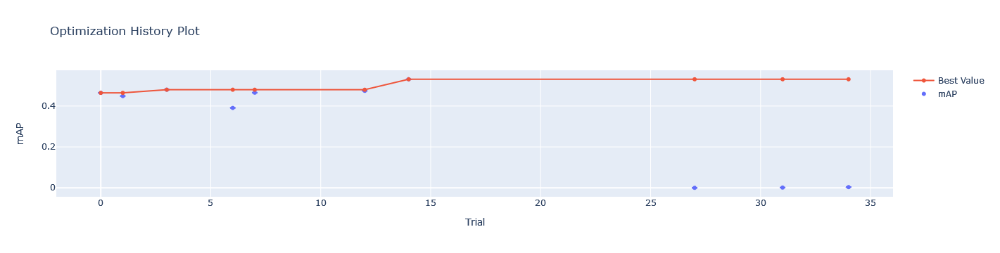

In [371]:
optuna.visualization.plot_optimization_history(study,  target_name='mAP', error_bar=True)

**Parallel coordinate plots for coorrelations accross multiple variables**

Parallel coordinate plots can be used to explore correlations between attributes, but need some understanding of the technique.
Reranging the columns to maximize parallelism is a good way to make these plots interpretable.
Note that here the bad results are not really visible, due to the white on white plotting.

We can draw two important informations out of here, good results are achieved with low learning rates and a low div_factor or high learning rates with a higher div factor.
Or in short a high initial learning rate yields good results.
The best result comes also from a long warmup phase.


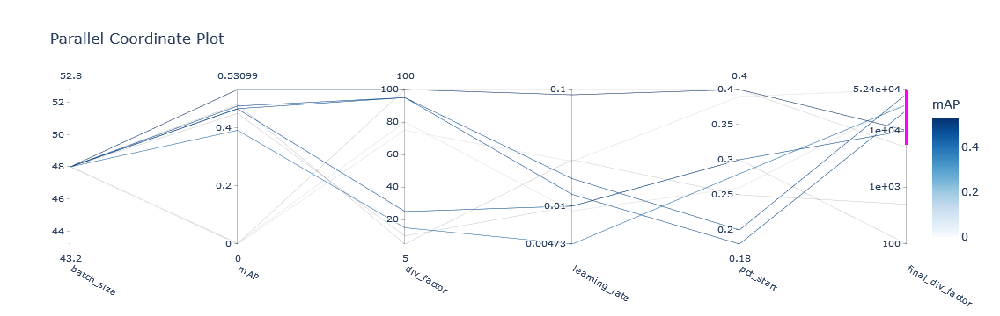

In [372]:
plot_parallel_coordinate(study, target_name="mAP")

**Slice Plot**  
Note that in the slice plot the coloring is the trial number, one should expect that with
darker color better results are achieved as the sampler learns these.
Here some of the the latest trials are the manually added were the edcase trials that performed very badly.
As described in the comments some edge cases where omitted. The trial for the lowest div_factor and failed therefore it is not displayed here.
Edgecases of the final_div_factor where not performed.

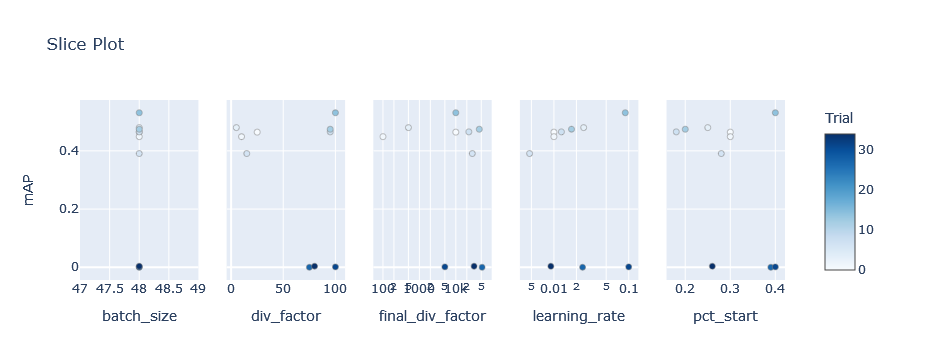

In [373]:

plot_slice(study, target_name="mAP")

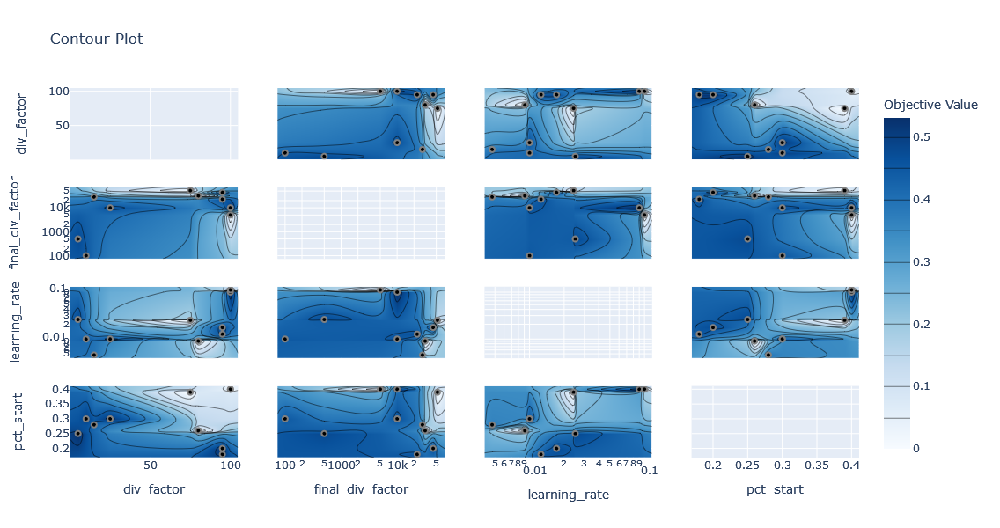

In [380]:
fig = plot_contour(study, params=["learning_rate", "pct_start", "div_factor", "final_div_factor"])
fig.update_layout(
    autosize=False,
    width=800,
    height=600,)
fig.show()

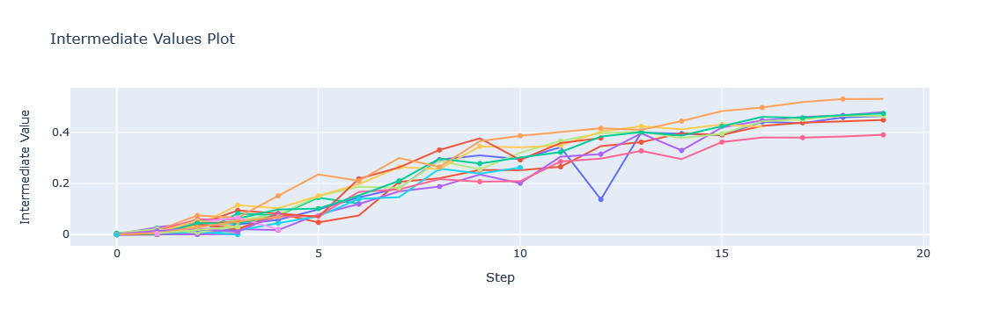

In [375]:
plot_intermediate_values(study)

**Parameter importance**

A point that was missed in the parallel coordinate plot but revealed here is that the final_div_factor can be quite important.
All models with a high final_div_factor and thereby very low learning rate at the end performed very badly.
But as these trials were relatively short it is likely that the models were still in an early phase were they beneffited from a high learning_rate and did not reach a phase where finetuning with a low learning rate can help to converge to narrow optimas.


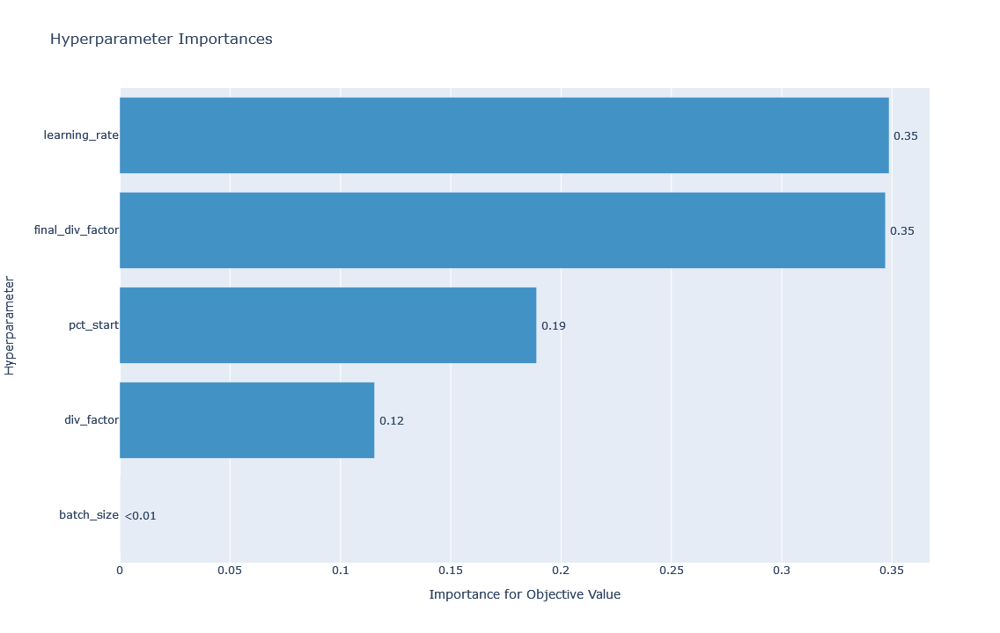

In [381]:
plot_param_importances(study)

## Train the best model - Validation <a id="hopt:validation">

[to the top](#top)  
[to the settings](#settings)  
[to training](#training)  
[to hyperparameter optimization](#hopt)
    
For validation we can now retrain the model with the best parameters and also check if they are also valid for other model architectures or the finer grained dataset variants.

In [ ]:
The end result had a validation mAP of 51.9%
as expected it is slightly lower


#### Apply same parameters on to different dataset

Going further we can test how will these parameters perform on different datasets, architectures and similar.


In [ ]:
retrain_best_params(study, {"dataset" : {"name" : "CropsOrWeed9"}})

In [ ]:
retrain_best_params(study, {"dataset" : {"name" : "CropsOrWeed9"}})

# Going Deeper - High resolution, larger architectures

[to the top](#top)

### Memory Limitations

Training the YOLO models needs a larger amount of memory, from the experiences made here at least 8GB of VRAM are necessary (with some tweaks) for the smallest model. With 32 GB VRAM and a professional GPU results can be optained in a resonable time.
Increasing the model architecture brings some challenges one of the main limitations is memory.
On the RTX 6000 with 48 GB VRAM training the YOLOv7-W6 (1280x1280 pixel), which is the smallest higher resolution model, only allows for a batch size of 8 images.
Not only is trhe training slow it also does not produce optimal results within 50 epochs (without batch accumulation).
With 32 GB VRAM training is not even possible at all with the normal setup.

### Half precision, caveats and offloading

A straight forward idea is to use multiple GPUs, but we will not pursue this idea here and try to optimize the training on one GPU.
The first solution is using half precision, which reduces the used memory by a good margin.
For images and convolutions half precision also increases their speed, and especially for the input images we can imagine that we do not need loose any information when we drop half the bits.
But half precision brings its own problems, as the name indicates we loose precision which can be problematic when adding many small values like probabilities.
The worst case happens when with these numerical instabilities the loss diverges or gets reduced to 0.
A inbetween step is using [mixed precision](https://lightning.ai/docs/pytorch/stable/common/precision_intermediate.html) that does not use half precision everwhere.
Still the problem of diverging loss persists.
[PyTorch Lightnin alone or in combination with DeepSpeed](https://lightning.ai/docs/pytorch/stable/advanced/model_parallel.html#deepspeed-zero-stage-2-offload) can further milden this problem by scaling the loss.
Applying the DeepSpeed strategies can minimize the memory problem even further by a large margin.
For example it allows to offload gradients, which are responsible for a large portion of the needed memory, and gradient computation to the system memory and CPU.

As these strategies cannot be run in interactive python like jupyter-notebooks, the code must be ported to standard python.py files and run for example via the CLI and are therefore not shown here anymore.
The code used in them is the most up to date and a bit more sophisticated.
Still the full potential of DeepSpeed was not persued as this was not necessary.

### Short overview of performance gains

Using the yolov7-tiny version the training time is roughly halfed and training with a batch size of 64 was possible.

Where before the training with 1280x1280 pixels with the w6 version took about 20 minutes with only 8 batches, 
now 24 could be used and in some situations the training time for one epoch took only about 5 minutes (on the RTX 6000).


### Evaluation of the larger architectures



They are good!

# Discussion, summary, conclusion <a id="end:discussion"></a>

**Multiclass performs better than binary classification**



**Potential bias to small and large bounding boxes**

The next graphic displayes the size distribution of the bounding box for the different classes.
There is a bias for large instances to be crops and for smaller ones to be weeds, potentially the model could learn a shortcut to assign the weed class to these smaller instances.
I am not sure if the YOLO model can be affected by this or not.
A way to compensate for this is a stronger cropping augmentation.
In this case to lose less positive information the cropping was restrained to not not lose bounding boxes ([RandomSizedBBoxSafeCrop](https://albumentations.ai/docs/api_reference/augmentations/crops/transforms/#albumentations.augmentations.crops.transforms.RandomSizedBBoxSafeCrop)) therefore the zooming factor was quite minimal.
A change in the augmentation pipeline can address this.

<p style="text-align: center;"><img src="research/size-distribution.png" width="960"><br>
Distribution of crop and weed classes and their normalized sizes.
The darker the color the bigger larger the area.<br>
Range: Large > 128² > Medium > 32² > Small > 16² > Tiny.
Image extracted from [Steininger et al., 2023].
.</p>




## Future steps and further readings

**True negative samples**

The dataset contains about 3% of samples without bounding boxes, but as two images are stacked the chance for no instances is very very low.
In the `Dataset` it should be taken care about this that when selecting a negative sample another negative sample is chosen, or just padding is used without stacking.
But this could potentially lead the network to predict no bounding boxes when it predicts a large amount of padding color, so stacking the instance with itself is the best choice without keeping a record of all the negative sample images.

**Normalization on pretrained models**

It was stated that normalized images do poorly which is the reason why it was not further used.
For support a quick research also yieleded that at least for yolov3 there is no normalization[[https://github.com/ultralytics/yolov3/issues/241]](https://github.com/ultralytics/yolov3/issues/241).
Still this statement is not true or rather it has not been evaluated correctly.
While it is true that the mean average precision is bad, it is only bad because the validation dataset was not augmented as well, so the model did not learn how the predict from normal looking images. This step has to be added in all the augmentation pipelines.
Looking at the train loss of these few trained models they comparably good.

Further research and testing is required here to evaluate if and to which degree normalization hinders or benefits the training.
It has to be checked if there is a difference between the normalization values based on ImageNet or the ones extracted from the dataset, as they differ significantly.
Secondly as the experiments were performed with the tiny version where no pretrained weights where availiable, it has also to be checked if the pretrained models behave differently in this regard.

**Mixup and further augmentation**

TODO

And augmentation in general

**Adjustment of anchors**  <a id="future:anchor-adjustment"></a>

One of the core ideas of YOLO is to use anchors and anchored bounding boxes around them.
The size and range of them is predefined but can be adjusted.
This dataset has many smaller and more medium sized bounding boxes, this is and inductive bias we can incorporate into the model to increase its performance.
Necessary code can be found in the used YOLOv7 package used for training or here: [yolov7/anchors](https://github.com/Chris-hughes10/Yolov7-training/blob/d2c887123336a2b838d7bec13d6533dd7ce95c45/yolov7/anchors.py).

This aspect was not yet further discussed but it was implemented for the deeper networks even without retraining adjusting the anchors increased the mAP by a significant amount of 5-10%.
Further research has to be done why this is the case.
A possible reason it that because the data contains many small instances these can be better detected with the updated anchors.
As well the ability to transfer the models with the updated anchors to images where the instances are larger.

Another potential method that might maybe is less biased towards the training set anchors could be to learn the anchors dynamically[[Yang, T. et al.]](https://arxiv.org/abs/1807.00980)

**Evaluation Datasets and evaluation of tiny instances**

The dataset contains subdatasets especially for evaluation where an extra class for unclassified or very small vegetation instances exists.
From some of the visualization results we can see that the model is able to detect these instances, while the classification will be wrong it will still give an improvement in the bounding box precision.
The current evaluation results still do not reveal the full potential of the model.

This implementation was pursed in the beginning but failed because of errors.
The remnant is the `use_extra_class` in the settings, which also allows the model the predict vegetation.
Out of priority this was then not further pursed.

**Deployment considerations**

1) Reparametrization

Not only do YOLO models come in different sizes, there are also reparametrized versions to further increase the speed during deployment.
These will yield the same prediction but have fewer parameters and are faster during inference time.
One can look up the neccessary steps by the original creators here: https://github.com/WongKinYiu/yolov7/blob/main/tools/reparameterization.ipynb.

2) Deployment Frameworks

PyTorch is a relative slow environment. Quite some features are not needed during inference.
Ports to [TensorRT](https://developer.nvidia.com/tensorrt)(GPU), [NeuralMagix](https://docs.ultralytics.com/yolov5/neural_magic/)(YOLOv5 or 8) to speed up the models or [ONNX](https://de.wikipedia.org/wiki/ONNX), which can also be used on CPU and thereby smaller devices is necessary for a successful and efficient practical application.

**Extending the Model**

The dataset also contains side information about the soil (moisture and granularity).
An additional detection can be easily attached to predict this information as well.
It has to be tested how this impacts the training
Similarily it could be extended to deliver more information about the plants from one which could gain further insights.
For example it could be trained to detect dry or infected crops.
Without much effort the size of detected crops could be compared to detect outliers in their sizes.

In deployment the input would come from a video stream and we want to perform real time actions like precision spraying it must somehow kept track which plants were already sprayed to keep overlaps low.
This might be doable with classic object tracking techniques but maybe some short term memory instance recognition can be incorporated into or around the model to not rely on object movement but to explicit recognition of seen instances.

Important for validation it must be checked if the sprayed jet has hit the actual target or if something is wrong with the machinery.
This does not have to be done with the same model but has to be considered  to achieve the set goals in precision agriculture.

**Comparison with other architectures**

While this was originally planned but in the end too time consuming to implement.
Not only is restructuring of the code necessary, some libraries are currently not compatible to match with the existing setup.
For a valid comparison tuning the other models would have also been necessary.

Interesting models to look at would be [Faster R-CNN](https://arxiv.org/abs/1506.01497) as a classical baseline likewise [RetinaNet](https://paperswithcode.com/paper/focal-loss-for-dense-object-detection) or [DETR(2020)](https://arxiv.org/abs/2005.12872) that features a new interpretation of the bounding box problematic.
Likewise the new successor YOLOv8.

**State of the art techniques and frameworks**

The special design from the chosen dataset made it necessary to write custom scripts so it can be used and evaluated.
To better understand the concept behind the YOLO models and to have more control of nearly every aspect the custom, non official implementation was chosen here.
It was tried to incorporate [YOLOv8](https://github.com/ultralytics/ultralytics) from [Ultralytics](https://ultralytics.com/) which is also the company behind the successful YOLOv5 version.
But the YOLOv8 model is much more nested into into its training framework which made the attempts to extract it and run with the custom dataloader and Pytorch Lightning much harder.
YOLOv8 however brings many benefits that are more convenient.
Foremost the frameworks and pipelines around it to annotate data and training it online.
Out of copyright and license concerns it was decided to not use these online services with the chosen dataset but YOLOv8 is likely the next big step in training and deploying high perfomant single shot models.



## Appendix

### Hardware used

Different hardwares that were used and a quick overview of some runtimes:

* dws-student-01  server  
    1x NVIDIA RTX A6000 (48GB VRAM)  
    8-20 cores
    used RAM not checked
    fastest runtime 1 epoch of the tiny version, half precision: < 2min
    
* BwUniCluster2.0  
    1x NVIDIA Tesla V100 (36GB VRAM)  
    8-10 or 20 x Intel Xeon Gold 6230 and/or  Xeon Gold 6248  
    40-90 GB RAM some trials with 360 GB RAM to store the whole dataset, but did not bring a significant speed up)
    fastest runtime 1 epoch of the tiny version, half precision: ~2min

for comparision a home system

* 1x NVIDIA GTX 980 (4GB VRAM)
    2 x cores Intel i5-3450  
    8 GB RAM
    fastest runtime 1 epoch of the tiny version, batch size: 8: 30-50 min
    
---

For the d6 and e6 versions and w6 with large batch sizes:
   
   * 1x NVIDIA A100 or H100  
    10-20 cores: Intel Xeon Platinum 8358  
    90-180 GB RAM (40-120 were mostly sufficient)  
    runtimes for 1 epoch < 20 min.

### Additional References

Derivation of moving standard deviation from batches
@MISC {2971563,
    TITLE = {How do I combine standard deviations of two groups?},
    AUTHOR = {heropup (https://math.stackexchange.com/users/118193/heropup)},
    HOWPUBLISHED = {Mathematics Stack Exchange},
    NOTE = {URL:https://math.stackexchange.com/q/2971563 (version: 2018-10-26)},
    EPRINT = {https://math.stackexchange.com/q/2971563},
    URL = {https://math.stackexchange.com/q/2971563}
}

